### IMPORTACIÓN LIBRERÍAS

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.model_selection import train_test_split
import sklearn.linear_model as lm
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from joblib import Parallel, delayed, cpu_count
from sklearn.model_selection import RepeatedKFold
from sklearn.inspection import permutation_importance
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix, accuracy_score
from itertools import product
import tensorflow as tf
import os
from skimage import io
from skimage.transform import resize
from sklearn.model_selection import train_test_split
from os import path
import cv2
import keras
import random
import glob
import shutil
import nibabel as nib
from keras.utils import to_categorical
from sklearn.model_selection import train_test_split
import re
from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, Conv2DTranspose, BatchNormalization, Dropout, Lambda
from keras.utils import normalize
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from keras.utils import to_categorical
from sklearn.utils.class_weight import compute_class_weight
from keras.metrics import MeanIoU
import matplotlib.pyplot as plt
import ipywidgets as widgets
from sklearn.utils import class_weight
from tensorflow.keras.models import load_model
from collections import defaultdict
from tensorflow.keras.optimizers import Adam
from matplotlib.colors import ListedColormap
from keras.callbacks import CSVLogger
import keras.backend as K
from tensorflow.keras.layers import *
from tensorflow.keras.models import *
import pandas as pd
import matplotlib.colors as mcolors
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, confusion_matrix

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%cd /content/drive/MyDrive/Tfg24DDcardio

/content/drive/.shortcut-targets-by-id/1eS3VrSfNkwHDfe6zWqhlTXL3RfvO94w1/Tfg24DDcardio


### LECTURA BBDD

In [ ]:
patients_df = pd.read_csv('data/clean150data_tfg.csv',sep=";")

In [ ]:
patients_df

,Case,Sex,Age,Tobacco,Overweight,Arterial hypertension,Diabetes,Familial history of CAD,ECG (ST +),Troponin (mg/mL),Killip Max,LVEF (%),NTProBNP (pg/mL),Myocardial area (cm3),Infarct area (cm3),PMO area (cm3)
0,P001,M,32,1,N,N,N,N,Y,130,1,35,447,"200,3662109","103,4667969","36,74316406"
1,P002,M,57,1,Y,N,N,N,Y,28,1,61,192,"167,9187622","37,72167969","10,33380127"
2,P003,M,67,2,N,N,N,N,Y,7,1,55,54,"78,83261719","8,020898438","0,616992188"
3,P004,M,68,2,Y,N,N,N,Y,45,2,40,1075,"126,5091064","28,69013672",0
4,P005,M,62,1,Y,Y,Y,Y,N,7,1,55,1024,"96,04486084","13,24224854","1,894897461"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,P146,F,77,3,N,Y,N,N,N,32,2,55,2394,"119,28739","7,27539",0
146,P147,M,68,2,N,N,N,N,Y,200,1,45,132,"193,4055","28,2005",0
147,P148,M,68,2,Y,Y,N,Y,Y,26,1,30,6462,"143,0018","34,6658",0
148,N149,F,85,3,Y,Y,N,N,N,20,1,35,781,"93,1298",0,0


### VISUALIZACIÓN DE LOS DATOS

In [ ]:
patients_df.columns

Index(['Case', 'Sex', 'Age', 'Tobacco', 'Overweight', 'Arterial hypertension',
       'Diabetes', 'Familial history of CAD', 'ECG (ST +)', 'Troponin (mg/mL)',
       'Killip Max', 'LVEF (%)', 'NTProBNP (pg/mL)', 'Myocardial area (cm3)',
       'Infarct area (cm3)', 'PMO area (cm3)'],
      dtype='object')

In [ ]:
patients_df.dtypes

Case                       object
Sex                        object
Age                         int64
Tobacco                     int64
Overweight                 object
Arterial hypertension      object
Diabetes                   object
Familial history of CAD    object
ECG (ST +)                 object
Troponin (mg/mL)           object
Killip Max                  int64
LVEF (%)                    int64
NTProBNP (pg/mL)            int64
Myocardial area (cm3)      object
Infarct area (cm3)         object
PMO area (cm3)             object
dtype: object

In [ ]:
patients_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 16 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   Case                     150 non-null    object
 1   Sex                      150 non-null    object
 2   Age                      150 non-null    int64 
 3   Tobacco                  150 non-null    int64 
 4   Overweight               150 non-null    object
 5   Arterial hypertension    150 non-null    object
 6   Diabetes                 150 non-null    object
 7   Familial history of CAD  150 non-null    object
 8   ECG (ST +)               150 non-null    object
 9   Troponin (mg/mL)         150 non-null    object
 10  Killip Max               150 non-null    int64 
 11  LVEF (%)                 150 non-null    int64 
 12  NTProBNP (pg/mL)         150 non-null    int64 
 13  Myocardial area (cm3)    150 non-null    object
 14  Infarct area (cm3)       150 non-null    o

In [ ]:
contador_na = patients_df.isna().sum().sum()

print("Número de valores NaN en el conjunto de datos:", contador_na)

Número de valores NaN en el conjunto de datos: 0


In [ ]:
patients_df.shape

(150, 16)

### PREPROCESAMIENTO Y ANÁLISIS DE LOS DATOS

#### Ajustar tipos de variables

In [ ]:
patients_df['Myocardial area (cm3)'] = patients_df['Myocardial area (cm3)'].str.replace(',', '.')
patients_df['Myocardial area (cm3)'] = patients_df['Myocardial area (cm3)'].astype(float)

patients_df['Infarct area (cm3)'] = patients_df['Infarct area (cm3)'].str.replace(',', '.')
patients_df['Infarct area (cm3)'] = patients_df['Infarct area (cm3)'].astype(float)

patients_df['PMO area (cm3)'] = patients_df['PMO area (cm3)'].str.replace(',', '.')
patients_df['PMO area (cm3)'] = patients_df['PMO area (cm3)'].astype(float)

patients_df['Troponin (mg/mL)'] = patients_df['Troponin (mg/mL)'].str.replace(',', '.')
patients_df['Troponin (mg/mL)'] = patients_df['Troponin (mg/mL)'].astype(float)

#### Eliminar variables categóricas

In [ ]:
patients_df_cop=patients_df.copy()
patients_df_cop

,Case,Sex,Age,Tobacco,Overweight,Arterial hypertension,Diabetes,Familial history of CAD,ECG (ST +),Troponin (mg/mL),Killip Max,LVEF (%),NTProBNP (pg/mL),Myocardial area (cm3),Infarct area (cm3),PMO area (cm3)
0,P001,M,32,1,N,N,N,N,Y,130.0,1,35,447,200.366211,103.466797,36.743164
1,P002,M,57,1,Y,N,N,N,Y,28.0,1,61,192,167.918762,37.721680,10.333801
2,P003,M,67,2,N,N,N,N,Y,7.0,1,55,54,78.832617,8.020898,0.616992
3,P004,M,68,2,Y,N,N,N,Y,45.0,2,40,1075,126.509106,28.690137,0.000000
4,P005,M,62,1,Y,Y,Y,Y,N,7.0,1,55,1024,96.044861,13.242249,1.894897
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,P146,F,77,3,N,Y,N,N,N,32.0,2,55,2394,119.287390,7.275390,0.000000
146,P147,M,68,2,N,N,N,N,Y,200.0,1,45,132,193.405500,28.200500,0.000000
147,P148,M,68,2,Y,Y,N,Y,Y,26.0,1,30,6462,143.001800,34.665800,0.000000
148,N149,F,85,3,Y,Y,N,N,N,20.0,1,35,781,93.129800,0.000000,0.000000


In [ ]:
patients_df['Overweight']=patients_df['Overweight'].replace({'N':0,'Y':1})
patients_df['Arterial hypertension']=patients_df['Arterial hypertension'].replace({'N':0,'Y':1})
patients_df['Diabetes']=patients_df['Diabetes'].replace({'N':0,'Y':1})
patients_df['Familial history of CAD']=patients_df['Familial history of CAD'].replace({'N':0,'Y':1})
patients_df['ECG (ST +)']=patients_df['ECG (ST +)'].replace({'N':0,'Y':1})
patients_df['Sex']=patients_df['Sex'].replace({'M':0,'F':1})

#### Añadir columna Status

In [ ]:
patients_df['Status'] = patients_df['Case'].str.slice(stop=1)
patients_df_cop['Status'] = patients_df_cop['Case'].str.slice(stop=1)

patients_df['Case'] = patients_df['Case'].str.slice(start=1)
patients_df_cop['Case'] = patients_df_cop['Case'].str.slice(start=1)

patients_df['Status']=patients_df['Status'].replace({'N':0,'P':1})

#### Añadir columna Myocardial infarctation severity

In [ ]:
patients_df['MI severity']=patients_df['Infarct area (cm3)']/patients_df['Myocardial area (cm3)']
patients_df_cop['MI severity']=patients_df_cop['Infarct area (cm3)']/patients_df_cop['Myocardial area (cm3)']

In [ ]:
patients_df

,Case,Sex,Age,Tobacco,Overweight,Arterial hypertension,Diabetes,Familial history of CAD,ECG (ST +),Troponin (mg/mL),Killip Max,LVEF (%),NTProBNP (pg/mL),Myocardial area (cm3),Infarct area (cm3),PMO area (cm3),Status,MI severity
0,001,0,32,1,0,0,0,0,1,130.0,1,35,447,200.366211,103.466797,36.743164,1,0.516388
1,002,0,57,1,1,0,0,0,1,28.0,1,61,192,167.918762,37.721680,10.333801,1,0.224642
2,003,0,67,2,0,0,0,0,1,7.0,1,55,54,78.832617,8.020898,0.616992,1,0.101746
3,004,0,68,2,1,0,0,0,1,45.0,2,40,1075,126.509106,28.690137,0.000000,1,0.226783
4,005,0,62,1,1,1,1,1,0,7.0,1,55,1024,96.044861,13.242249,1.894897,1,0.137876
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,146,1,77,3,0,1,0,0,0,32.0,2,55,2394,119.287390,7.275390,0.000000,1,0.060990
146,147,0,68,2,0,0,0,0,1,200.0,1,45,132,193.405500,28.200500,0.000000,1,0.145810
147,148,0,68,2,1,1,0,1,1,26.0,1,30,6462,143.001800,34.665800,0.000000,1,0.242415
148,149,1,85,3,1,1,0,0,0,20.0,1,35,781,93.129800,0.000000,0.000000,0,0.000000


In [ ]:
patients_df_cop

,Case,Sex,Age,Tobacco,Overweight,Arterial hypertension,Diabetes,Familial history of CAD,ECG (ST +),Troponin (mg/mL),Killip Max,LVEF (%),NTProBNP (pg/mL),Myocardial area (cm3),Infarct area (cm3),PMO area (cm3),Status,MI severity
0,001,M,32,1,N,N,N,N,Y,130.0,1,35,447,200.366211,103.466797,36.743164,P,0.516388
1,002,M,57,1,Y,N,N,N,Y,28.0,1,61,192,167.918762,37.721680,10.333801,P,0.224642
2,003,M,67,2,N,N,N,N,Y,7.0,1,55,54,78.832617,8.020898,0.616992,P,0.101746
3,004,M,68,2,Y,N,N,N,Y,45.0,2,40,1075,126.509106,28.690137,0.000000,P,0.226783
4,005,M,62,1,Y,Y,Y,Y,N,7.0,1,55,1024,96.044861,13.242249,1.894897,P,0.137876
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,146,F,77,3,N,Y,N,N,N,32.0,2,55,2394,119.287390,7.275390,0.000000,P,0.060990
146,147,M,68,2,N,N,N,N,Y,200.0,1,45,132,193.405500,28.200500,0.000000,P,0.145810
147,148,M,68,2,Y,Y,N,Y,Y,26.0,1,30,6462,143.001800,34.665800,0.000000,P,0.242415
148,149,F,85,3,Y,Y,N,N,N,20.0,1,35,781,93.129800,0.000000,0.000000,N,0.000000


#### Gráfico de distribución para variables numéricas

In [ ]:
patients_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Case                     150 non-null    object 
 1   Sex                      150 non-null    int64  
 2   Age                      150 non-null    int64  
 3   Tobacco                  150 non-null    int64  
 4   Overweight               150 non-null    int64  
 5   Arterial hypertension    150 non-null    int64  
 6   Diabetes                 150 non-null    int64  
 7   Familial history of CAD  150 non-null    int64  
 8   ECG (ST +)               150 non-null    int64  
 9   Troponin (mg/mL)         150 non-null    float64
 10  Killip Max               150 non-null    int64  
 11  LVEF (%)                 150 non-null    int64  
 12  NTProBNP (pg/mL)         150 non-null    int64  
 13  Myocardial area (cm3)    150 non-null    float64
 14  Infarct area (cm3)       1

In [ ]:
patients_df_cop.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Case                     150 non-null    object 
 1   Sex                      150 non-null    object 
 2   Age                      150 non-null    int64  
 3   Tobacco                  150 non-null    int64  
 4   Overweight               150 non-null    object 
 5   Arterial hypertension    150 non-null    object 
 6   Diabetes                 150 non-null    object 
 7   Familial history of CAD  150 non-null    object 
 8   ECG (ST +)               150 non-null    object 
 9   Troponin (mg/mL)         150 non-null    float64
 10  Killip Max               150 non-null    int64  
 11  LVEF (%)                 150 non-null    int64  
 12  NTProBNP (pg/mL)         150 non-null    int64  
 13  Myocardial area (cm3)    150 non-null    float64
 14  Infarct area (cm3)       1

In [ ]:
patients_df_cop1=patients_df_cop

In [ ]:
patients_df_cop2=patients_df_cop.drop(['Tobacco', 'Killip Max'], axis=1)


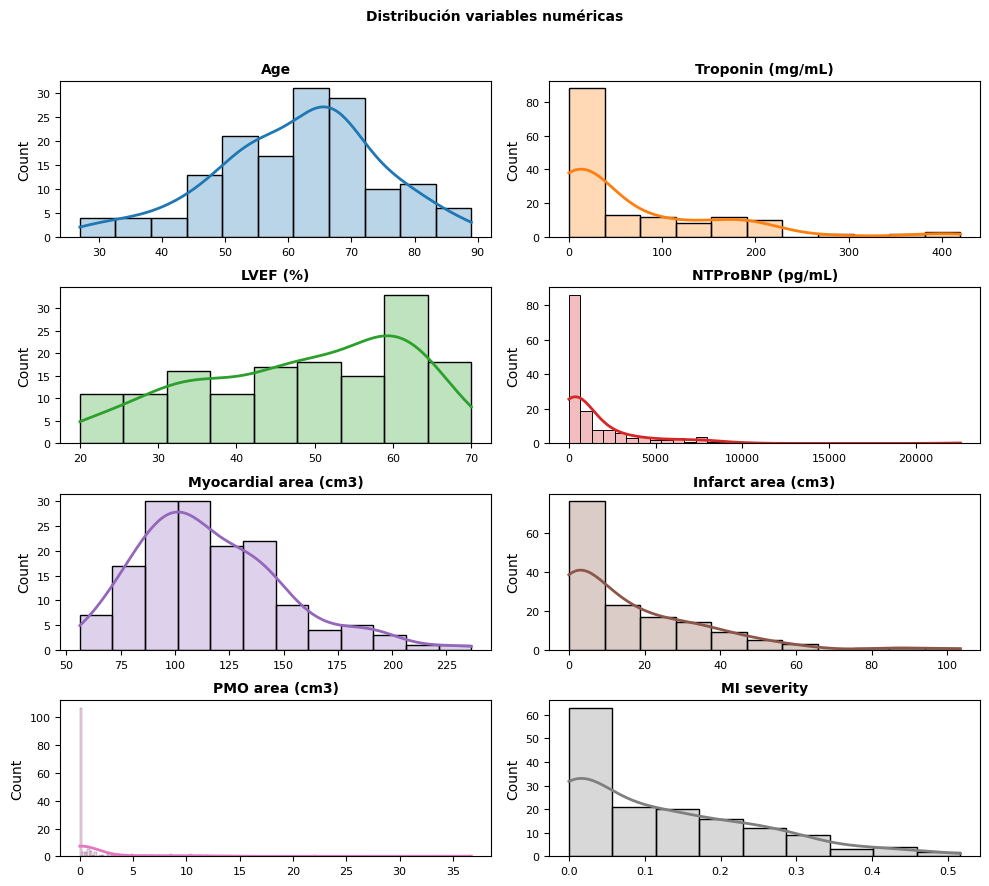

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(10, 9))
axes = axes.flat
columnas_numeric = patients_df_cop2.select_dtypes(include=['float64', 'int']).columns

for i, colum in enumerate(columnas_numeric):
    sns.histplot(
        data    = patients_df_cop2,
        x       = colum,
        stat    = "count",
        kde     = True,
        color   = (list(plt.rcParams['axes.prop_cycle'])*2)[i]["color"],
        line_kws= {'linewidth': 2},
        alpha   = 0.3,
        ax      = axes[i]
    )
    axes[i].set_title(colum, fontsize=10, fontweight="bold")
    axes[i].tick_params(labelsize=8)
    axes[i].set_xlabel("")

fig.tight_layout()
plt.subplots_adjust(top=0.9)
fig.suptitle('Distribución variables numéricas', fontsize=10, fontweight="bold");


#### Distribución variables categóricas

In [ ]:
patients_df_cop

,Case,Sex,Age,Tobacco,Overweight,Arterial hypertension,Diabetes,Familial history of CAD,ECG (ST +),Troponin (mg/mL),Killip Max,LVEF (%),NTProBNP (pg/mL),Myocardial area (cm3),Infarct area (cm3),PMO area (cm3),Status,MI severity
0,001,M,32,1,N,N,N,N,Y,130.0,1,35,447,200.366211,103.466797,36.743164,P,0.516388
1,002,M,57,1,Y,N,N,N,Y,28.0,1,61,192,167.918762,37.721680,10.333801,P,0.224642
2,003,M,67,2,N,N,N,N,Y,7.0,1,55,54,78.832617,8.020898,0.616992,P,0.101746
3,004,M,68,2,Y,N,N,N,Y,45.0,2,40,1075,126.509106,28.690137,0.000000,P,0.226783
4,005,M,62,1,Y,Y,Y,Y,N,7.0,1,55,1024,96.044861,13.242249,1.894897,P,0.137876
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,146,F,77,3,N,Y,N,N,N,32.0,2,55,2394,119.287390,7.275390,0.000000,P,0.060990
146,147,M,68,2,N,N,N,N,Y,200.0,1,45,132,193.405500,28.200500,0.000000,P,0.145810
147,148,M,68,2,Y,Y,N,Y,Y,26.0,1,30,6462,143.001800,34.665800,0.000000,P,0.242415
148,149,F,85,3,Y,Y,N,N,N,20.0,1,35,781,93.129800,0.000000,0.000000,N,0.000000


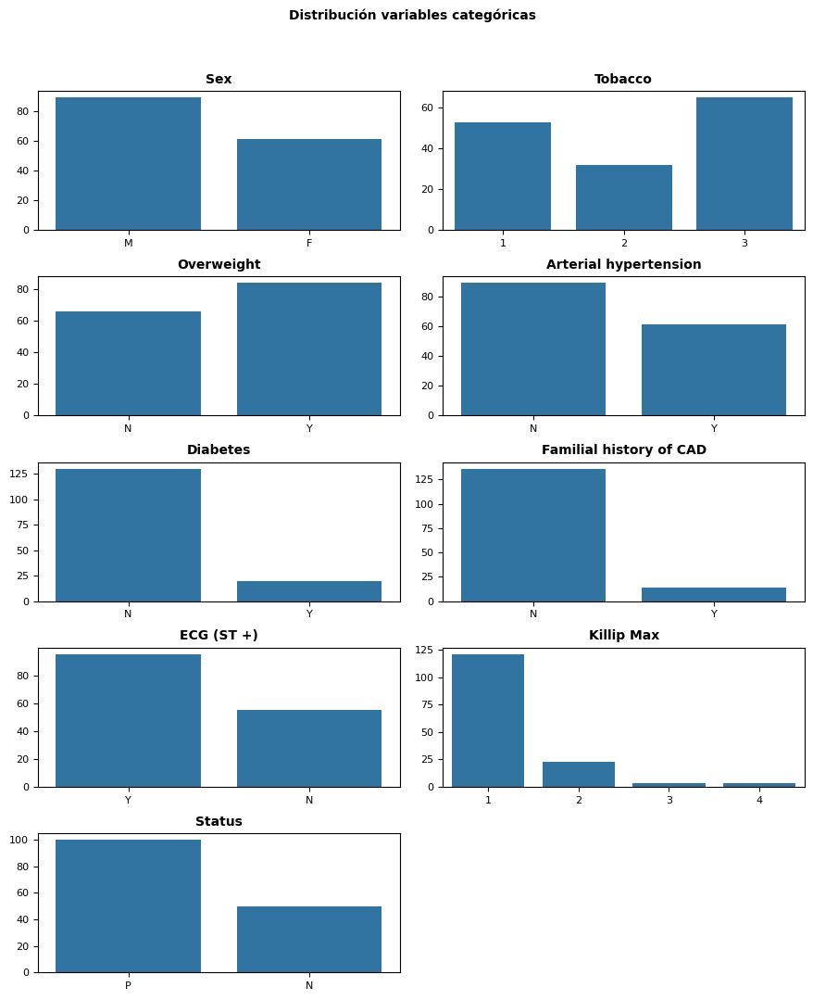

In [ ]:
columnas_categoricas = patients_df_cop[['Sex', 'Tobacco', 'Overweight', 'Arterial hypertension',
                     'Diabetes', 'Familial history of CAD', 'ECG (ST +)',
                     'Killip Max', 'Status']]

num_filas = 5
num_columnas = 2

fig, axes = plt.subplots(nrows=num_filas, ncols=num_columnas, figsize=(9, 11))

axes = axes.flat

for i, colum in enumerate(columnas_categoricas):
    fila_actual = i // num_columnas
    columna_actual = i % num_columnas

    sns.countplot(x=colum, data=patients_df_cop, ax=axes[i])

    axes[i].set_title(colum, fontsize=10, fontweight="bold")
    axes[i].tick_params(labelsize=8)
    axes[i].set_xlabel("")
    axes[i].set_ylabel("")

fig.tight_layout()
plt.subplots_adjust(top=0.9)
fig.suptitle('Distribución variables categóricas', fontsize=10, fontweight="bold")

fig.delaxes(axes[9])

plt.show()

#### División target

In [ ]:
data_x = patients_df.drop(columns=['MI severity'])
data_y=patients_df['MI severity']

print("Dimensión x: ", data_x.shape)
print("Dimensión y: ", data_y.shape)

Dimensión x:  (150, 17)
Dimensión y:  (150,)


#### Diagramas de dispersión

Gravedad para cada caso

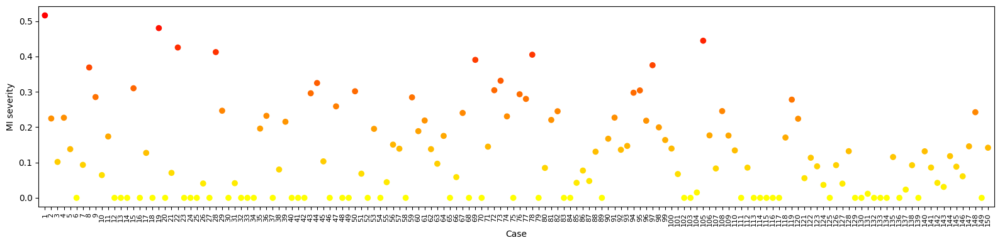

In [ ]:
plt.figure(figsize=(16, 4))

c = data_x.columns[0]  # Tomar solo la primera columna
normalized_severity = (data_y - data_y.min()) / (data_y.max() - data_y.min())
colors = np.array([[1, 1-normalized_severity[j], 0] for j in range(len(data_y))])

x_values = [int(x) for x in data_x[c]]
plt.scatter(x_values, data_y, color=colors)
plt.xlabel(c)
plt.ylabel("MI severity")

plt.xlim(min(x_values) - 1, max(x_values) + 1)
plt.xticks(x_values,rotation=90,fontsize=8)
plt.tight_layout()
plt.show()



Gravedad según las diferentes variables

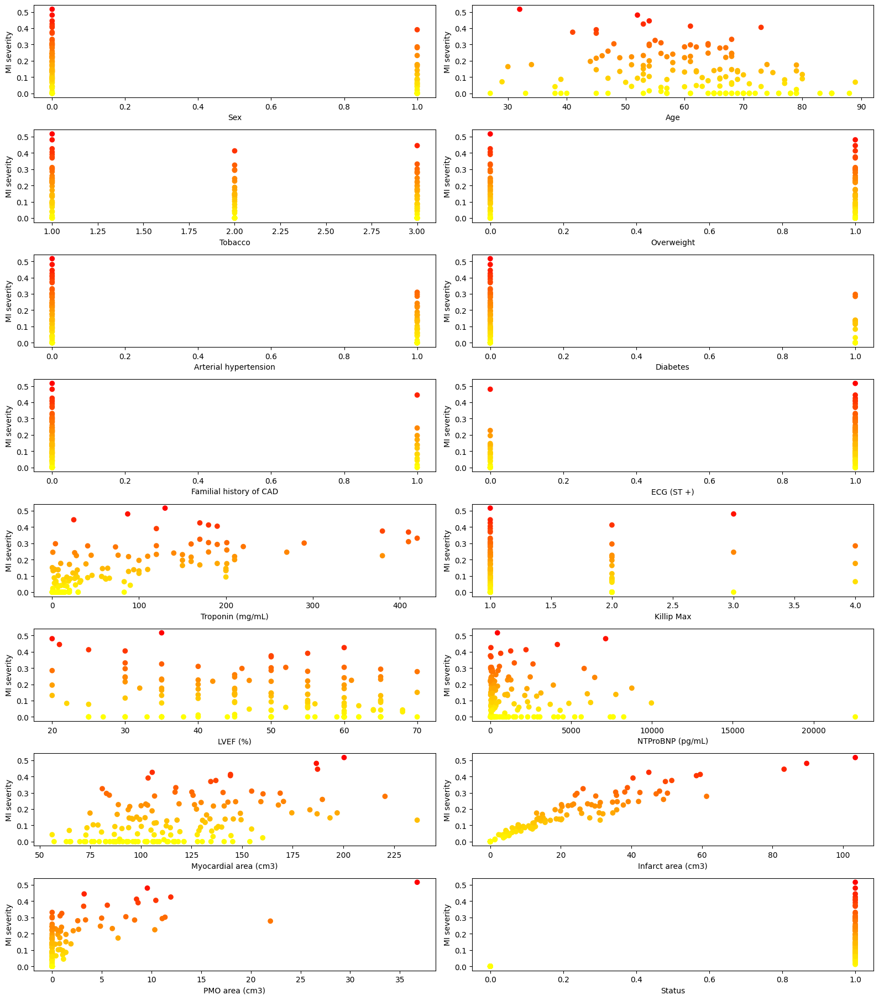

In [ ]:
plt.figure(figsize=(16, 20))

n_subplots = data_x.shape[1]
n_rows = (n_subplots + 1) // 2

for i, c in enumerate(data_x.columns[1:], start=1):
    ax = plt.subplot(n_rows, 2, i)
    normalized_severity = (data_y - data_y.min()) / (data_y.max() - data_y.min())
    colors = np.array([[1, 1-normalized_severity[j], 0] for j in range(len(data_y))])
    ax.scatter(data_x[c], data_y, color=colors)
    ax.set_xlabel(c)
    ax.set_ylabel("MI severity")

plt.tight_layout()
plt.show()

#### Matriz de correlación

In [ ]:
correlation=patients_df.corr()
correlation

,Case,Sex,Age,Tobacco,Overweight,Arterial hypertension,Diabetes,Familial history of CAD,ECG (ST +),Troponin (mg/mL),Killip Max,LVEF (%),NTProBNP (pg/mL),Myocardial area (cm3),Infarct area (cm3),PMO area (cm3),Status,MI severity
Case,1.000000,0.120203,0.052182,0.146063,-0.110730,-0.028053,0.038045,0.086800,0.027956,-0.098379,-0.009901,-0.105654,0.054299,0.076209,-0.119068,-0.225241,0.088184,-0.151942
Sex,0.120203,1.000000,0.312474,0.462779,-0.113740,0.309265,0.074527,0.060962,-0.327637,-0.362775,0.081461,-0.011596,0.228433,-0.420053,-0.472094,-0.212152,-0.508629,-0.482113
Age,0.052182,0.312474,1.000000,0.339439,-0.037081,0.287990,0.177926,0.000839,-0.178320,-0.280071,0.089615,-0.187118,0.295060,-0.161274,-0.282595,-0.201118,-0.249213,-0.302737
Tobacco,0.146063,0.462779,0.339439,1.000000,-0.041356,0.263040,0.031083,0.074720,-0.181674,-0.138372,0.076124,-0.003631,0.155454,-0.125858,-0.278320,-0.186508,-0.272171,-0.305845
Overweight,-0.110730,-0.113740,-0.037081,-0.041356,1.000000,0.077649,0.071116,0.099724,-0.117054,-0.049114,-0.074551,0.071877,0.009544,0.235504,0.020733,0.015468,-0.085470,-0.046969
Arterial hypertension,-0.028053,0.309265,0.287990,0.263040,0.077649,1.000000,0.234227,0.154272,-0.243146,-0.223509,-0.056349,0.068996,0.098186,-0.207443,-0.319929,-0.214048,-0.278306,-0.329535
Diabetes,0.038045,0.074527,0.177926,0.031083,0.071116,0.234227,1.000000,0.211241,-0.189919,-0.193378,0.097357,-0.001966,0.014512,-0.036449,-0.127842,-0.087974,-0.138675,-0.145048
Familial history of CAD,0.086800,0.060962,0.000839,0.074720,0.099724,0.154272,0.211241,1.000000,-0.183887,-0.153379,-0.059987,0.011829,0.016121,-0.012857,0.027422,-0.075353,0.129641,0.009125
ECG (ST +),0.027956,-0.327637,-0.178320,-0.181674,-0.117054,-0.243146,-0.189919,-0.183887,1.000000,0.417872,-0.001561,-0.067418,-0.073514,0.230391,0.410150,0.213997,0.489116,0.468648
Troponin (mg/mL),-0.098379,-0.362775,-0.280071,-0.138372,-0.049114,-0.223509,-0.193378,-0.153379,0.417872,1.000000,0.011077,-0.139649,-0.214665,0.237472,0.579927,0.250114,0.468096,0.678969


In [ ]:
patients_corr=patients_df.drop(columns=["Case", "Myocardial area (cm3)", "Infarct area (cm3)", "PMO area (cm3)"])

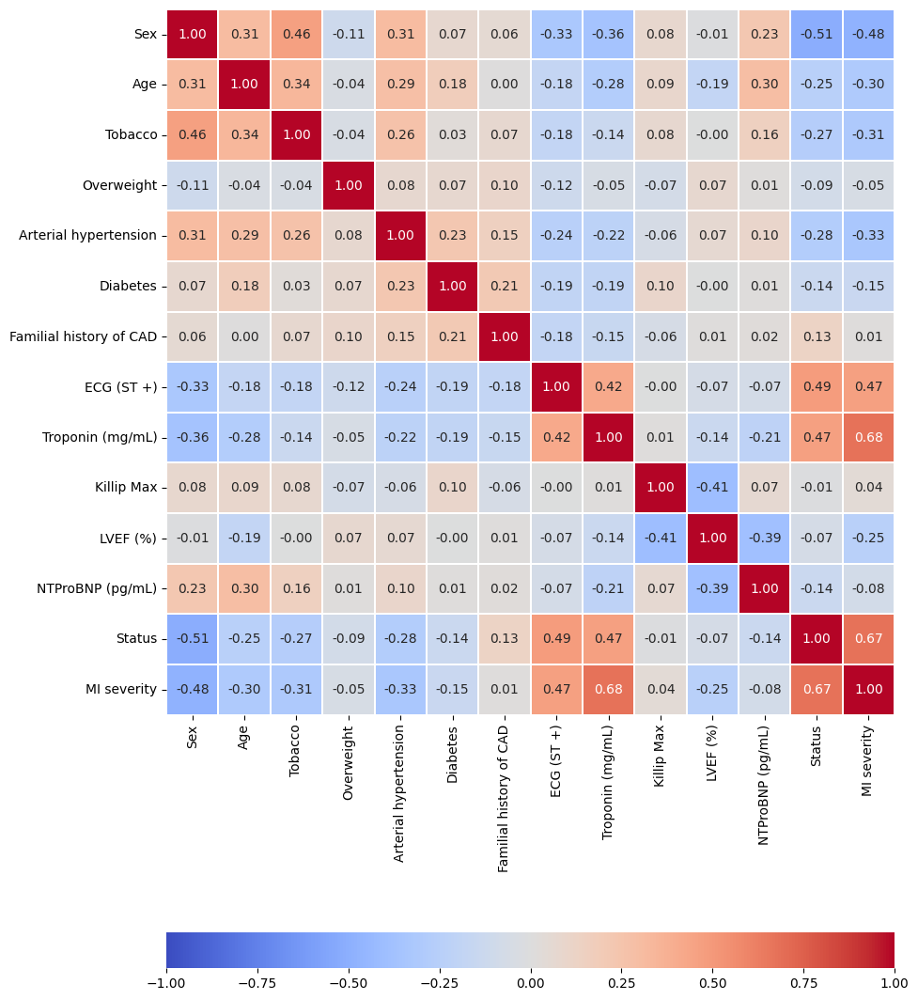

In [ ]:
plt.figure(figsize=(10, 15))
corr = patients_corr.corr()
sns.heatmap(corr,
            vmin=-1, vmax=1,
            cmap='coolwarm',
            annot=True,
            fmt='.2f',
            linewidths=0.1,
            cbar_kws={"orientation": "horizontal", "pad": 0.2})

plt.title("", pad=20)
plt.show()


Concretar más data_x

In [ ]:
data_x = data_x.drop(columns=['Case','Myocardial area (cm3)','Infarct area (cm3)','PMO area (cm3)','Status'])

In [ ]:
data_x

,Sex,Age,Tobacco,Overweight,Arterial hypertension,Diabetes,Familial history of CAD,ECG (ST +),Troponin (mg/mL),Killip Max,LVEF (%),NTProBNP (pg/mL)
0,0,32,1,0,0,0,0,1,130.0,1,35,447
1,0,57,1,1,0,0,0,1,28.0,1,61,192
2,0,67,2,0,0,0,0,1,7.0,1,55,54
3,0,68,2,1,0,0,0,1,45.0,2,40,1075
4,0,62,1,1,1,1,1,0,7.0,1,55,1024
...,...,...,...,...,...,...,...,...,...,...,...,...
145,1,77,3,0,1,0,0,0,32.0,2,55,2394
146,0,68,2,0,0,0,0,1,200.0,1,45,132
147,0,68,2,1,1,0,1,1,26.0,1,30,6462
148,1,85,3,1,1,0,0,0,20.0,1,35,781


#### Análisis de las variables

##### Variable Age

In [ ]:
conteo_status=patients_df_cop['Status'].value_counts()

print("Número de sujetos sanos (Status N):", conteo_status['N'])
print("Número de sujetos patológicos (Status P):", conteo_status['P'])

Número de sujetos sanos (Status N): 50
Número de sujetos patológicos (Status P): 100


In [ ]:
sujetos_sanos = patients_df_cop[patients_df_cop['Status'] == 'N']
media_edad_sanos = sujetos_sanos['Age'].mean()

sujetos_patologicos = patients_df_cop[patients_df_cop['Status'] == 'P']
media_edad_patologicos = sujetos_patologicos['Age'].mean()

media_edad_total = patients_df_cop['Age'].mean()

print("La media de edad para sujetos sanos es: %.2f" %media_edad_sanos)
print("La media de edad para sujetos patológicos es: %.2f" %media_edad_patologicos)
print("La media de edad para todos los sujetos es: %.2f" %media_edad_total)

La media de edad para sujetos sanos es: 65.96
La media de edad para sujetos patológicos es: 59.22
La media de edad para todos los sujetos es: 61.47


In [ ]:
intervalos = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

conteo_patologicos_por_intervalo = sujetos_patologicos.groupby(pd.cut(sujetos_patologicos['Age'], bins=intervalos)).size()

intervalo_max_patologicos = conteo_patologicos_por_intervalo.idxmax()

print("El intervalo de edad con mayor número de casos patológicos es:", intervalo_max_patologicos)

El intervalo de edad con mayor número de casos patológicos es: (60, 70]


##### Variable Sex

In [ ]:
conteo_sex=patients_df_cop['Sex'].value_counts()
total_hombres=conteo_sex['M']
total_mujeres=conteo_sex['F']

print("Número de hombres:", total_hombres)
print("Número de mujeres:", total_mujeres)

Número de hombres: 89
Número de mujeres: 61


In [ ]:
hombres = patients_df_cop[patients_df_cop['Sex'] == 'M']
hombres_sanos = hombres[hombres['Status'] == 'N']
hombres_patologicos = hombres[hombres['Status'] == 'P']

mujeres = patients_df_cop[patients_df_cop['Sex'] == 'F']
mujeres_sanas = mujeres[mujeres['Status'] == 'N']
mujeres_patologicas = mujeres[mujeres['Status'] == 'P']

print("El número de hombres sanos es:", hombres_sanos.shape[0])  # Contar el número de filas
print("El número de hombres patológicos es:", hombres_patologicos.shape[0])

print("El número de mujeres sanas es:", mujeres_sanas.shape[0])
print("El número de mujeres patológicas es:", mujeres_patologicas.shape[0])

porcentaje_hombres_sanos = (hombres_sanos.shape[0] / total_hombres) * 100
porcentaje_hombres_patologicos = (hombres_patologicos.shape[0] / total_hombres) * 100
porcentaje_mujeres_sanas = (mujeres_sanas.shape[0] / total_mujeres) * 100
porcentaje_mujeres_patologicas = (mujeres_patologicas.shape[0] / total_mujeres) * 100

print("Porcentaje de hombres sanos: %.2f" %porcentaje_hombres_sanos)
print("Porcentaje de hombres patológicos: %.2f" %porcentaje_hombres_patologicos)
print("Porcentaje de mujeres sanas: %.2f" %porcentaje_mujeres_sanas)
print("Porcentaje de mujeres patológicas: %.2f" %porcentaje_mujeres_patologicas)

El número de hombres sanos es: 12
El número de hombres patológicos es: 77
El número de mujeres sanas es: 38
El número de mujeres patológicas es: 23
Porcentaje de hombres sanos: 13.48
Porcentaje de hombres patológicos: 86.52
Porcentaje de mujeres sanas: 62.30
Porcentaje de mujeres patológicas: 37.70


In [ ]:
media_edad_hombres_sanos = hombres_sanos['Age'].mean()
media_edad_hombres_patologicos = hombres_patologicos['Age'].mean()
media_edad_mujeres_sanas = mujeres_sanas['Age'].mean()
media_edad_mujeres_patologicas = mujeres_patologicas['Age'].mean()
media_edad_sujetos_sanos = sujetos_sanos['Age'].mean()
media_edad_sujetos_patologicos = sujetos_patologicos['Age'].mean()

print("La media de edad de hombres sanos es: %.2f" %media_edad_hombres_sanos)
print("La media de edad de hombres patológicos es: %.2f" %media_edad_hombres_patologicos)
print("La media de edad de mujeres sanas es: %.2f" %media_edad_mujeres_sanas)
print("La media de edad de mujeres patológicas es: %.2f" %media_edad_mujeres_patologicas)
print("La media de edad de sujetos sanos es: %.2f" %media_edad_sujetos_sanos)
print("La media de edad de sujetos patológicos es: %.2f" %media_edad_sujetos_patologicos)

La media de edad de hombres sanos es: 55.00
La media de edad de hombres patológicos es: 58.66
La media de edad de mujeres sanas es: 69.42
La media de edad de mujeres patológicas es: 61.09
La media de edad de sujetos sanos es: 65.96
La media de edad de sujetos patológicos es: 59.22


In [ ]:
media_gravedad_hombres = hombres['MI severity'].mean()
media_gravedad_mujeres = mujeres['MI severity'].mean()

print("La media de gravedad del infarto de miocardio en hombres es: %.2f" %media_gravedad_hombres)
print("La media de gravedad del infarto de miocardio en mujeres es: %.2f" %media_gravedad_mujeres)

La media de gravedad del infarto de miocardio en hombres es: 0.17
La media de gravedad del infarto de miocardio en mujeres es: 0.05


##### Variable Tobacco

In [ ]:
fumadores_normales = sujetos_sanos[sujetos_sanos['Tobacco'] == 1]
no_fumadores_normales = sujetos_sanos[sujetos_sanos['Tobacco'] == 2]
ex_fumadores_normales = sujetos_sanos[sujetos_sanos['Tobacco'] == 3]

fumadores_patologicos = sujetos_patologicos[sujetos_patologicos['Tobacco'] == 1]
no_fumadores_patologicos = sujetos_patologicos[sujetos_patologicos['Tobacco'] == 2]
ex_fumadores_patologicos = sujetos_patologicos[sujetos_patologicos['Tobacco'] == 3]

total_normales = len(sujetos_sanos)
total_patologicos = len(sujetos_patologicos)

porcentaje_fumadores_normales = (len(fumadores_normales) / total_normales) * 100
porcentaje_no_fumadores_normales = (len(no_fumadores_normales) / total_normales) * 100
porcentaje_ex_fumadores_normales = (len(ex_fumadores_normales) / total_normales) * 100

porcentaje_fumadores_patologicos = (len(fumadores_patologicos) / total_patologicos) * 100
porcentaje_no_fumadores_patologicos = (len(no_fumadores_patologicos) / total_patologicos) * 100
porcentaje_ex_fumadores_patologicos = (len(ex_fumadores_patologicos) / total_patologicos) * 100

print("Porcentaje de fumadores en sujetos normales:", porcentaje_fumadores_normales)
print("Porcentaje de no fumadores en sujetos normales:", porcentaje_no_fumadores_normales)
print("Porcentaje de ex-fumadores en sujetos normales:", porcentaje_ex_fumadores_normales)
print()
print("Porcentaje de fumadores en sujetos patológicos:", porcentaje_fumadores_patologicos)
print("Porcentaje de no fumadores en sujetos patológicos:", porcentaje_no_fumadores_patologicos)
print("Porcentaje de ex-fumadores en sujetos patológicos:", porcentaje_ex_fumadores_patologicos)

Porcentaje de fumadores en sujetos normales: 18.0
Porcentaje de no fumadores en sujetos normales: 22.0
Porcentaje de ex-fumadores en sujetos normales: 60.0

Porcentaje de fumadores en sujetos patológicos: 44.0
Porcentaje de no fumadores en sujetos patológicos: 21.0
Porcentaje de ex-fumadores en sujetos patológicos: 35.0


In [ ]:
media_gravedad_por_tobacco = patients_df_cop.groupby('Tobacco')['MI severity'].mean()

print("Media de gravedad en relación con la columna Tobacco:")
print(media_gravedad_por_tobacco.round(2))

Media de gravedad en relación con la columna Tobacco:
Tobacco
1    0.17
2    0.11
3    0.08
Name: MI severity, dtype: float64


##### Variable Overweight

In [ ]:
porcentaje_obesidad_sanos = sujetos_sanos['Overweight'].value_counts(normalize=True) * 100
porcentaje_obesidad_patologicos = sujetos_patologicos['Overweight'].value_counts(normalize=True) * 100

print("Valores de obesidad en porcentaje en sujetos sanos:")
print(porcentaje_obesidad_sanos)

print("\nValores de obesidad en porcentaje en sujetos patológicos:")
print(porcentaje_obesidad_patologicos)

Valores de obesidad en porcentaje en sujetos sanos:
Overweight
Y    62.0
N    38.0
Name: proportion, dtype: float64

Valores de obesidad en porcentaje en sujetos patológicos:
Overweight
Y    53.0
N    47.0
Name: proportion, dtype: float64


##### Variable Arterial Hypertension

In [ ]:
hipertension_y_sanos = sujetos_sanos[sujetos_sanos['Arterial hypertension'] == 'Y']
hipertension_n_sanos = sujetos_sanos[sujetos_sanos['Arterial hypertension'] == 'N']

hipertension_y_patologicos = sujetos_patologicos[sujetos_patologicos['Arterial hypertension'] == 'Y']
hipertension_n_patologicos = sujetos_patologicos[sujetos_patologicos['Arterial hypertension'] == 'N']

total_sanos = len(sujetos_sanos)
total_patologicos = len(sujetos_patologicos)

porcentaje_hipertension_y_sanos = (len(hipertension_y_sanos) / total_sanos) * 100
porcentaje_hipertension_n_sanos = (len(hipertension_n_sanos) / total_sanos) * 100

porcentaje_hipertension_y_patologicos = (len(hipertension_y_patologicos) / total_patologicos) * 100
porcentaje_hipertension_n_patologicos = (len(hipertension_n_patologicos) / total_patologicos) * 100

print("Porcentaje de sujetos sanos con Hipertensión Arterial en Y:", porcentaje_hipertension_y_sanos)
print("Porcentaje de sujetos sanos con Hipertensión Arterial en N:", porcentaje_hipertension_n_sanos)
print("Porcentaje de sujetos patológicos con Hipertensión Arterial en Y:", porcentaje_hipertension_y_patologicos)
print("Porcentaje de sujetos patológicos con Hipertensión Arterial en N:", porcentaje_hipertension_n_patologicos)

Porcentaje de sujetos sanos con Hipertensión Arterial en Y: 60.0
Porcentaje de sujetos sanos con Hipertensión Arterial en N: 40.0
Porcentaje de sujetos patológicos con Hipertensión Arterial en Y: 31.0
Porcentaje de sujetos patológicos con Hipertensión Arterial en N: 69.0


##### Variable Diabetes

In [ ]:
diabetes_y_sanos = sujetos_sanos[sujetos_sanos['Diabetes'] == 'Y']
diabetes_n_sanos = sujetos_sanos[sujetos_sanos['Diabetes'] == 'N']

diabetes_y_patologicos = sujetos_patologicos[sujetos_patologicos['Diabetes'] == 'Y']
diabetes_n_patologicos = sujetos_patologicos[sujetos_patologicos['Diabetes'] == 'N']

total_sanos = len(sujetos_sanos)
total_patologicos = len(sujetos_patologicos)

porcentaje_diabetes_y_sanos = (len(diabetes_y_sanos) / total_sanos) * 100
porcentaje_diabetes_n_sanos = (len(diabetes_n_sanos) / total_sanos) * 100

porcentaje_diabetes_y_patologicos = (len(diabetes_y_patologicos) / total_patologicos) * 100
porcentaje_diabetes_n_patologicos = (len(diabetes_n_patologicos) / total_patologicos) * 100

print("Porcentaje de sujetos sanos con Diabetes en Y:", porcentaje_diabetes_y_sanos)
print("Porcentaje de sujetos sanos con Diabetes en N:", porcentaje_diabetes_n_sanos)
print("Porcentaje de sujetos patológicos con Diabetes en Y:", porcentaje_diabetes_y_patologicos)
print("Porcentaje de sujetos patológicos con Diabetes en N:", porcentaje_diabetes_n_patologicos)

Porcentaje de sujetos sanos con Diabetes en Y: 20.0
Porcentaje de sujetos sanos con Diabetes en N: 80.0
Porcentaje de sujetos patológicos con Diabetes en Y: 10.0
Porcentaje de sujetos patológicos con Diabetes en N: 90.0


##### Variable Familial history of coronary artery disease

In [ ]:
frecuencia_normales = sujetos_sanos['Familial history of CAD'].value_counts(normalize=True) * 100
frecuencia_patologicos = sujetos_patologicos['Familial history of CAD'].value_counts(normalize=True) * 100

print("Frecuencia de Familial history of coronary artery disease para sujetos normales:")
print(frecuencia_normales)

print("\nFrecuencia de Familial history of coronary artery disease para sujetos patológicos:")
print(frecuencia_patologicos)

Frecuencia de Familial history of coronary artery disease para sujetos normales:
Familial history of CAD
N    96.0
Y     4.0
Name: proportion, dtype: float64

Frecuencia de Familial history of coronary artery disease para sujetos patológicos:
Familial history of CAD
N    88.0
Y    12.0
Name: proportion, dtype: float64


##### Variable ECG (ST+)

In [ ]:
ecg_y_sanos = sujetos_sanos[sujetos_sanos['ECG (ST +)'] == 'Y']
ecg_n_sanos = sujetos_sanos[sujetos_sanos['ECG (ST +)'] == 'N']

ecg_y_patologicos = sujetos_patologicos[sujetos_patologicos['ECG (ST +)'] == 'Y']
ecg_n_patologicos = sujetos_patologicos[sujetos_patologicos['ECG (ST +)'] == 'N']

total_sanos = len(sujetos_sanos)
total_patologicos = len(sujetos_patologicos)

porcentaje_ecg_y_sanos = (len(ecg_y_sanos) / total_sanos) * 100
porcentaje_ecg_n_sanos = (len(ecg_n_sanos) / total_sanos) * 100

porcentaje_ecg_y_patologicos = (len(ecg_y_patologicos) / total_patologicos) * 100
porcentaje_ecg_n_patologicos = (len(ecg_n_patologicos) / total_patologicos) * 100

print("Porcentaje de sujetos sanos con ECG (ST+) en Y:", porcentaje_ecg_y_sanos)
print("Porcentaje de sujetos sanos con ECG (ST+) en N:", porcentaje_ecg_n_sanos)
print("Porcentaje de sujetos patológicos con ECG (ST+) en Y:", porcentaje_ecg_y_patologicos)
print("Porcentaje de sujetos patológicos con ECG (ST+) en N:", porcentaje_ecg_n_patologicos)

Porcentaje de sujetos sanos con ECG (ST+) en Y: 30.0
Porcentaje de sujetos sanos con ECG (ST+) en N: 70.0
Porcentaje de sujetos patológicos con ECG (ST+) en Y: 80.0
Porcentaje de sujetos patológicos con ECG (ST+) en N: 20.0


In [ ]:
grupo_elevacion_st = patients_df_cop.groupby('ECG (ST +)')['MI severity']

media_gravedad_con_elevacion_st = grupo_elevacion_st.get_group('Y').mean()
media_gravedad_sin_elevacion_st = grupo_elevacion_st.get_group('N').mean()

print("Media de gravedad para pacientes con elevación del segmento ST: %.2f" %media_gravedad_con_elevacion_st)
print("Media de gravedad para pacientes sin elevación del segmento ST: %.2f" %media_gravedad_sin_elevacion_st)

Media de gravedad para pacientes con elevación del segmento ST: 0.16
Media de gravedad para pacientes sin elevación del segmento ST: 0.04


##### Variable Troponin

In [ ]:
media_troponin_sanos = sujetos_sanos['Troponin (mg/mL)'].mean()
media_troponin_patologicos = sujetos_patologicos['Troponin (mg/mL)'].mean()

print("Media de Troponin en sujetos sanos: %.2f" %media_troponin_sanos)
print("Media de Troponin en sujetos patológicos: %.2f" %media_troponin_patologicos)

Media de Troponin en sujetos sanos: 7.68
Media de Troponin en sujetos patológicos: 101.04


##### Variable Killip Max

In [ ]:
porcentaje_killip_sanos = sujetos_sanos['Killip Max'].value_counts(normalize=True) * 100
porcentaje_killip_patologicos = sujetos_patologicos['Killip Max'].value_counts(normalize=True) * 100

print("Porcentaje de sujetos sanos por valor de Killip Max:")
print(porcentaje_killip_sanos)
print("\nPorcentaje de sujetos patológicos por valor de Killip Max:")
print(porcentaje_killip_patologicos)

Porcentaje de sujetos sanos por valor de Killip Max:
Killip Max
1    76.0
2    22.0
3     2.0
Name: proportion, dtype: float64

Porcentaje de sujetos patológicos por valor de Killip Max:
Killip Max
1    83.0
2    12.0
4     3.0
3     2.0
Name: proportion, dtype: float64


##### Variable LVEF

In [ ]:
porcentaje_lvef_menor_igual_35_normales = (sujetos_sanos['LVEF (%)'] <= 35).mean() * 100
porcentaje_lvef_menor_igual_35_patologicos = (sujetos_patologicos['LVEF (%)'] <= 35).mean() * 100

print("Porcentaje de casos normales con LVEF <= 35: %.2f" %porcentaje_lvef_menor_igual_35_normales)
print("Porcentaje de casos patológicos con LVEF <= 35: %.2f" %porcentaje_lvef_menor_igual_35_patologicos)

Porcentaje de casos normales con LVEF <= 35: 28.00
Porcentaje de casos patológicos con LVEF <= 35: 24.00


In [ ]:
porcentaje_lvef_gravedad_severa_normales = (sujetos_sanos['LVEF (%)'] < 30).mean() * 100
porcentaje_lvef_gravedad_severa_patologicos = (sujetos_patologicos['LVEF (%)'] < 30).mean() * 100

sujetos_lvef_gravedad_moderada_normales=(sujetos_sanos['LVEF (%)'] >= 30) & (sujetos_sanos['LVEF (%)'] <= 40)
porcentaje_lvef_gravedad_moderada_normales = sujetos_lvef_gravedad_moderada_normales.mean() * 100
sujetos_lvef_gravedad_moderada_patologicos=(sujetos_patologicos['LVEF (%)'] >= 30) & (sujetos_patologicos['LVEF (%)'] <= 40)
porcentaje_lvef_gravedad_moderada_patologicos = sujetos_lvef_gravedad_moderada_patologicos.mean() * 100

sujetos_lvef_gravedad_leve_normales = ((sujetos_sanos['LVEF (%)'] >= 41) & (sujetos_sanos['LVEF (%)'] <= 51) & (sujetos_sanos['Sex'] == 'M')) | ((sujetos_sanos['LVEF (%)'] >= 41) & (sujetos_sanos['LVEF (%)'] <= 53) & (sujetos_sanos['Sex'] == 'F'))
porcentaje_lvef_gravedad_leve_normales = sujetos_lvef_gravedad_leve_normales.mean() * 100
sujetos_lvef_gravedad_leve_patologicos = ((sujetos_patologicos['LVEF (%)'] >= 41) & (sujetos_patologicos['LVEF (%)'] <= 51) & (sujetos_patologicos['Sex'] == 'M')) | ((sujetos_patologicos['LVEF (%)'] >= 41) & (sujetos_patologicos['LVEF (%)'] <= 53) & (sujetos_patologicos['Sex'] == 'F'))
porcentaje_lvef_gravedad_leve_patologicos = sujetos_lvef_gravedad_leve_patologicos.mean() * 100

sujetos_lvef_gravedad_normal_normales = ((sujetos_sanos['LVEF (%)'] >= 52) & (sujetos_sanos['LVEF (%)'] <= 72) & (sujetos_sanos['Sex'] == 'M')) | ((sujetos_sanos['LVEF (%)'] >= 54) & (sujetos_sanos['LVEF (%)'] <= 74) & (sujetos_sanos['Sex'] == 'F'))
porcentaje_lvef_gravedad_normal_normales = sujetos_lvef_gravedad_normal_normales.mean() * 100
sujetos_lvef_gravedad_normal_patologicos = ((sujetos_patologicos['LVEF (%)'] >= 52) & (sujetos_patologicos['LVEF (%)'] <= 72) & (sujetos_patologicos['Sex'] == 'M')) | ((sujetos_patologicos['LVEF (%)'] >= 54) & (sujetos_patologicos['LVEF (%)'] <= 74) & (sujetos_patologicos['Sex'] == 'F'))
porcentaje_lvef_gravedad_normal_patologicos = sujetos_lvef_gravedad_normal_patologicos.mean() * 100

print("Porcentaje de casos normales con LVEF < 30 (gravedad severa): %.2f" %porcentaje_lvef_gravedad_severa_normales)
print("Porcentaje de casos patológicos con LVEF < 30 (gravedad severa): %.2f" %porcentaje_lvef_gravedad_severa_patologicos)
print("Porcentaje de casos normales con LVEF entre 30 y 40 (gravedad moderada): %.2f" %porcentaje_lvef_gravedad_moderada_normales)
print("Porcentaje de casos patológicos con LVEF entre 30 y 40 (gravedad moderada): %.2f" %porcentaje_lvef_gravedad_moderada_patologicos)
print("Porcentaje de casos normales con LVEF entre 41 y 51 para hombres y entre 41 y 53 para mujeres (gravedad leve): %.2f" %porcentaje_lvef_gravedad_leve_normales)
print("Porcentaje de casos patológicos con LVEF entre 41 y 51 para hombres y entre 41 y 53 para mujeres (gravedad leve): %.2f" %porcentaje_lvef_gravedad_leve_patologicos)
print("Porcentaje de casos normales con LVEF entre 52 y 72 para hombres y entre 54 y 74 para mujeres (sin gravedad): %.2f" %porcentaje_lvef_gravedad_normal_normales)
print("Porcentaje de casos patológicos con LVEF entre 52 y 72 para hombres y entre 54 y 74 para mujeres (sin gravedad): %.2f" %porcentaje_lvef_gravedad_normal_patologicos)



Porcentaje de casos normales con LVEF < 30 (gravedad severa): 8.00
Porcentaje de casos patológicos con LVEF < 30 (gravedad severa): 8.00
Porcentaje de casos normales con LVEF entre 30 y 40 (gravedad moderada): 26.00
Porcentaje de casos patológicos con LVEF entre 30 y 40 (gravedad moderada): 23.00
Porcentaje de casos normales con LVEF entre 41 y 51 para hombres y entre 41 y 53 para mujeres (gravedad leve): 14.00
Porcentaje de casos patológicos con LVEF entre 41 y 51 para hombres y entre 41 y 53 para mujeres (gravedad leve): 28.00
Porcentaje de casos normales con LVEF entre 52 y 72 para hombres y entre 54 y 74 para mujeres (sin gravedad): 52.00
Porcentaje de casos patológicos con LVEF entre 52 y 72 para hombres y entre 54 y 74 para mujeres (sin gravedad): 41.00


##### Variable NTProBNP

In [ ]:
ntproBNP_promedio_normales = (sujetos_sanos['NTProBNP (pg/mL)'] > 135).mean() * 100
ntproBNP_promedio_patologicos = (sujetos_patologicos['NTProBNP (pg/mL)'] < 135).mean() * 100

print("NTProBNP promedio para sujetos sanos:", ntproBNP_promedio_normales)
print("NTProBNP promedio para sujetos patológicos:", ntproBNP_promedio_patologicos)

NTProBNP promedio para sujetos sanos: 76.0
NTProBNP promedio para sujetos patológicos: 42.0


##### Variable "Myocardial area", "Infarct area", "Persistent Microvascular Obstruction area"

In [ ]:
patients_df_cop_n = patients_df_cop[(patients_df_cop['Infarct area (cm3)'] == 0)]
patients_df_cop_p = patients_df_cop[(patients_df_cop['PMO area (cm3)'] == 0) &
                                     (patients_df_cop['Infarct area (cm3)'] != 0)]
patients_df_cop_pmo = patients_df_cop[(patients_df_cop['PMO area (cm3)'] != 0) &
                                     (patients_df_cop['Infarct area (cm3)'] != 0)]

conteo_casos_normales = len(patients_df_cop_n)
conteo_casos_patologicos_sin_pmo = len(patients_df_cop_p)
conteo_casos_patologicos_con_pmo = len(patients_df_cop_pmo)

total_pacientes = len(patients_df_cop)
porcentaje_normales = (conteo_casos_normales / total_pacientes) * 100
porcentaje_sin_pmo = (conteo_casos_patologicos_sin_pmo / total_pacientes) * 100
porcentaje_con_pmo = (conteo_casos_patologicos_con_pmo / total_pacientes) * 100

print("Número de pacientes normales:", conteo_casos_normales, "(%.2f" %porcentaje_normales, "% del total)")
print("Número de pacientes patológicos sin PMO:", conteo_casos_patologicos_sin_pmo, "(%.2f" %porcentaje_sin_pmo, "% del total)")
print("Número de pacientes patológicos con PMO:", conteo_casos_patologicos_con_pmo, "(%.2f" %porcentaje_con_pmo, "% del total)")

Número de pacientes normales: 50 (33.33 % del total)
Número de pacientes patológicos sin PMO: 57 (38.00 % del total)
Número de pacientes patológicos con PMO: 43 (28.67 % del total)


### REGRESIÓN LINEAL

###### Optimización de hiperparámetros

###### Fit_intercept

In [ ]:
n_executions = 100
r2_train_scores = np.zeros((n_executions, 2))
r2_test_scores = np.zeros((n_executions, 2))

for i, fit_intercept in enumerate([True, False]):
    for execution in range(n_executions):
        random_state = execution + 1

        x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

        min_max_scaler = MinMaxScaler()
        min_max_scaler.fit(x_train)
        x_train = min_max_scaler.transform(x_train)
        x_test = min_max_scaler.transform(x_test)

        lr = lm.LinearRegression(fit_intercept=fit_intercept)
        lr.fit(x_train, y_train)

        r2_train = lr.score(x_train, y_train)
        r2_test = lr.score(x_test, y_test)

        r2_train_scores[execution, i] = r2_train
        r2_test_scores[execution, i] = r2_test

In [ ]:
mean_r2_train = np.mean(r2_train_scores, axis=0)
std_r2_train = np.std(r2_train_scores, axis=0) / (n_executions**0.5)
mean_r2_test = np.mean(r2_test_scores, axis=0)
std_r2_test = np.std(r2_test_scores, axis=0) / (n_executions**0.5)

for i, fit_intercept in enumerate([True, False]):
    print(f"Con fit_intercept={fit_intercept}:")
    print(f"R2 promedio (train): {mean_r2_train[i]:.5f} ± {std_r2_train[i]:.5f}")
    print(f"R2 promedio (test): {mean_r2_test[i]:.5f} ± {std_r2_test[i]:.5f}")

Con fit_intercept=True:
R2 promedio (train): 0.63366 ± 0.00251
R2 promedio (test): 0.51369 ± 0.00879
Con fit_intercept=False:
R2 promedio (train): 0.59177 ± 0.00342
R2 promedio (test): 0.45435 ± 0.01269


##### Entrenamiento y predicciones

In [ ]:
lr = lm.LinearRegression(fit_intercept=True)
lr.fit(x_train, y_train)
y_predict_train = lr.predict(x_train)
y_predict_test = lr.predict(x_test)

##### Evaluación del modelo

###### Coeficiente de determinación $R^2$

In [ ]:
n_executions = 100

r2_train_scores = np.zeros(n_executions)
r2_test_scores = np.zeros(n_executions)

for execution in range(n_executions):
    random_state = execution + 1

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    lr = lm.LinearRegression(fit_intercept=True)
    lr.fit(x_train, y_train)

    r2_train = lr.score(x_train, y_train)
    r2_test = lr.score(x_test, y_test)

    r2_train_scores[execution] = r2_train
    r2_test_scores[execution] = r2_test

mean_r2_train = np.mean(r2_train_scores)
std_r2_train = np.std(r2_train_scores) / n_executions**0.5  # Error estándar de la media
mean_r2_test = np.mean(r2_test_scores)
std_r2_test = np.std(r2_test_scores) / n_executions**0.5  # Error estándar de la media

print(f"R2 promedio (train): {mean_r2_train:.5f} ± {std_r2_train:.5f}")
print(f"R2 promedio (test): {mean_r2_test:.5f} ± {std_r2_test:.5f}")


R2 promedio (train): 0.63366 ± 0.00251
R2 promedio (test): 0.51369 ± 0.00879


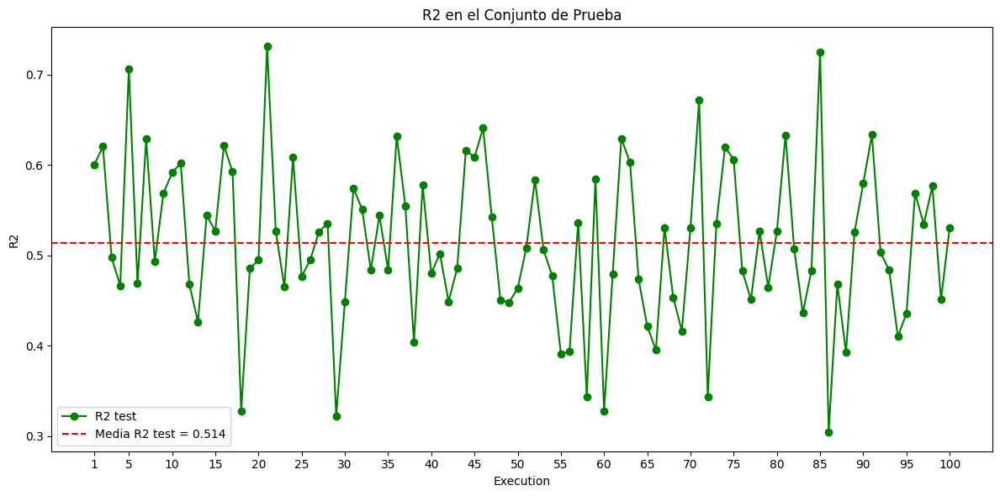

In [ ]:
plt.figure(figsize=(12, 6))

plt.plot(range(1, n_executions + 1), r2_test_scores, marker='o', linestyle='-', color='green', label='R2 test')
plt.axhline(y=mean_r2_test, color='red', linestyle='--', label=f'Media R2 test = {mean_r2_test:.3f}')
plt.xlabel('Execution')
plt.xticks([1] + [i for i in range(1, n_executions + 1) if i % 5 == 0])  # Más espacio en el eje x
plt.ylabel('R2')
plt.title('R2 en el Conjunto de Prueba')
plt.legend()

plt.tight_layout()
plt.show()

##### Evaluación de predicciones


EJEMPLO representativo del modelo

In [ ]:
n_executions = 100

r2_test_values = []

for i in range(n_executions):
    random_state = i + 1

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)
    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    lr = lm.LinearRegression()
    lr.fit(x_train, y_train)

    r2_test = lr.score(x_test, y_test)
    r2_test_values.append(r2_test)

mean_r2_test = np.mean(r2_test_values)

print(f"R2 Test Promedio: {mean_r2_test:.5f}")

index_closest_to_mean = np.argmin(np.abs(np.array(r2_test_values) - mean_r2_test))
closest_random_state = index_closest_to_mean + 1
closest_r2 = r2_test_values[index_closest_to_mean]

print(f"Random State más cercano al R2 Test Promedio: {closest_random_state}")
print(f"R2 correspondiente: {closest_r2:.5f}")


R2 Test Promedio: 0.51369
Random State más cercano al R2 Test Promedio: 51
R2 correspondiente: 0.50839


In [ ]:
x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=51)
min_max_scaler = MinMaxScaler()
min_max_scaler.fit(x_train)
x_train = min_max_scaler.transform(x_train)
x_test = min_max_scaler.transform(x_test)
lr = lm.LinearRegression()
lr.fit(x_train, y_train)
y_predict_train = lr.predict(x_train)
y_predict_test = lr.predict(x_test)

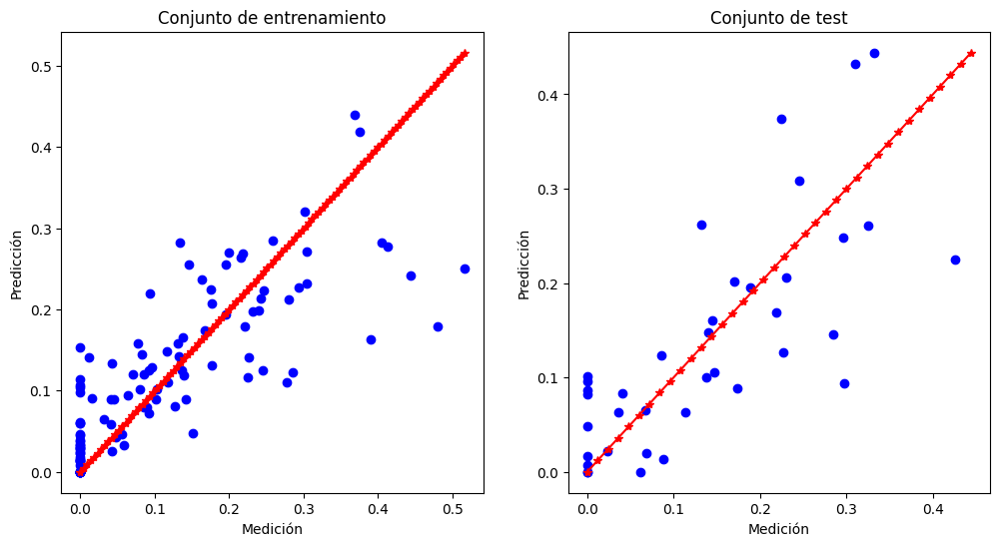

In [ ]:
y_train = np.maximum(y_train, 0)
y_predict_train = np.maximum(y_predict_train, 0)

y_test = np.maximum(y_test, 0)
y_predict_test = np.maximum(y_predict_test, 0)

x = np.linspace(min(min(y_train), min(y_predict_train)), max(max(y_train), max(y_predict_train)), len(y_train))

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.scatter(y_train, y_predict_train, c='blue')
plt.plot(x,x,'r*-')
plt.xlabel("Gravedad real")
plt.ylabel("Gravedad predicha")
plt.title ("Conjunto de entrenamiento")

x = np.linspace(min(min(y_test), min(y_predict_test)), max(max(y_test), max(y_predict_test)), len(y_test))

plt.subplot(1,2,2)
plt.scatter(y_test, y_predict_test, c='blue')
plt.plot(x,x,'r*-')
plt.xlabel("Gravedad real")
plt.ylabel("Gravedad predicha")
plt.title("Conjunto de test")
plt.show()

##### Evaluación de clasificación: normal o patológico

In [ ]:
n_executions = 100

precision_train_scores = []
recall_train_scores = []
f1_train_scores = []
accuracy_train_scores = []

precision_test_scores = []
recall_test_scores = []
f1_test_scores = []
accuracy_test_scores = []

for random_state in range(1, n_executions + 1):

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    lr = lm.LinearRegression()
    lr.fit(x_train, y_train)

    y_predict_train = lr.predict(x_train)
    y_predict_test = lr.predict(x_test)

    y_train_bin = np.where(y_train > 0, 1, 0)
    y_test_bin = np.where(y_test > 0, 1, 0)
    y_predict_train_bin = np.where(y_predict_train > 0, 1, 0)
    y_predict_test_bin = np.where(y_predict_test > 0, 1, 0)

    precision_train = precision_score(y_train_bin, y_predict_train_bin)
    recall_train = recall_score(y_train_bin, y_predict_train_bin)
    f1_train = f1_score(y_train_bin, y_predict_train_bin)
    accuracy_train = accuracy_score(y_train_bin, y_predict_train_bin)

    precision_test = precision_score(y_test_bin, y_predict_test_bin)
    recall_test = recall_score(y_test_bin, y_predict_test_bin)
    f1_test = f1_score(y_test_bin, y_predict_test_bin)
    accuracy_test = accuracy_score(y_test_bin, y_predict_test_bin)

    precision_train_scores.append(precision_train)
    recall_train_scores.append(recall_train)
    f1_train_scores.append(f1_train)
    accuracy_train_scores.append(accuracy_train)

    precision_test_scores.append(precision_test)
    recall_test_scores.append(recall_test)
    f1_test_scores.append(f1_test)
    accuracy_test_scores.append(accuracy_test)

std_precision_train = np.std(precision_train_scores) / (n_executions ** 0.5)
std_recall_train = np.std(recall_train_scores) / (n_executions ** 0.5)
std_f1_train = np.std(f1_train_scores) / (n_executions ** 0.5)
std_accuracy_train = np.std(accuracy_train_scores) / (n_executions ** 0.5)

std_precision_test = np.std(precision_test_scores) / (n_executions ** 0.5)
std_recall_test = np.std(recall_test_scores) / (n_executions ** 0.5)
std_f1_test = np.std(f1_test_scores) / (n_executions ** 0.5)
std_accuracy_test = np.std(accuracy_test_scores) / (n_executions ** 0.5)

print("Conjunto de entrenamiento:")
print(f"Precision: {np.mean(precision_train_scores):.5f} ± {std_precision_train:.5f}")
print(f"Recall: {np.mean(recall_train_scores):.5f} ± {std_recall_train:.5f}")
print(f"F1-Score: {np.mean(f1_train_scores):.5f} ± {std_f1_train:.5f}")
print(f"Accuracy: {np.mean(accuracy_train_scores):.5f} ± {std_accuracy_train:.5f}")

print("\nConjunto de test:")
print(f"Precision: {np.mean(precision_test_scores):.5f} ± {std_precision_test:.5f}")
print(f"Recall: {np.mean(recall_test_scores):.5f} ± {std_recall_test:.5f}")
print(f"F1-Score: {np.mean(f1_test_scores):.5f} ± {std_f1_test:.5f}")
print(f"Accuracy: {np.mean(accuracy_test_scores):.5f} ± {std_accuracy_test:.5f}")

Conjunto de entrenamiento:
Precision: 0.73561 ± 0.00260
Recall: 0.99143 ± 0.00086
F1-Score: 0.84430 ± 0.00175
Accuracy: 0.75616 ± 0.00251

Conjunto de test:
Precision: 0.73359 ± 0.00723
Recall: 0.98490 ± 0.00231
F1-Score: 0.83877 ± 0.00494
Accuracy: 0.75237 ± 0.00670


### RANDOM FOREST REGRESSOR

##### Optimización de hiperparámetros

###### Grid manual

In [ ]:
n_estimators_values = [10, 30, 90]
max_features_values = ["sqrt", "log2", None]
max_depth_values = [10, 30, 90]
min_samples_leaf_values = [5, 15, 45]
max_leaf_nodes_values = [10, 30, 90]
min_samples_split_values = [10, 30, 90]
bootstrap_values = [True, False]

n_executions = 100

train_scores = np.zeros((n_executions, len(n_estimators_values) * len(max_features_values) * len(max_depth_values) * len(min_samples_leaf_values) * len(max_leaf_nodes_values) * len(min_samples_split_values) * len(bootstrap_values)))
test_scores = np.zeros((n_executions, len(n_estimators_values) * len(max_features_values) * len(max_depth_values) * len(min_samples_leaf_values) * len(max_leaf_nodes_values) * len(min_samples_split_values) * len(bootstrap_values)))

index = 0
for n_estimators in n_estimators_values:
    for max_features in max_features_values:
        for max_depth in max_depth_values:
            for min_samples_leaf in min_samples_leaf_values:
                for max_leaf_nodes in max_leaf_nodes_values:
                    for min_samples_split in min_samples_split_values:
                        for bootstrap in bootstrap_values:
                            if index < train_scores.shape[1]:
                                for i in range(n_executions):
                                    random_state = i + 1

                                    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

                                    modelo = RandomForestRegressor(n_estimators=n_estimators,
                                                                    max_features=max_features,
                                                                    max_depth=max_depth,
                                                                    min_samples_leaf=min_samples_leaf,
                                                                    max_leaf_nodes=max_leaf_nodes,
                                                                    min_samples_split=min_samples_split,
                                                                    bootstrap=bootstrap)
                                    modelo.fit(x_train, y_train)

                                    y_train_pred = modelo.predict(x_train)
                                    r2_train = r2_score(y_train, y_train_pred)
                                    train_scores[i, index] = r2_train

                                    y_test_pred = modelo.predict(x_test)
                                    r2_test = r2_score(y_test, y_test_pred)
                                    test_scores[i, index] = r2_test

                                index += 1

mean_train_scores = np.mean(train_scores, axis=0)
std_train_scores = np.std(train_scores, axis=0) / (n_executions**0.5)
mean_test_scores = np.mean(test_scores, axis=0)
std_test_scores = np.std(test_scores, axis=0) / (n_executions**0.5)

In [ ]:
results_df = pd.DataFrame({
    'n_estimators': np.repeat(n_estimators_values, len(max_features_values) * len(max_depth_values) * len(min_samples_leaf_values) * len(max_leaf_nodes_values) * len(min_samples_split_values) * len(bootstrap_values)),
    'max_features': np.tile(np.repeat(max_features_values, len(max_depth_values) * len(min_samples_leaf_values) * len(max_leaf_nodes_values) * len(min_samples_split_values) * len(bootstrap_values)), len(n_estimators_values)),
    'max_depth': np.tile(np.repeat(max_depth_values, len(min_samples_leaf_values) * len(max_leaf_nodes_values) * len(min_samples_split_values) * len(bootstrap_values)), len(n_estimators_values) * len(max_features_values)),
    'min_samples_leaf': np.tile(np.repeat(min_samples_leaf_values, len(max_leaf_nodes_values) * len(min_samples_split_values) * len(bootstrap_values)), len(n_estimators_values) * len(max_features_values) * len(max_depth_values)),
    'max_leaf_nodes': np.tile(np.repeat(max_leaf_nodes_values, len(min_samples_split_values) * len(bootstrap_values)), len(n_estimators_values) * len(max_features_values) * len(max_depth_values) * len(min_samples_leaf_values)),
    'min_samples_split': np.tile(np.repeat(min_samples_split_values, len(bootstrap_values)), len(n_estimators_values) * len(max_features_values) * len(max_depth_values) * len(min_samples_leaf_values) * len(max_leaf_nodes_values)),
    'bootstrap': np.tile(bootstrap_values, len(n_estimators_values) * len(max_features_values) * len(max_depth_values) * len(min_samples_leaf_values) * len(max_leaf_nodes_values) * len(min_samples_split_values)),
    'mean_train_score': mean_train_scores,
    'std_train_score': std_train_scores,
    'mean_test_score': mean_test_scores,
    'std_test_score': std_test_scores
})

results_df = results_df.sort_values('mean_test_score', ascending=False)

top_10_results = results_df.head(10)

pd.set_option('display.width', 1000)

print(top_10_results)

      n_estimators max_features  max_depth  min_samples_leaf  max_leaf_nodes  min_samples_split  bootstrap  mean_train_score  std_train_score  mean_test_score  std_test_score
1350            90         None         30                 5              10                 10       True          0.782952         0.001651         0.600464        0.010304
810             30         None         10                 5              10                 10       True          0.780108         0.001886         0.600049        0.009924
1362            90         None         30                 5              90                 10       True          0.783886         0.001648         0.599924        0.010086
1410            90         None         90                 5              30                 10       True          0.783860         0.001569         0.599165        0.010156
1356            90         None         30                 5              30                 10       True          0.784531 

###### Refinamiento

Prueba 1

In [ ]:
n_executions = 100
best_r2 = -float('inf')
best_std = None
best_n_estimators = None
best_min_samples_leaf = None
best_min_samples_split = None

min_samples_leaf_range = range(1, 11, 1)
min_samples_split_range = range(2, 21, 1)

results_df = pd.DataFrame(columns=['n_estimators', 'min_samples_leaf', 'min_samples_split', 'mean_train_r2', 'std_train_r2', 'mean_test_r2', 'std_test_r2'])

for min_samples_leaf in min_samples_leaf_range:
    for min_samples_split in min_samples_split_range:
        for n_estimators in range(30, 111, 20):
            train_r2_values = []
            test_r2_values = []

            for i in range(n_executions):
                random_state = i + 1

                x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

                min_max_scaler = MinMaxScaler()
                min_max_scaler.fit(x_train)
                x_train = min_max_scaler.transform(x_train)
                x_test = min_max_scaler.transform(x_test)

                modelo = RandomForestRegressor(n_estimators=n_estimators, bootstrap=True, max_features=None,
                                                min_samples_leaf=min_samples_leaf, min_samples_split=min_samples_split, random_state=random_state)
                modelo.fit(x_train, y_train)

                train_r2 = modelo.score(x_train, y_train)
                test_r2 = modelo.score(x_test, y_test)

                train_r2_values.append(train_r2)
                test_r2_values.append(test_r2)

            mean_train_r2 = np.mean(train_r2_values)
            std_train_r2 = np.std(train_r2_values)/(len(train_r2_values)**0.5)  # Calcular std y luego **0.5 para la desviación estándar

            mean_test_r2 = np.mean(test_r2_values)
            std_test_r2 = np.std(test_r2_values)/(len(test_r2_values)**0.5)  # Calcular std y luego **0.5 para la desviación estándar

            # Almacenar resultados en DataFrame
            result = {
                'n_estimators': n_estimators,
                'min_samples_leaf': min_samples_leaf,
                'min_samples_split': min_samples_split,
                'mean_train_r2': mean_train_r2,
                'std_train_r2': std_train_r2,
                'mean_test_r2': mean_test_r2,
                'std_test_r2': std_test_r2
            }

            temp_df = pd.DataFrame([result])
            print(temp_df)

            results_df = pd.concat([results_df, temp_df], ignore_index=True)

pd.set_option('display.width', 1000)
print(results_df)

   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            30                 1                  2       0.936092      0.000789      0.592197     0.010063
   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            50                 1                  2       0.939763      0.000673       0.59396     0.010179
   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            70                 1                  2       0.941193      0.000621      0.594168     0.010223
   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            90                 1                  2       0.942077       0.00058      0.594031     0.010113
   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0           110    

In [ ]:
top_results = results_df.sort_values(by='mean_test_r2', ascending=False)

top_20_results = top_results.head(20)

print("Combinaciones de los 20 mejores resultados:")
print(top_20_results)

Combinaciones de los 20 mejores resultados:
    n_estimators min_samples_leaf min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
198           90                3                 3       0.854299      0.001217      0.605421     0.009959
193           90                3                 2       0.854299      0.001217      0.605421     0.009959
213           90                3                 6       0.854299      0.001217      0.605421     0.009959
208           90                3                 5       0.854299      0.001217      0.605421     0.009959
203           90                3                 4       0.854299      0.001217      0.605421     0.009959
209          110                3                 5       0.854782      0.001228      0.605227     0.010009
214          110                3                 6       0.854782      0.001228      0.605227     0.010009
199          110                3                 3       0.854782      0.001228      0.6052

Prueba 2

In [ ]:
n_executions = 100
best_r2 = -float('inf')
best_std = None
best_n_estimators = None
best_min_samples_leaf = None
best_min_samples_split = None

min_samples_leaf_range = [3, 4]
min_samples_split_range = range(2, 7, 1)

results_df = pd.DataFrame(columns=['n_estimators', 'min_samples_leaf', 'min_samples_split', 'mean_train_r2', 'std_train_r2', 'mean_test_r2', 'std_test_r2'])

for min_samples_leaf in min_samples_leaf_range:
    for min_samples_split in min_samples_split_range:
        for n_estimators in range(70, 121, 5):
            train_r2_values = []
            test_r2_values = []

            for i in range(n_executions):
                random_state = i + 1

                x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

                min_max_scaler = MinMaxScaler()
                min_max_scaler.fit(x_train)
                x_train = min_max_scaler.transform(x_train)
                x_test = min_max_scaler.transform(x_test)

                modelo = RandomForestRegressor(n_estimators=n_estimators, bootstrap=True, max_features=None,
                                                min_samples_leaf=min_samples_leaf, min_samples_split=min_samples_split, random_state=random_state)
                modelo.fit(x_train, y_train)

                train_r2 = modelo.score(x_train, y_train)
                test_r2 = modelo.score(x_test, y_test)

                train_r2_values.append(train_r2)
                test_r2_values.append(test_r2)

            mean_train_r2 = np.mean(train_r2_values)
            std_train_r2 = np.std(train_r2_values)/(len(train_r2_values)**0.5)  # Calcular std y luego **0.5 para la desviación estándar

            mean_test_r2 = np.mean(test_r2_values)
            std_test_r2 = np.std(test_r2_values)/(len(test_r2_values)**0.5)  # Calcular std y luego **0.5 para la desviación estándar

            result = {
                'n_estimators': n_estimators,
                'min_samples_leaf': min_samples_leaf,
                'min_samples_split': min_samples_split,
                'mean_train_r2': mean_train_r2,
                'std_train_r2': std_train_r2,
                'mean_test_r2': mean_test_r2,
                'std_test_r2': std_test_r2
            }

            temp_df = pd.DataFrame([result])
            print(temp_df)

            results_df = pd.concat([results_df, temp_df], ignore_index=True)

pd.set_option('display.width', 1000)
print(results_df)

   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            70                 3                  2        0.85347       0.00125       0.60507     0.010102
   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            75                 3                  2       0.853733       0.00126      0.604931     0.010058
   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            80                 3                  2       0.853962      0.001246      0.604587     0.009971
   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            85                 3                  2       0.854148      0.001235      0.604908     0.009948
   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            90    

In [ ]:
top_results = results_df.sort_values(by='mean_test_r2', ascending=False)

top_20_results = top_results.head(20)

print("Combinaciones de los 20 mejores resultados:")
print(top_20_results)

Combinaciones de los 20 mejores resultados:
   n_estimators min_samples_leaf min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
43          120                3                 5       0.855022      0.001215      0.606002     0.010082
21          120                3                 3       0.855022      0.001215      0.606002     0.010082
32          120                3                 4       0.855022      0.001215      0.606002     0.010082
10          120                3                 2       0.855022      0.001215      0.606002     0.010082
54          120                3                 6       0.855022      0.001215      0.606002     0.010082
31          115                3                 4       0.854881      0.001219      0.605697     0.010058
42          115                3                 5       0.854881      0.001219      0.605697     0.010058
20          115                3                 3       0.854881      0.001219      0.605697     0.

Prueba 3

In [ ]:
n_executions = 100
best_r2 = -float('inf')
best_std = None
best_n_estimators = None
best_min_samples_leaf = None
best_min_samples_split = None

min_samples_leaf_range = [3]
min_samples_split_range = range(2, 6, 1)

results_df = pd.DataFrame(columns=['n_estimators', 'min_samples_leaf', 'min_samples_split', 'mean_train_r2', 'std_train_r2', 'mean_test_r2', 'std_test_r2'])

for min_samples_leaf in min_samples_leaf_range:
    for min_samples_split in min_samples_split_range:
        for n_estimators in range(120, 201, 20):
            train_r2_values = []
            test_r2_values = []

            for i in range(n_executions):
                random_state = i + 1

                x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

                min_max_scaler = MinMaxScaler()
                min_max_scaler.fit(x_train)
                x_train = min_max_scaler.transform(x_train)
                x_test = min_max_scaler.transform(x_test)

                modelo = RandomForestRegressor(n_estimators=n_estimators, bootstrap=True, max_features=None,
                                                min_samples_leaf=min_samples_leaf, min_samples_split=min_samples_split, random_state=random_state)
                modelo.fit(x_train, y_train)

                train_r2 = modelo.score(x_train, y_train)
                test_r2 = modelo.score(x_test, y_test)

                train_r2_values.append(train_r2)
                test_r2_values.append(test_r2)

            mean_train_r2 = np.mean(train_r2_values)
            std_train_r2 = np.std(train_r2_values)/(len(train_r2_values)**0.5)  # Calcular std y luego **0.5 para la desviación estándar

            mean_test_r2 = np.mean(test_r2_values)
            std_test_r2 = np.std(test_r2_values)/(len(test_r2_values)**0.5)  # Calcular std y luego **0.5 para la desviación estándar

            result = {
                'n_estimators': n_estimators,
                'min_samples_leaf': min_samples_leaf,
                'min_samples_split': min_samples_split,
                'mean_train_r2': mean_train_r2,
                'std_train_r2': std_train_r2,
                'mean_test_r2': mean_test_r2,
                'std_test_r2': std_test_r2
            }

            temp_df = pd.DataFrame([result])
            print(temp_df)

            results_df = pd.concat([results_df, temp_df], ignore_index=True)

pd.set_option('display.width', 1000)
print(results_df)

   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0           120                 3                  2       0.855022      0.001215      0.606002     0.010082
   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0           140                 3                  2       0.855127      0.001214      0.606019     0.010093
   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0           160                 3                  2       0.855423      0.001212      0.606381     0.010195
   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0           180                 3                  2       0.855494       0.00119      0.606632     0.010179
   n_estimators  min_samples_leaf  min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0           200    

In [ ]:
top_results = results_df.sort_values(by='mean_test_r2', ascending=False)

top_20_results = top_results.head(20)

print("Combinaciones de los 20 mejores resultados:")
print(top_20_results)

Combinaciones de los 20 mejores resultados:
   n_estimators min_samples_leaf min_samples_split  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
19          200                3                 5       0.855736      0.001188      0.606681     0.010143
4           200                3                 2       0.855736      0.001188      0.606681     0.010143
9           200                3                 3       0.855736      0.001188      0.606681     0.010143
14          200                3                 4       0.855736      0.001188      0.606681     0.010143
3           180                3                 2       0.855494      0.001190      0.606632     0.010179
18          180                3                 5       0.855494      0.001190      0.606632     0.010179
8           180                3                 3       0.855494      0.001190      0.606632     0.010179
13          180                3                 4       0.855494      0.001190      0.606632     0.

###### Análisis del modelo para *n_estimators*

In [ ]:
n_executions = 100
estimator_range = range(1, 201, 1)

train_scores = np.zeros((n_executions, len(estimator_range)))
test_scores = np.zeros((n_executions, len(estimator_range)))

for i in range(n_executions):
    random_state = i + 1

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    for j, n_estimators in enumerate(estimator_range):
        modelo = RandomForestRegressor(n_estimators=n_estimators, bootstrap=True, max_features=None,max_leaf_nodes=None,
                                                min_samples_leaf=3, min_samples_split=5,random_state=random_state)
        modelo.fit(x_train, y_train)

        r2_train = modelo.score(x_train, y_train)
        train_scores[i, j] = r2_train

        r2_test = modelo.score(x_test, y_test)
        test_scores[i, j] = r2_test

mean_train_scores = np.mean(train_scores, axis=0)
std_train_scores = np.std(train_scores, axis=0) / (len(train_scores)**0.5)

mean_test_scores = np.mean(test_scores, axis=0)
std_test_scores = np.std(test_scores, axis=0) / (len(test_scores)**0.5)

In [ ]:
results_df = pd.DataFrame({
    'n_estimators': estimator_range,
    'mean_test_r2': mean_test_scores,
    'std_test_r2': std_test_scores
})

print("Tabla de resultados:")
print(results_df)

Tabla de resultados:
     n_estimators  mean_test_r2  std_test_r2
0               1      0.354334     0.018541
1               2      0.492215     0.012994
2               3      0.532056     0.011552
3               4      0.550927     0.011923
4               5      0.561363     0.011007
..            ...           ...          ...
195           196      0.606664     0.010172
196           197      0.606644     0.010154
197           198      0.606650     0.010148
198           199      0.606659     0.010147
199           200      0.606681     0.010143

[200 rows x 3 columns]


In [ ]:
df=results_df
max_mean_r2 = df['mean_test_r2'].max()
max_n_estimators = df.loc[df['mean_test_r2'].idxmax(), 'n_estimators']

std_dev = df.loc[df['mean_test_r2'].idxmax(), 'std_test_r2']
lower_bound = max_mean_r2 - std_dev
upper_bound = max_mean_r2 + std_dev

n_estimators_in_range = df[(df['mean_test_r2'] >= lower_bound) & (df['mean_test_r2'] <= upper_bound)]['n_estimators'].tolist()

print(f"Valor máximo de mean_test_r2: {max_mean_r2}")
print(f"Rango calculado (mean_test_r2 ± std_test_r2): {lower_bound} a {upper_bound}")
print(f"n_estimators dentro del rango: {n_estimators_in_range}")

Valor máximo de mean_test_r2: 0.6067943111922381
Rango calculado (mean_test_r2 ± std_test_r2): 0.5966240886443994 a 0.6169645337400769
n_estimators dentro del rango: [23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200]


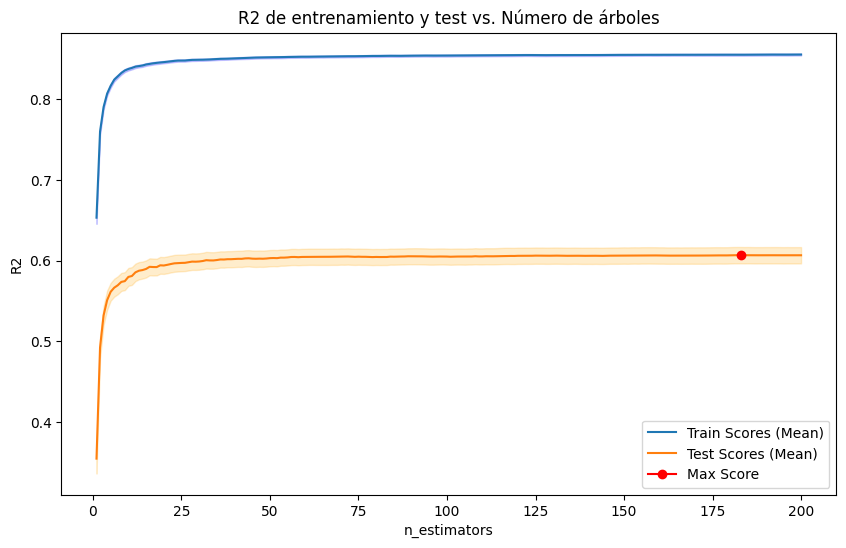

Valor óptimo de n_estimators: 183


In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))

ax.plot(estimator_range, mean_train_scores, label="Train Scores (Mean)")
ax.fill_between(estimator_range, mean_train_scores - std_train_scores, mean_train_scores + std_train_scores, alpha=0.2, color='blue')
ax.plot(estimator_range, mean_test_scores, label="Test Scores (Mean)")
ax.fill_between(estimator_range, mean_test_scores - std_test_scores, mean_test_scores + std_test_scores, alpha=0.2, color='orange')

best_n_estimators = estimator_range[np.argmax(mean_test_scores)]
best_test_score = np.max(mean_test_scores)
ax.plot(best_n_estimators, best_test_score, marker='o', color="red", label="Max Score")

ax.set_ylabel("R2")
ax.set_xlabel("n_estimators")
ax.set_title("R2 de entrenamiento y test vs. Número de árboles")
plt.legend()
plt.show()

print(f"Valor óptimo de n_estimators: {best_n_estimators}")

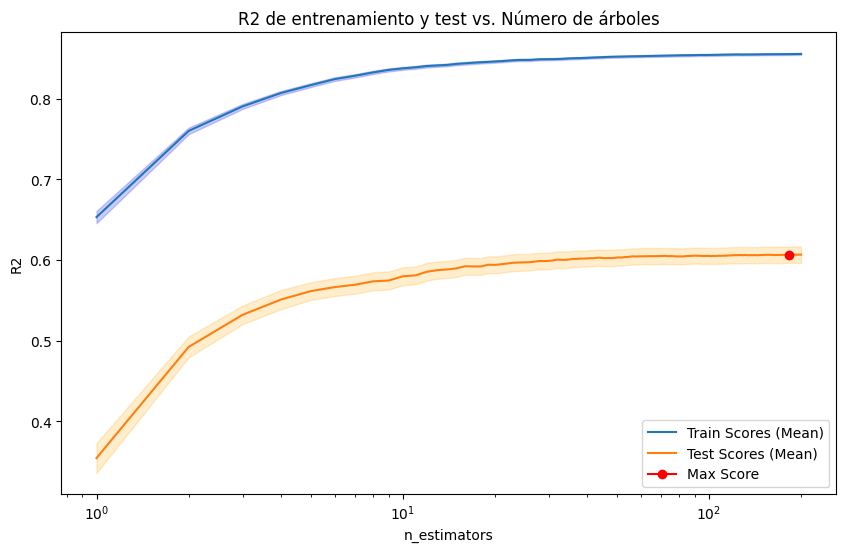

Valor óptimo de n_estimators: 183


In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))

ax.plot(estimator_range, mean_train_scores, label="Train Scores (Mean)")
ax.fill_between(estimator_range, mean_train_scores - std_train_scores, mean_train_scores + std_train_scores, alpha=0.2, color='blue')
ax.plot(estimator_range, mean_test_scores, label="Test Scores (Mean)")
ax.fill_between(estimator_range, mean_test_scores - std_test_scores, mean_test_scores + std_test_scores, alpha=0.2, color='orange')

best_n_estimators = estimator_range[np.argmax(mean_test_scores)]
best_test_score = np.max(mean_test_scores)
ax.plot(best_n_estimators, best_test_score, marker='o', color="red", label="Max Score")

ax.set_ylabel("R2")
ax.set_xlabel("n_estimators")
ax.set_title("R2 de entrenamiento y test vs. Número de árboles")

plt.xscale('log')

plt.legend()
plt.show()

print(f"Valor óptimo de n_estimators: {best_n_estimators}")

##### Evaluación del modelo

###### Coeficiente de determinación $R^2$

In [ ]:
n_executions = 100

r2_train_scores = []
r2_test_scores = []


for random_state in range(1, n_executions + 1):

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)
    model = RandomForestRegressor(n_estimators=200, bootstrap=True, max_features=None,max_leaf_nodes=None,
                                                min_samples_leaf=3, min_samples_split=5,random_state=random_state)

    model.fit(x_train, y_train)

    r2_train = model.score(x_train, y_train)
    r2_test = model.score(x_test, y_test)

    r2_train_scores.append(r2_train)
    r2_test_scores.append(r2_test)

mean_r2_train = np.mean(r2_train_scores)
std_r2_train = np.std(r2_train_scores) / n_executions**0.5  # Error estándar de la media
mean_r2_test = np.mean(r2_test_scores)
std_r2_test = np.std(r2_test_scores) / n_executions**0.5  # Error estándar de la media

print(f"R2 promedio (train): {mean_r2_train:.5f} ± {std_r2_train:.5f}")
print(f"R2 promedio (test): {mean_r2_test:.5f} ± {std_r2_test:.5f}")

R2 promedio (train): 0.85574 ± 0.00119
R2 promedio (test): 0.60668 ± 0.01014


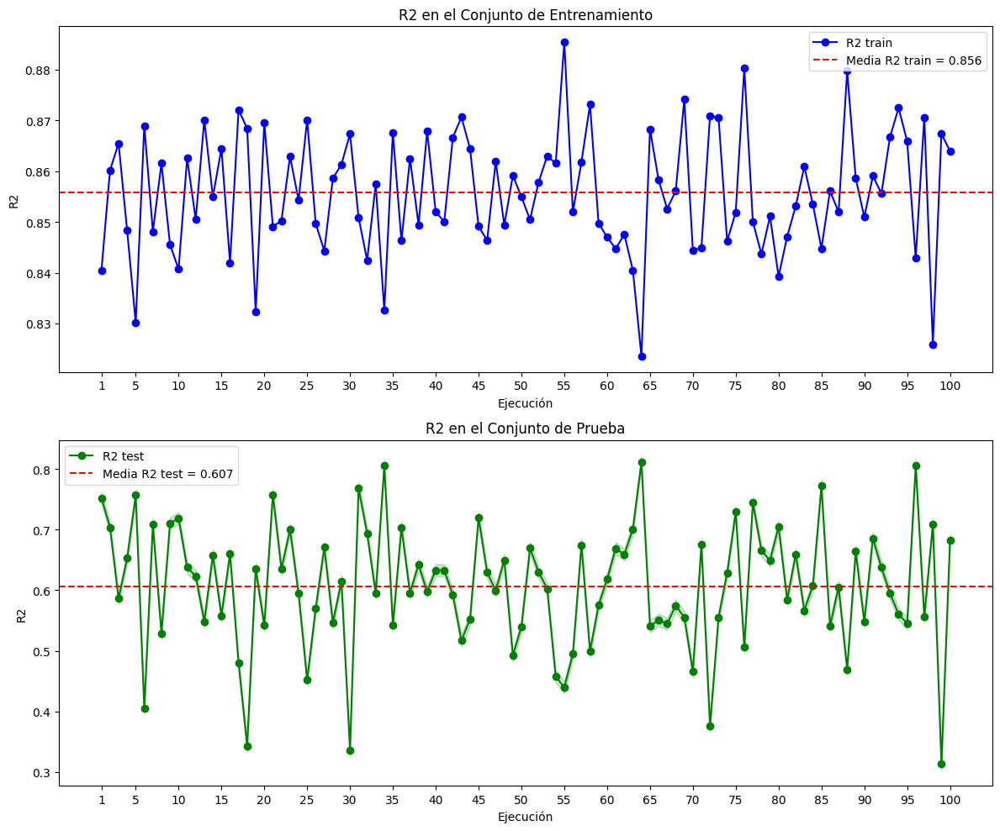

In [ ]:
plt.figure(figsize=(12, 10))

plt.subplot(2, 1, 1)
plt.plot(range(1, n_executions + 1), r2_train_scores, marker='o', linestyle='-', color='blue', label='R2 train')
plt.axhline(y=mean_r2_train, color='r', linestyle='--', label=f'Media R2 train = {mean_r2_train:.3f}')

plt.xlabel('Ejecución')
plt.xticks([1] + [i for i in range(1, n_executions + 1) if i % 5 == 0])  # Más espacio en el eje x
plt.ylabel('R2')
plt.title('R2 en el Conjunto de Entrenamiento')
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(range(1, n_executions + 1), r2_test_scores, marker='o', linestyle='-', color='green', label='R2 test')
plt.axhline(y=mean_r2_test, color='r', linestyle='--', label=f'Media R2 test = {mean_r2_test:.3f}')
plt.fill_between(range(1, n_executions + 1),
                 np.array(r2_test_scores) - std_r2_test,
                 np.array(r2_test_scores) + std_r2_test,
                 color='green', alpha=0.2)
plt.xlabel('Ejecución')
plt.xticks([1] + [i for i in range(1, n_executions + 1) if i % 5 == 0])  # Más espacio en el eje x
plt.ylabel('R2')
plt.title('R2 en el Conjunto de Prueba')
plt.legend()

plt.tight_layout()
plt.show()

##### Evaluación de predicciones

Ejemplo con la partición más representativa del modelo

In [ ]:
r2_test_values = []
n_executions=100

for i in range(n_executions):
    random_state = i + 1

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    rf = RandomForestRegressor(n_estimators=200, bootstrap=True, max_features=None,max_leaf_nodes=None,
                                                min_samples_leaf=3, min_samples_split=5,random_state=random_state)
    rf.fit(x_train, y_train)

    r2_test = rf.score(x_test, y_test)
    r2_test_values.append(r2_test)

mean_r2_test = np.mean(r2_test_values)

print(f"R2 Test Promedio: {mean_r2_test:.5f}")

index_closest_to_mean = np.argmin(np.abs(np.array(r2_test_values) - mean_r2_test))
closest_random_state = index_closest_to_mean + 1
closest_r2 = r2_test_values[index_closest_to_mean]

print(f"Random State más cercano al R2 Test Promedio: {closest_random_state}")
print(f"R2 correspondiente: {closest_r2:.5f}")

R2 Test Promedio: 0.60668
Random State más cercano al R2 Test Promedio: 84
R2 correspondiente: 0.60729


In [ ]:
x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=84)
min_max_scaler = MinMaxScaler()
min_max_scaler.fit(x_train)
x_train = min_max_scaler.transform(x_train)
x_test = min_max_scaler.transform(x_test)
rf = RandomForestRegressor(n_estimators=200, bootstrap=True, max_features=None,max_leaf_nodes=None,
                                                min_samples_leaf=3, min_samples_split=5,random_state=84)
rf.fit(x_train, y_train)
y_predict_train = rf.predict(x_train)
y_predict_test = rf.predict(x_test)

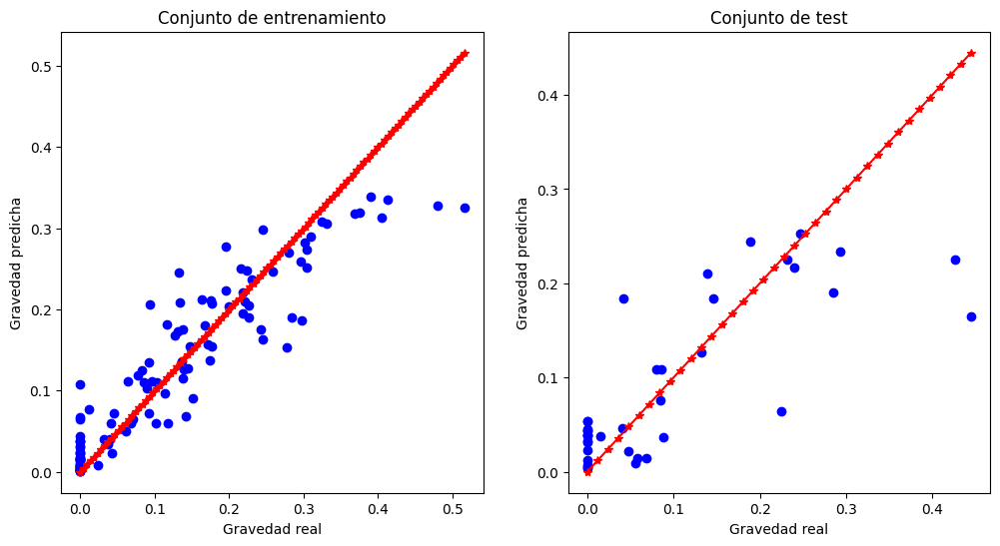

In [ ]:
y_train = np.maximum(y_train, 0)
y_predict_train = np.maximum(y_predict_train, 0)

y_test = np.maximum(y_test, 0)
y_predict_test = np.maximum(y_predict_test, 0)

x = np.linspace(min(min(y_train), min(y_predict_train)), max(max(y_train), max(y_predict_train)), len(y_train))

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.scatter(y_train, y_predict_train, c='blue')
plt.plot(x,x,'r*-')
plt.xlabel("Gravedad real")
plt.ylabel("Gravedad predicha")
plt.title ("Conjunto de entrenamiento")

x = np.linspace(min(min(y_test), min(y_predict_test)), max(max(y_test), max(y_predict_test)), len(y_test))

plt.subplot(1,2,2)
plt.scatter(y_test, y_predict_test, c='blue')
plt.plot(x,x,'r*-')
plt.xlabel("Gravedad real")
plt.ylabel("Gravedad predicha")
plt.title("Conjunto de test")
plt.show()

##### Evaluación de clasificación: normal o patológico

In [ ]:
n_executions = 100

precision_train_scores = []
recall_train_scores = []
f1_train_scores = []
accuracy_train_scores = []

precision_test_scores = []
recall_test_scores = []
f1_test_scores = []
accuracy_test_scores = []

for random_state in range(1, n_executions + 1):
    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    model = RandomForestRegressor(n_estimators=200, bootstrap=True, max_features=None,max_leaf_nodes=None,
                                                min_samples_leaf=3, min_samples_split=5,random_state=random_state)


    model.fit(x_train, y_train)

    y_predict_train = model.predict(x_train)
    y_predict_test = model.predict(x_test)

    y_train_bin = np.where(y_train > 0, 1, 0)
    y_test_bin = np.where(y_test > 0, 1, 0)
    y_predict_train_bin = np.where(y_predict_train > 0, 1, 0)
    y_predict_test_bin = np.where(y_predict_test > 0, 1, 0)

    precision_train = precision_score(y_train_bin, y_predict_train_bin)
    recall_train = recall_score(y_train_bin, y_predict_train_bin)
    f1_train = f1_score(y_train_bin, y_predict_train_bin)
    accuracy_train = accuracy_score(y_train_bin, y_predict_train_bin)

    precision_test = precision_score(y_test_bin, y_predict_test_bin)
    recall_test = recall_score(y_test_bin, y_predict_test_bin)
    f1_test = f1_score(y_test_bin, y_predict_test_bin)
    accuracy_test = accuracy_score(y_test_bin, y_predict_test_bin)

    precision_train_scores.append(precision_train)
    recall_train_scores.append(recall_train)
    f1_train_scores.append(f1_train)
    accuracy_train_scores.append(accuracy_train)

    precision_test_scores.append(precision_test)
    recall_test_scores.append(recall_test)
    f1_test_scores.append(f1_test)
    accuracy_test_scores.append(accuracy_test)

std_precision_train = np.std(precision_train_scores) / (n_executions ** 0.5)
std_recall_train = np.std(recall_train_scores) / (n_executions ** 0.5)
std_f1_train = np.std(f1_train_scores) / (n_executions ** 0.5)
std_accuracy_train = np.std(accuracy_train_scores) / (n_executions ** 0.5)

std_precision_test = np.std(precision_test_scores) / (n_executions ** 0.5)
std_recall_test = np.std(recall_test_scores) / (n_executions ** 0.5)
std_f1_test = np.std(f1_test_scores) / (n_executions ** 0.5)
std_accuracy_test = np.std(accuracy_test_scores) / (n_executions ** 0.5)

print("Conjunto de entrenamiento:")
print(f"Precision: {np.mean(precision_train_scores):.5f} ± {std_precision_train:.5f}")
print(f"Recall: {np.mean(recall_train_scores):.5f} ± {std_recall_train:.5f}")
print(f"F1-Score: {np.mean(f1_train_scores):.5f} ± {std_f1_train:.5f}")
print(f"Accuracy: {np.mean(accuracy_train_scores):.5f} ± {std_accuracy_train:.5f}")

print("\nConjunto de test:")
print(f"Precision: {np.mean(precision_test_scores):.5f} ± {std_precision_test:.5f}")
print(f"Recall: {np.mean(recall_test_scores):.5f} ± {std_recall_test:.5f}")
print(f"F1-Score: {np.mean(f1_test_scores):.5f} ± {std_f1_test:.5f}")
print(f"Accuracy: {np.mean(accuracy_test_scores):.5f} ± {std_accuracy_test:.5f}")

Conjunto de entrenamiento:
Precision: 0.66786 ± 0.00242
Recall: 1.00000 ± 0.00000
F1-Score: 0.80060 ± 0.00174
Accuracy: 0.66786 ± 0.00242

Conjunto de test:
Precision: 0.66336 ± 0.00716
Recall: 1.00000 ± 0.00000
F1-Score: 0.79536 ± 0.00525
Accuracy: 0.66342 ± 0.00717


### K-NEAREST NEIGHBOURS

#### Optimización de hiperparámetros

##### Algorithm (se comprueba que su influencia)

In [ ]:
n_executions = 100
algorithm_range = ['auto', 'ball_tree', 'kd_tree', 'brute']

train_scores = np.zeros((n_executions, len(algorithm_range)))
test_scores = np.zeros((n_executions, len(algorithm_range)))

for i in range(n_executions):
    random_state = i + 1

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    for j, algorithm in enumerate(algorithm_range):
        modelo = KNeighborsRegressor(algorithm=algorithm)

        modelo.fit(x_train, y_train)

        y_train_pred = modelo.predict(x_train)
        r2_train = r2_score(y_train, y_train_pred)
        train_scores[i, j] = r2_train

        y_test_pred = modelo.predict(x_test)
        r2_test = r2_score(y_test, y_test_pred)
        test_scores[i, j] = r2_test

mean_train_scores = np.mean(train_scores, axis=0)
std_train_scores = np.std(train_scores, axis=0)/(n_executions**0.5)
mean_test_scores = np.mean(test_scores, axis=0)
std_test_scores = np.std(test_scores, axis=0)/(n_executions**0.5)

train_scores_formatted = [f"{mean:.5f} ± {std:.5f}" for mean, std in zip(mean_train_scores, std_train_scores)]
test_scores_formatted = [f"{mean:.5f} ± {std:.5f}" for mean, std in zip(mean_test_scores, std_test_scores)]

In [ ]:
results_df = pd.DataFrame({
    "algorithm": algorithm_range,
    "train_scores": train_scores_formatted,
    "test_scores": test_scores_formatted
})

print(results_df)

   algorithm       train_scores        test_scores
0       auto  0.56996 ± 0.00340  0.36433 ± 0.01066
1  ball_tree  0.56996 ± 0.00340  0.36433 ± 0.01066
2    kd_tree  0.56996 ± 0.00340  0.36433 ± 0.01066
3      brute  0.56996 ± 0.00340  0.36433 ± 0.01066


##### Leaf_size (se comprueba que su influencia)

In [ ]:
n_executions = 100
leaf_size_range = range(2, 101)
algorithms = ['ball_tree', 'kd_tree']


train_scores = np.zeros((n_executions, len(leaf_size_range), len(algorithms)))
test_scores = np.zeros((n_executions, len(leaf_size_range), len(algorithms)))

for i in range(n_executions):
    random_state = i + 1

    # Dividir los datos
    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    # Escalar los datos
    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    for k, algorithm in enumerate(algorithms):
        for j, leaf_size in enumerate(leaf_size_range):
            modelo = KNeighborsRegressor(algorithm=algorithm, leaf_size=leaf_size)

            # Ajustar el modelo
            modelo.fit(x_train, y_train)

            # R2 de train
            y_train_pred = modelo.predict(x_train)
            r2_train = r2_score(y_train, y_train_pred)
            train_scores[i, j, k] = r2_train

            # R2 de test
            y_test_pred = modelo.predict(x_test)
            r2_test = r2_score(y_test, y_test_pred)
            test_scores[i, j, k] = r2_test

mean_train_scores = np.mean(train_scores, axis=0)
std_train_scores = np.std(train_scores, axis=0)/(n_executions**0.5)
mean_test_scores = np.mean(test_scores, axis=0)
std_test_scores = np.std(test_scores, axis=0)/(n_executions**0.5)

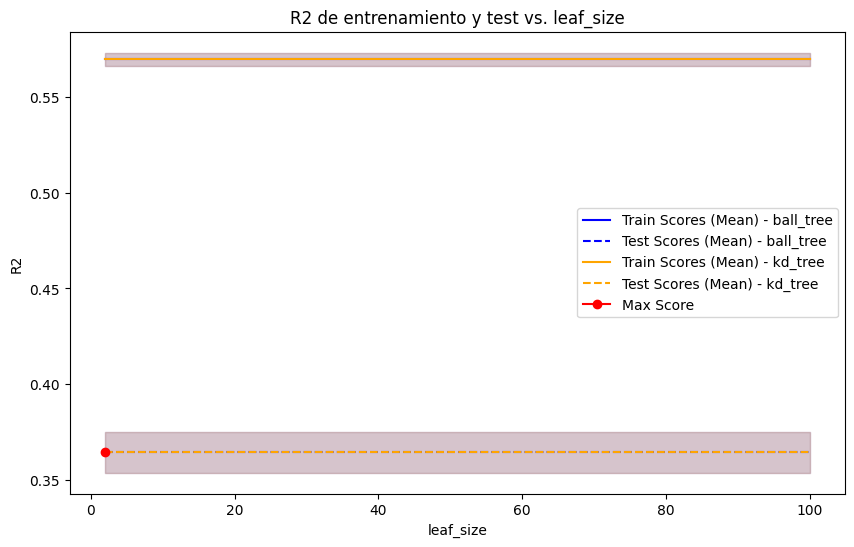

Valor óptimo de leaf_size: 2 para el algoritmo ball_tree


In [ ]:
# Gráfico
fig, ax = plt.subplots(figsize=(10, 6))

colors = ['blue', 'orange']
for k, algorithm in enumerate(algorithms):
    ax.plot(leaf_size_range, mean_train_scores[:, k], label=f"Train Scores (Mean) - {algorithm}", color=colors[k])
    ax.fill_between(leaf_size_range, mean_train_scores[:, k] - std_train_scores[:, k], mean_train_scores[:, k] + std_train_scores[:, k], alpha=0.2, color=colors[k])
    ax.plot(leaf_size_range, mean_test_scores[:, k], label=f"Test Scores (Mean) - {algorithm}", linestyle='dashed', color=colors[k])
    ax.fill_between(leaf_size_range, mean_test_scores[:, k] - std_test_scores[:, k], mean_test_scores[:, k] + std_test_scores[:, k], alpha=0.2, color=colors[k])

# Mejor valor de test score
best_idx = np.unravel_index(np.argmax(mean_test_scores, axis=None), mean_test_scores.shape)
best_leaf_size = leaf_size_range[best_idx[0]]
best_algorithm = algorithms[best_idx[1]]
best_test_score = mean_test_scores[best_idx]

ax.plot(best_leaf_size, best_test_score, marker='o', color="red", label="Max Score")

ax.set_ylabel("R2")
ax.set_xlabel("leaf_size")
ax.set_title("R2 de entrenamiento y test vs. leaf_size")
plt.legend()
plt.show()

print(f"Valor óptimo de leaf_size: {best_leaf_size} para el algoritmo {best_algorithm}")

##### Grid manual y refinamiento

In [ ]:
n_executions = 100
best_r2 = -float('inf')
best_std = None
best_n_neighbors = None
best_weights = None
best_metric = None

n_neighbors_values = range(2, 41, 1)
weights_values = ['uniform', 'distance']
metric_values = [{'name': 'manhattan'}, {'name': 'euclidean'}, {'name': 'minkowski', 'p_values': range(1, 6)}]

results_df = pd.DataFrame(columns=['n_neighbors', 'weights', 'metric', 'p', 'mean_train_r2', 'std_train_r2', 'mean_test_r2', 'std_test_r2'])

for n_neighbors in n_neighbors_values:
    for weights in weights_values:
        for metric in metric_values:
            if metric['name'] == 'minkowski':
                for p in metric['p_values']:
                    train_r2_values = []
                    test_r2_values = []

                    for i in range(n_executions):
                        random_state = i + 1

                        x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

                        min_max_scaler = MinMaxScaler()
                        min_max_scaler.fit(x_train)
                        x_train = min_max_scaler.transform(x_train)
                        x_test = min_max_scaler.transform(x_test)

                        modelo = KNeighborsRegressor(n_neighbors=n_neighbors, weights=weights, metric=metric['name'], p=p)
                        modelo.fit(x_train, y_train)

                        train_r2 = modelo.score(x_train, y_train)
                        test_r2 = modelo.score(x_test, y_test)

                        train_r2_values.append(train_r2)
                        test_r2_values.append(test_r2)

                    mean_train_r2 = np.mean(train_r2_values)
                    std_train_r2 = np.std(train_r2_values)/(n_executions**0.5)

                    mean_test_r2 = np.mean(test_r2_values)
                    std_test_r2 = np.std(test_r2_values)/(n_executions**0.5)

                    result = {'n_neighbors': n_neighbors,
                              'weights': weights,
                              'metric': metric['name'],
                              'p': p,
                              'mean_train_r2': mean_train_r2,
                              'std_train_r2': std_train_r2,
                              'mean_test_r2': mean_test_r2,
                              'std_test_r2': std_test_r2}

                    temp_df = pd.DataFrame([result])
                    pd.set_option('display.width', 1000)
                    print(temp_df)
                    print()

                    results_df = pd.concat([results_df, temp_df], ignore_index=True)
            else:
                train_r2_values = []
                test_r2_values = []

                for i in range(n_executions):
                    random_state = i + 1

                    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

                    min_max_scaler = MinMaxScaler()
                    min_max_scaler.fit(x_train)
                    x_train = min_max_scaler.transform(x_train)
                    x_test = min_max_scaler.transform(x_test)

                    modelo = KNeighborsRegressor(n_neighbors=n_neighbors, weights=weights, metric=metric['name'])
                    modelo.fit(x_train, y_train)

                    train_r2 = modelo.score(x_train, y_train)
                    test_r2 = modelo.score(x_test, y_test)

                    train_r2_values.append(train_r2)
                    test_r2_values.append(test_r2)

                mean_train_r2 = np.mean(train_r2_values)
                std_train_r2 = np.std(train_r2_values)/(n_executions**0.5)

                mean_test_r2 = np.mean(test_r2_values)
                std_test_r2 = np.std(test_r2_values)/(n_executions**0.5)

                result = {'n_neighbors': n_neighbors,
                          'weights': weights,
                          'metric': metric['name'],
                          'p': None,
                          'mean_train_r2': mean_train_r2,
                          'std_train_r2': std_train_r2,
                          'mean_test_r2': mean_test_r2,
                          'std_test_r2': std_test_r2}

                temp_df = pd.DataFrame([result])
                pd.set_option('display.width', 1000)
                print(temp_df)
                print()

                results_df = pd.concat([results_df, temp_df], ignore_index=True)

top_results = results_df.sort_values(by='mean_test_r2', ascending=False)

top_20_results = top_results.head(20)

print("Combinaciones de los 20 mejores resultados:")
print(top_20_results)

   n_neighbors  weights     metric     p  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            2  uniform  manhattan  None       0.778213      0.002235      0.285558     0.013033

   n_neighbors  weights     metric     p  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            2  uniform  euclidean  None       0.757689      0.002564       0.20728      0.01392

   n_neighbors  weights     metric  p  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            2  uniform  minkowski  1       0.778213      0.002235      0.285558     0.013033

   n_neighbors  weights     metric  p  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            2  uniform  minkowski  2       0.757689      0.002564       0.20728      0.01392

   n_neighbors  weights     metric  p  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            2  uniform  minkowski  3        0.76423      0.002473      0.189383      0.01511

   n_neighbors  weights     metric  p  mean

Prueba 2

In [ ]:
n_executions = 100
best_r2 = -float('inf')
best_std = None
best_n_neighbors = None
best_weights = None
best_metric = None

n_neighbors_values = range(2, 41, 1)
weights_values = ['uniform']
metric_values = [{'name': 'manhattan'}, {'name': 'euclidean'}, {'name': 'minkowski', 'p_values': range(1, 6)}]

results_df = pd.DataFrame(columns=['n_neighbors', 'weights', 'metric', 'p', 'mean_train_r2', 'std_train_r2', 'mean_test_r2', 'std_test_r2'])

for n_neighbors in n_neighbors_values:
    for weights in weights_values:
        for metric in metric_values:
            if metric['name'] == 'minkowski':
                for p in metric['p_values']:
                    train_r2_values = []
                    test_r2_values = []

                    for i in range(n_executions):
                        random_state = i + 1

                        x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

                        min_max_scaler = MinMaxScaler()
                        min_max_scaler.fit(x_train)
                        x_train = min_max_scaler.transform(x_train)
                        x_test = min_max_scaler.transform(x_test)

                        modelo = KNeighborsRegressor(n_neighbors=n_neighbors, weights=weights, metric=metric['name'], p=p)
                        modelo.fit(x_train, y_train)

                        train_r2 = modelo.score(x_train, y_train)
                        test_r2 = modelo.score(x_test, y_test)

                        train_r2_values.append(train_r2)
                        test_r2_values.append(test_r2)

                    mean_train_r2 = np.mean(train_r2_values)
                    std_train_r2 = np.std(train_r2_values)/(n_executions**0.5)

                    mean_test_r2 = np.mean(test_r2_values)
                    std_test_r2 = np.std(test_r2_values)/(n_executions**0.5)

                    result = {'n_neighbors': n_neighbors,
                              'weights': weights,
                              'metric': metric['name'],
                              'p': p,
                              'mean_train_r2': mean_train_r2,
                              'std_train_r2': std_train_r2,
                              'mean_test_r2': mean_test_r2,
                              'std_test_r2': std_test_r2}

                    temp_df = pd.DataFrame([result])
                    pd.set_option('display.width', 1000)
                    print(temp_df)
                    print()

                    results_df = pd.concat([results_df, temp_df], ignore_index=True)
            else:
                train_r2_values = []
                test_r2_values = []

                for i in range(n_executions):
                    random_state = i + 1

                    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

                    min_max_scaler = MinMaxScaler()
                    min_max_scaler.fit(x_train)
                    x_train = min_max_scaler.transform(x_train)
                    x_test = min_max_scaler.transform(x_test)

                    modelo = KNeighborsRegressor(n_neighbors=n_neighbors, weights=weights, metric=metric['name'])
                    modelo.fit(x_train, y_train)

                    train_r2 = modelo.score(x_train, y_train)
                    test_r2 = modelo.score(x_test, y_test)

                    train_r2_values.append(train_r2)
                    test_r2_values.append(test_r2)

                mean_train_r2 = np.mean(train_r2_values)
                std_train_r2 = np.std(train_r2_values)/(n_executions**0.5)

                mean_test_r2 = np.mean(test_r2_values)
                std_test_r2 = np.std(test_r2_values)/(n_executions**0.5)

                result = {'n_neighbors': n_neighbors,
                          'weights': weights,
                          'metric': metric['name'],
                          'p': None,
                          'mean_train_r2': mean_train_r2,
                          'std_train_r2': std_train_r2,
                          'mean_test_r2': mean_test_r2,
                          'std_test_r2': std_test_r2}

                temp_df = pd.DataFrame([result])
                pd.set_option('display.width', 1000)
                print(temp_df)
                print()

                results_df = pd.concat([results_df, temp_df], ignore_index=True)

top_results = results_df.sort_values(by='mean_test_r2', ascending=False)

top_100_results = top_results.head(100)

print("Combinaciones de los 100 mejores resultados:")
print(top_100_results)

   n_neighbors  weights     metric     p  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            2  uniform  manhattan  None       0.778213      0.002235      0.285558     0.013033

   n_neighbors  weights     metric     p  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            2  uniform  euclidean  None       0.757689      0.002564       0.20728      0.01392

   n_neighbors  weights     metric  p  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            2  uniform  minkowski  1       0.778213      0.002235      0.285558     0.013033

   n_neighbors  weights     metric  p  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            2  uniform  minkowski  2       0.757689      0.002564       0.20728      0.01392

   n_neighbors  weights     metric  p  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0            2  uniform  minkowski  3        0.76423      0.002473      0.189383      0.01511

   n_neighbors  weights     metric  p  mean

##### Análisis del modelo para *n_neighbors*

###### Para weights = distance

In [ ]:
n_executions = 100
neighbors_range = range(2,41,1)

train_scores = np.zeros((n_executions, len(neighbors_range)))
test_scores = np.zeros((n_executions, len(neighbors_range)))

for i in range(n_executions):
    random_state = i + 1

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    for j, n_neighbors in enumerate(neighbors_range):
        modelo = KNeighborsRegressor(n_neighbors=n_neighbors, weights='distance', metric='minkowski', p=1)
        modelo.fit(x_train, y_train)

        r2_train = modelo.score(x_train, y_train)
        train_scores[i, j] = r2_train

        r2_test = modelo.score(x_test, y_test)
        test_scores[i, j] = r2_test
    print(f"Iteration {i+1} completada")

mean_train_scores = np.mean(train_scores, axis=0)
std_train_scores = np.std(train_scores, axis=0) / (len(train_scores)**0.5)
mean_test_scores = np.mean(test_scores, axis=0)
std_test_scores = np.std(test_scores, axis=0) / (len(test_scores)**0.5)

print(std_train_scores)
print(std_test_scores)

Iteration 1 completada
Iteration 2 completada
Iteration 3 completada
Iteration 4 completada
Iteration 5 completada
Iteration 6 completada
Iteration 7 completada
Iteration 8 completada
Iteration 9 completada
Iteration 10 completada
Iteration 11 completada
Iteration 12 completada
Iteration 13 completada
Iteration 14 completada
Iteration 15 completada
Iteration 16 completada
Iteration 17 completada
Iteration 18 completada
Iteration 19 completada
Iteration 20 completada
Iteration 21 completada
Iteration 22 completada
Iteration 23 completada
Iteration 24 completada
Iteration 25 completada
Iteration 26 completada
Iteration 27 completada
Iteration 28 completada
Iteration 29 completada
Iteration 30 completada
Iteration 31 completada
Iteration 32 completada
Iteration 33 completada
Iteration 34 completada
Iteration 35 completada
Iteration 36 completada
Iteration 37 completada
Iteration 38 completada
Iteration 39 completada
Iteration 40 completada
Iteration 41 completada
Iteration 42 completada
I

In [ ]:
results_df = pd.DataFrame({
    'n_neighbors': neighbors_range,
    'mean_test_r2': mean_test_scores,
    'std_test_r2': std_test_scores
})

print("Tabla de resultados:")
print(results_df)

Tabla de resultados:
    n_neighbors  mean_test_r2  std_test_r2
0             2      0.307906     0.013099
1             3      0.368678     0.011783
2             4      0.407950     0.010836
3             5      0.428263     0.009652
4             6      0.439744     0.009225
5             7      0.446504     0.008880
6             8      0.449488     0.008019
7             9      0.452136     0.008035
8            10      0.456765     0.007893
9            11      0.459437     0.007900
10           12      0.459161     0.007860
11           13      0.461856     0.008237
12           14      0.463384     0.008347
13           15      0.463729     0.008141
14           16      0.465533     0.008331
15           17      0.465622     0.008395
16           18      0.465269     0.008456
17           19      0.463199     0.008463
18           20      0.462647     0.008482
19           21      0.460192     0.008523
20           22      0.457053     0.008519
21           23      0.452611    

In [ ]:
max_mean_test_r2 = results_df['mean_test_r2'].max()
std_dev = results_df.loc[results_df['mean_test_r2'].idxmax(), 'std_test_r2']

lower_bound = max_mean_test_r2 - std_dev
upper_bound = max_mean_test_r2 + std_dev

filtered_df = results_df[(results_df['mean_test_r2'] >= lower_bound) & (results_df['mean_test_r2'] <= upper_bound)]

filtered_df = filtered_df.sort_values(by='n_neighbors')

print("Valores de n_neighbors dentro del rango del máximo más menos una desviación estándar:")
for index, row in filtered_df.iterrows():
    print(f"n_neighbors: {row['n_neighbors']}, mean_test_r2: {row['mean_test_r2']}, std_test_r2: {row['std_test_r2']}")

Valores de n_neighbors dentro del rango del máximo más menos una desviación estándar:
n_neighbors: 11.0, mean_test_r2: 0.4594373296597977, std_test_r2: 0.007900035146975215
n_neighbors: 12.0, mean_test_r2: 0.4591606876408366, std_test_r2: 0.00786035711405978
n_neighbors: 13.0, mean_test_r2: 0.46185592268719255, std_test_r2: 0.008237085457175886
n_neighbors: 14.0, mean_test_r2: 0.4633843206993042, std_test_r2: 0.008346872121644469
n_neighbors: 15.0, mean_test_r2: 0.46372892953547323, std_test_r2: 0.00814071549420171
n_neighbors: 16.0, mean_test_r2: 0.46553293236901566, std_test_r2: 0.008331092449667453
n_neighbors: 17.0, mean_test_r2: 0.465622283634503, std_test_r2: 0.008394600785818178
n_neighbors: 18.0, mean_test_r2: 0.46526881929374364, std_test_r2: 0.008455770004941899
n_neighbors: 19.0, mean_test_r2: 0.46319940988756103, std_test_r2: 0.008463379209726138
n_neighbors: 20.0, mean_test_r2: 0.46264674059480904, std_test_r2: 0.008482255184738401
n_neighbors: 21.0, mean_test_r2: 0.460192

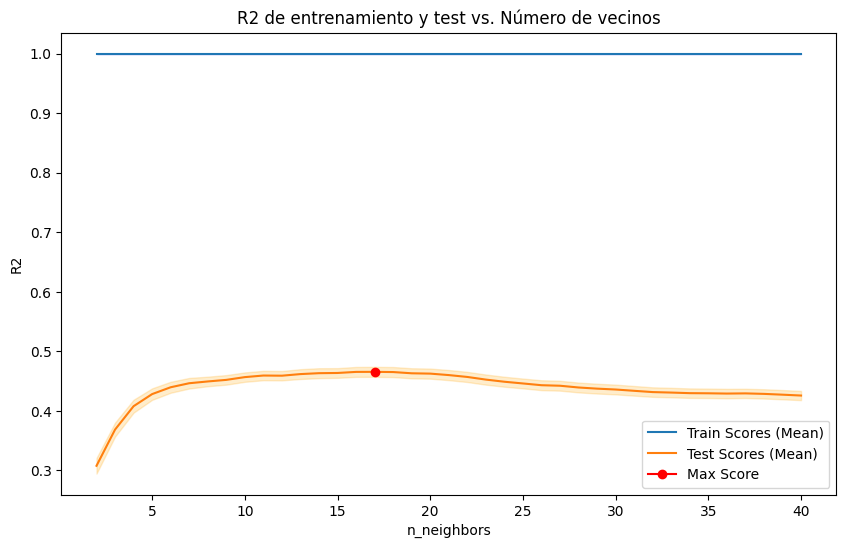

Valor óptimo de n_neighbors: 17


In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))

ax.plot(neighbors_range, mean_train_scores, label="Train Scores (Mean)")
ax.fill_between(neighbors_range, mean_train_scores - std_train_scores, mean_train_scores + std_train_scores, alpha=0.2, color='blue')
ax.plot(neighbors_range, mean_test_scores, label="Test Scores (Mean)")
ax.fill_between(neighbors_range, mean_test_scores - std_test_scores, mean_test_scores + std_test_scores, alpha=0.2, color='orange')

best_n_neighbors = neighbors_range[np.argmax(mean_test_scores)]
best_test_score = np.max(mean_test_scores)
ax.plot(best_n_neighbors, best_test_score, marker='o', color="red", label="Max Score")

ax.set_ylabel("R2")
ax.set_xlabel("n_neighbors")
ax.set_title("R2 de entrenamiento y test vs. Número de vecinos")
plt.legend()
plt.show()

print(f"Valor óptimo de n_neighbors: {best_n_neighbors}")

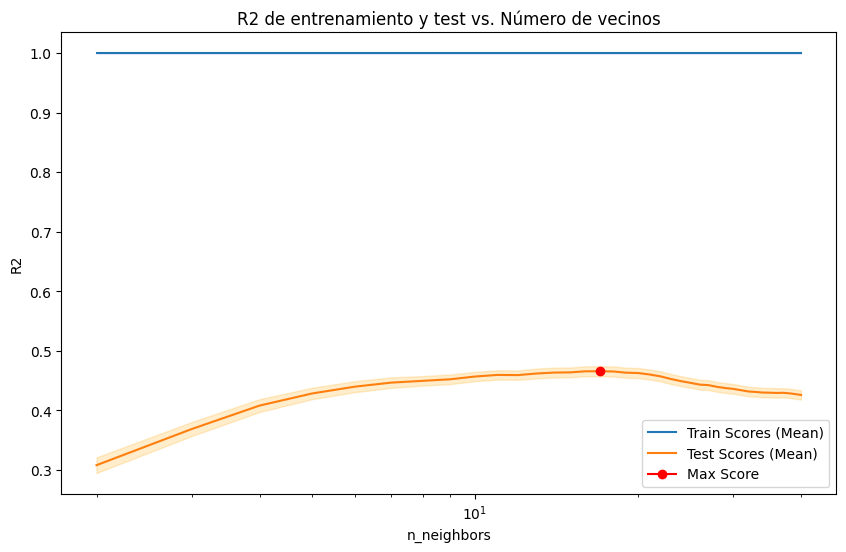

Valor óptimo de n_neighbors: 17


In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))

ax.plot(neighbors_range, mean_train_scores, label="Train Scores (Mean)")
ax.fill_between(neighbors_range, mean_train_scores - std_train_scores, mean_train_scores + std_train_scores, alpha=0.2, color='blue')
ax.plot(neighbors_range, mean_test_scores, label="Test Scores (Mean)")
ax.fill_between(neighbors_range, mean_test_scores - std_test_scores, mean_test_scores + std_test_scores, alpha=0.2, color='orange')

best_n_neighbors = neighbors_range[np.argmax(mean_test_scores)]
best_test_score = np.max(mean_test_scores)
ax.plot(best_n_neighbors, best_test_score, marker='o', color="red", label="Max Score")

ax.set_ylabel("R2")
ax.set_xlabel("n_neighbors")
ax.set_title("R2 de entrenamiento y test vs. Número de vecinos")

plt.xscale('log')

plt.legend()
plt.show()

print(f"Valor óptimo de n_neighbors: {best_n_neighbors}")

###### Para weights = uniform

In [ ]:
n_executions = 100
neighbors_range = range(2,41,1)

train_scores = np.zeros((n_executions, len(neighbors_range)))
test_scores = np.zeros((n_executions, len(neighbors_range)))

for i in range(n_executions):
    random_state = i + 1

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    for j, n_neighbors in enumerate(neighbors_range):
        modelo = KNeighborsRegressor(n_neighbors=n_neighbors, weights='uniform', metric='minkowski', p=1)
        modelo.fit(x_train, y_train)

        r2_train = modelo.score(x_train, y_train)
        train_scores[i, j] = r2_train

        r2_test = modelo.score(x_test, y_test)
        test_scores[i, j] = r2_test
    print(f"Iteration {i+1} completada")


mean_train_scores = np.mean(train_scores, axis=0)
std_train_scores = np.std(train_scores, axis=0) / (len(train_scores)**0.5)
mean_test_scores = np.mean(test_scores, axis=0)
std_test_scores = np.std(test_scores, axis=0) / (len(test_scores)**0.5)

print(std_train_scores)
print(std_test_scores)

Iteration 1 completada
Iteration 2 completada
Iteration 3 completada
Iteration 4 completada
Iteration 5 completada
Iteration 6 completada
Iteration 7 completada
Iteration 8 completada
Iteration 9 completada
Iteration 10 completada
Iteration 11 completada
Iteration 12 completada
Iteration 13 completada
Iteration 14 completada
Iteration 15 completada
Iteration 16 completada
Iteration 17 completada
Iteration 18 completada
Iteration 19 completada
Iteration 20 completada
Iteration 21 completada
Iteration 22 completada
Iteration 23 completada
Iteration 24 completada
Iteration 25 completada
Iteration 26 completada
Iteration 27 completada
Iteration 28 completada
Iteration 29 completada
Iteration 30 completada
Iteration 31 completada
Iteration 32 completada
Iteration 33 completada
Iteration 34 completada
Iteration 35 completada
Iteration 36 completada
Iteration 37 completada
Iteration 38 completada
Iteration 39 completada
Iteration 40 completada
Iteration 41 completada
Iteration 42 completada
I

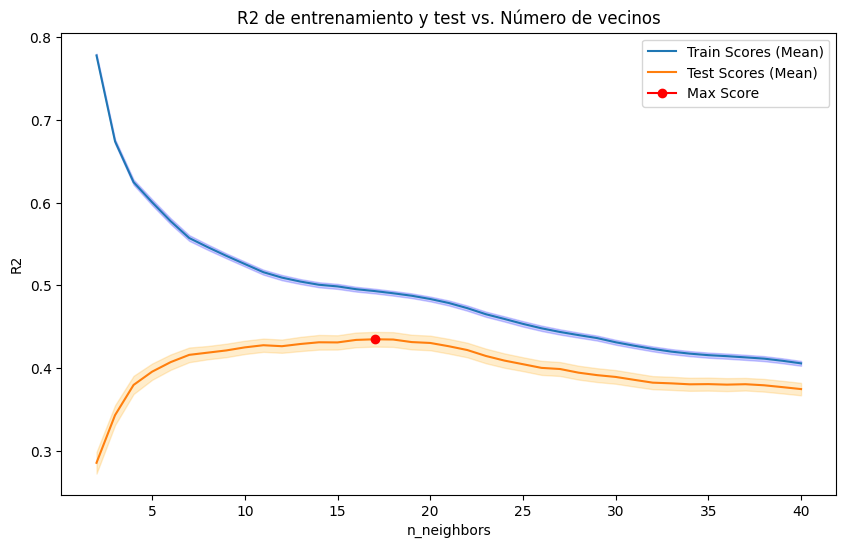

Valor óptimo de n_neighbors: 17


In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))

ax.plot(neighbors_range, mean_train_scores, label="Train Scores (Mean)")
ax.fill_between(neighbors_range, mean_train_scores - std_train_scores, mean_train_scores + std_train_scores, alpha=0.2, color='blue')
ax.plot(neighbors_range, mean_test_scores, label="Test Scores (Mean)")
ax.fill_between(neighbors_range, mean_test_scores - std_test_scores, mean_test_scores + std_test_scores, alpha=0.2, color='orange')

best_n_neighbors = neighbors_range[np.argmax(mean_test_scores)]
best_test_score = np.max(mean_test_scores)
ax.plot(best_n_neighbors, best_test_score, marker='o', color="red", label="Max Score")

ax.set_ylabel("R2")
ax.set_xlabel("n_neighbors")
ax.set_title("R2 de entrenamiento y test vs. Número de vecinos")
plt.legend()
plt.show()

print(f"Valor óptimo de n_neighbors: {best_n_neighbors}")

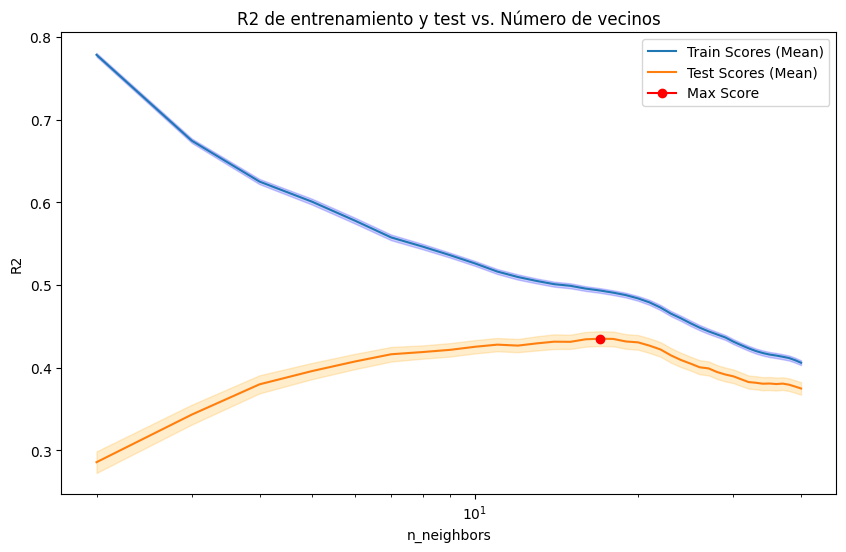

Valor óptimo de n_neighbors: 17


In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))

ax.plot(neighbors_range, mean_train_scores, label="Train Scores (Mean)")
ax.fill_between(neighbors_range, mean_train_scores - std_train_scores, mean_train_scores + std_train_scores, alpha=0.2, color='blue')
ax.plot(neighbors_range, mean_test_scores, label="Test Scores (Mean)")
ax.fill_between(neighbors_range, mean_test_scores - std_test_scores, mean_test_scores + std_test_scores, alpha=0.2, color='orange')

best_n_neighbors = neighbors_range[np.argmax(mean_test_scores)]
best_test_score = np.max(mean_test_scores)
ax.plot(best_n_neighbors, best_test_score, marker='o', color="red", label="Max Score")

ax.set_ylabel("R2")
ax.set_xlabel("n_neighbors")
ax.set_title("R2 de entrenamiento y test vs. Número de vecinos")

plt.xscale('log')

plt.legend()
plt.show()

print(f"Valor óptimo de n_neighbors: {best_n_neighbors}")

#### Evaluación del modelo

###### Coeficiente de determinación $R^2$

In [ ]:
n_executions = 100  # Número de iteraciones con diferentes random_state

r2_train_scores = []
r2_test_scores = []

for random_state in range(1, n_executions + 1):

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)
    modelk=KNeighborsRegressor(n_neighbors=17, weights='distance', metric='minkowski',p=1.0)
    modelk.fit(x_train, y_train)

    r2_train = modelk.score(x_train, y_train)
    r2_test = modelk.score(x_test, y_test)

    r2_train_scores.append(r2_train)
    r2_test_scores.append(r2_test)


mean_r2_train = np.mean(r2_train_scores)
std_r2_train = np.std(r2_train_scores)/ (n_executions**0.5)
mean_r2_test = np.mean(r2_test_scores)
std_r2_test = np.std(r2_test_scores)/ (n_executions**0.5)

print(f"R2 promedio (train): {mean_r2_train:.5f} ± {std_r2_train:.5f}")
print(f"R2 promedio (test): {mean_r2_test:.5f} ± {std_r2_test:.5f}")

R2 promedio (train): 1.00000 ± 0.00000
R2 promedio (test): 0.46562 ± 0.00839


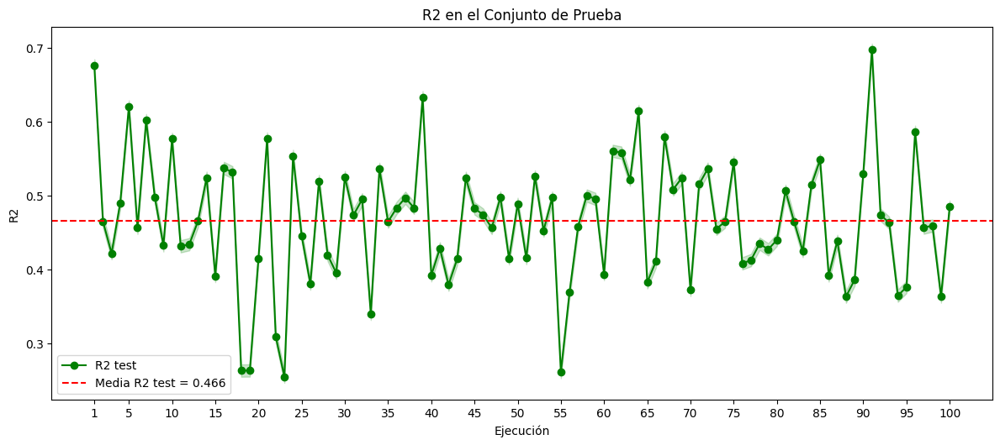

In [ ]:
plt.figure(figsize=(12, 10))

plt.subplot(2, 1, 2)
plt.plot(range(1, n_executions + 1), r2_test_scores, marker='o', linestyle='-', color='green', label='R2 test')
plt.axhline(y=mean_r2_test, color='r', linestyle='--', label=f'Media R2 test = {mean_r2_test:.3f}')
plt.fill_between(range(1, n_executions + 1),
                 np.array(r2_test_scores) - std_r2_test,
                 np.array(r2_test_scores) + std_r2_test,
                 color='green', alpha=0.2)
plt.xlabel('Ejecución')
plt.xticks([1] + [i for i in range(1, n_executions + 1) if i % 5 == 0])
plt.ylabel('R2')
plt.title('R2 en el Conjunto de Prueba')
plt.legend()

plt.tight_layout()
plt.show()

##### Evaluación de predicciones

In [ ]:
r2_test_values = []

for i in range(n_executions):
    random_state = i + 1

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    modelk = KNeighborsRegressor(n_neighbors=17, weights='distance', metric='minkowski',p=1.0)
    modelk.fit(x_train, y_train)

    r2_test = modelk.score(x_test, y_test)
    r2_test_values.append(r2_test)

mean_r2_test = np.mean(r2_test_values)

print(f"R2 Test Promedio: {mean_r2_test:.5f}")

index_closest_to_mean = np.argmin(np.abs(np.array(r2_test_values) - mean_r2_test))
closest_random_state = index_closest_to_mean + 1
closest_r2 = r2_test_values[index_closest_to_mean]

print(f"Random State más cercano al R2 Test Promedio: {closest_random_state}")
print(f"R2 correspondiente: {closest_r2:.5f}")

R2 Test Promedio: 0.46562
Random State más cercano al R2 Test Promedio: 13
R2 correspondiente: 0.46527


In [ ]:
x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=13)
min_max_scaler = MinMaxScaler()
min_max_scaler.fit(x_train)
x_train = min_max_scaler.transform(x_train)
x_test = min_max_scaler.transform(x_test)
modelk = KNeighborsRegressor(n_neighbors=17, weights='distance', metric='minkowski',p=1.0)
modelk.fit(x_train, y_train)
y_predict_train = modelk.predict(x_train)
y_predict_test = modelk.predict(x_test)

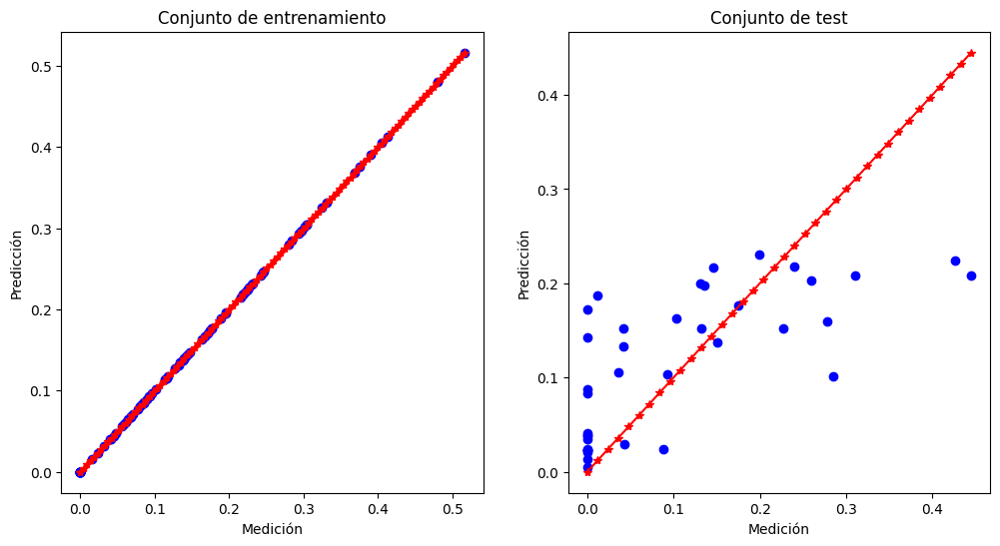

In [ ]:
y_train = np.maximum(y_train, 0)
y_predict_train = np.maximum(y_predict_train, 0)

y_test = np.maximum(y_test, 0)
y_predict_test = np.maximum(y_predict_test, 0)

x = np.linspace(min(min(y_train), min(y_predict_train)), max(max(y_train), max(y_predict_train)), len(y_train))

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.scatter(y_train, y_predict_train, c='blue')
plt.plot(x,x,'r*-')
plt.xlabel("Gravedad real")
plt.ylabel("Gravedad predicha")
plt.title ("Conjunto de entrenamiento")

x = np.linspace(min(min(y_test), min(y_predict_test)), max(max(y_test), max(y_predict_test)), len(y_test))

plt.subplot(1,2,2)
plt.scatter(y_test, y_predict_test, c='blue')
plt.plot(x,x,'r*-')
plt.xlabel("Gravedad real")
plt.ylabel("Gravedad predicha")
plt.title("Conjunto de test")
plt.show()

##### Evaluación de clasificación: normal o patológico

In [ ]:
n_executions = 100

precision_train_scores = []
recall_train_scores = []
f1_train_scores = []
accuracy_train_scores = []

precision_test_scores = []
recall_test_scores = []
f1_test_scores = []
accuracy_test_scores = []


for random_state in range(1, n_executions + 1):

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)
    model = KNeighborsRegressor(n_neighbors=17, weights='distance', metric='minkowski',p=1.0)

    model.fit(x_train, y_train)

    y_predict_train = model.predict(x_train)
    y_predict_test = model.predict(x_test)

    y_train_bin = np.where(y_train > 0, 1, 0)
    y_test_bin = np.where(y_test > 0, 1, 0)
    y_predict_train_bin = np.where(y_predict_train > 0, 1, 0)
    y_predict_test_bin = np.where(y_predict_test > 0, 1, 0)

    precision_train = precision_score(y_train_bin, y_predict_train_bin)
    recall_train = recall_score(y_train_bin, y_predict_train_bin)
    f1_train = f1_score(y_train_bin, y_predict_train_bin)
    accuracy_train = accuracy_score(y_train_bin, y_predict_train_bin)

    precision_test = precision_score(y_test_bin, y_predict_test_bin)
    recall_test = recall_score(y_test_bin, y_predict_test_bin)
    f1_test = f1_score(y_test_bin, y_predict_test_bin)
    accuracy_test = accuracy_score(y_test_bin, y_predict_test_bin)

    precision_train_scores.append(precision_train)
    recall_train_scores.append(recall_train)
    f1_train_scores.append(f1_train)
    accuracy_train_scores.append(accuracy_train)

    precision_test_scores.append(precision_test)
    recall_test_scores.append(recall_test)
    f1_test_scores.append(f1_test)
    accuracy_test_scores.append(accuracy_test)

mean_precision_train = np.mean(precision_train_scores)
std_precision_train = np.std(precision_train_scores)/ (n_executions**0.5)
mean_recall_train = np.mean(recall_train_scores)
std_recall_train = np.std(recall_train_scores)/ (n_executions**0.5)
mean_f1_train = np.mean(f1_train_scores)
std_f1_train = np.std(f1_train_scores)/ (n_executions**0.5)
mean_accuracy_train = np.mean(accuracy_train_scores)
std_accuracy_train = np.std(accuracy_train_scores)/ (n_executions**0.5)

mean_precision_test = np.mean(precision_test_scores)
std_precision_test = np.std(precision_test_scores)/ (n_executions**0.5)
mean_recall_test = np.mean(recall_test_scores)
std_recall_test = np.std(recall_test_scores)/ (n_executions**0.5)
mean_f1_test = np.mean(f1_test_scores)
std_f1_test = np.std(f1_test_scores)/(n_executions**0.5)
mean_accuracy_test = np.mean(accuracy_test_scores)
std_accuracy_test = np.std(accuracy_test_scores)/ (n_executions**0.5)

print("Conjunto de entrenamiento:")
print(f"Precisión: {mean_precision_train:.5f} ± {std_precision_train:.5f}")
print(f"Recall: {mean_recall_train:.5f} ± {std_recall_train:.5f}")
print(f"F1-Score: {mean_f1_train:.5f} ± {std_f1_train:.5f}")
print(f"Exactitud: {mean_accuracy_train:.5f} ± {std_accuracy_train:.5f}")

print("\nConjunto de test:")
print(f"Precisión: {mean_precision_test:.5f} ± {std_precision_test:.5f}")
print(f"Recall: {mean_recall_test:.5f} ± {std_recall_test:.5f}")
print(f"F1-Score: {mean_f1_test:.5f} ± {std_f1_test:.5f}")
print(f"Exactitud: {mean_accuracy_test:.5f} ± {std_accuracy_test:.5f}")

Conjunto de entrenamiento:
Precisión: 1.00000 ± 0.00000
Recall: 1.00000 ± 0.00000
F1-Score: 1.00000 ± 0.00000
Exactitud: 1.00000 ± 0.00000

Conjunto de test:
Precisión: 0.66336 ± 0.00717
Recall: 1.00000 ± 0.00000
F1-Score: 0.79536 ± 0.00525
Exactitud: 0.66342 ± 0.00718


### SUPPORT VECTOR REGRESSION

#### Optimización de hiperparámetros

##### Kernels

##### Grid manual

In [ ]:
n_executions = 100
best_r2 = -float('inf')
best_std = None
best_C = None
best_epsilon = None
best_kernel = None

C_values = [0.01, 0.1, 1, 10, 100]
epsilon_values = [0.01, 0.1, 0.5, 1, 2]
kernel_values = [{'name': 'linear'}, {'name': 'rbf'}, {'name': 'poly', 'degree_values': range(2, 6)}]

results_df = pd.DataFrame(columns=['C', 'epsilon', 'kernel', 'degree', 'mean_train_r2', 'std_train_r2', 'mean_test_r2', 'std_test_r2'])

for C in C_values:
    for epsilon in epsilon_values:
        for kernel in kernel_values:
            if kernel['name'] == 'poly':
                for degree in kernel['degree_values']:
                    train_r2_values = []
                    test_r2_values = []

                    for i in range(n_executions):
                        random_state = i + 1

                        x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

                        min_max_scaler = MinMaxScaler()
                        min_max_scaler.fit(x_train)
                        x_train = min_max_scaler.transform(x_train)
                        x_test = min_max_scaler.transform(x_test)

                        modelo = SVR(C=C, epsilon=epsilon, kernel=kernel['name'], degree=degree)
                        modelo.fit(x_train, y_train)

                        train_r2 = modelo.score(x_train, y_train)
                        test_r2 = modelo.score(x_test, y_test)

                        train_r2_values.append(train_r2)
                        test_r2_values.append(test_r2)

                    mean_train_r2 = np.mean(train_r2_values)
                    std_train_r2 = np.std(train_r2_values)/(n_executions**0.5)

                    mean_test_r2 = np.mean(test_r2_values)
                    std_test_r2 = np.std(test_r2_values)/(n_executions**0.5)

                    result = {'C': C,
                              'epsilon': epsilon,
                              'kernel': kernel['name'],
                              'degree': degree,
                              'mean_train_r2': mean_train_r2,
                              'std_train_r2': std_train_r2,
                              'mean_test_r2': mean_test_r2,
                              'std_test_r2': std_test_r2}

                    temp_df = pd.DataFrame([result])
                    pd.set_option('display.width', 1000)
                    print(temp_df)
                    print()

                    results_df = pd.concat([results_df, temp_df], ignore_index=True)
            else:
                train_r2_values = []
                test_r2_values = []

                for i in range(n_executions):
                    random_state = i + 1

                    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

                    min_max_scaler = MinMaxScaler()
                    min_max_scaler.fit(x_train)
                    x_train = min_max_scaler.transform(x_train)
                    x_test = min_max_scaler.transform(x_test)

                    modelo = SVR(C=C, epsilon=epsilon, kernel=kernel['name'])
                    modelo.fit(x_train, y_train)

                    train_r2 = modelo.score(x_train, y_train)
                    test_r2 = modelo.score(x_test, y_test)

                    train_r2_values.append(train_r2)
                    test_r2_values.append(test_r2)

                mean_train_r2 = np.mean(train_r2_values)
                std_train_r2 = np.std(train_r2_values)/(n_executions**0.5)

                mean_test_r2 = np.mean(test_r2_values)
                std_test_r2 = np.std(test_r2_values)/(n_executions**0.5)

                result = {'C': C,
                          'epsilon': epsilon,
                          'kernel': kernel['name'],
                          'degree': None,
                          'mean_train_r2': mean_train_r2,
                          'std_train_r2': std_train_r2,
                          'mean_test_r2': mean_test_r2,
                          'std_test_r2': std_test_r2}

                temp_df = pd.DataFrame([result])
                pd.set_option('display.width', 1000)
                print(temp_df)
                print()

                results_df = pd.concat([results_df, temp_df], ignore_index=True)

top_results = results_df.sort_values(by='mean_test_r2', ascending=False)

top_20_results = top_results.head(20)

print("Combinaciones de los 20 mejores resultados:")
print(top_20_results)

      C  epsilon  kernel degree  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0  0.01     0.01  linear   None       0.486116      0.003589      0.444471     0.008844

      C  epsilon kernel degree  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0  0.01     0.01    rbf   None       0.321448      0.003285      0.255472     0.011094

      C  epsilon kernel  degree  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0  0.01     0.01   poly       2       0.453842      0.003744       0.38592     0.009933

      C  epsilon kernel  degree  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0  0.01     0.01   poly       3       0.499656        0.0043      0.388796     0.010635

      C  epsilon kernel  degree  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0  0.01     0.01   poly       4       0.543254      0.004285      0.383708     0.010986

      C  epsilon kernel  degree  mean_train_r2  std_train_r2  mean_test_r2  std_test_r2
0  0.01     0.01   poly      

##### Refinamiento

In [ ]:
C_values = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1.1, 1.2, 90, 100, 110]
epsilon_values = [0.01, 0.02, 0.03, 0.04, 0.05] + [i * 0.1 for i in range(1, 11)]

top_results = []

epsilon_range = epsilon_values

n_executions = 100

for kernel in ['linear', 'rbf']:
    for epsilon in epsilon_range:
        for C in C_values:
            train_r2_values = []
            test_r2_values = []

            for i in range(n_executions):
                random_state = i + 1

                x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

                min_max_scaler = MinMaxScaler()
                min_max_scaler.fit(x_train)
                x_train = min_max_scaler.transform(x_train)
                x_test = min_max_scaler.transform(x_test)

                modelo = SVR(kernel=kernel, epsilon=epsilon, C=C)
                modelo.fit(x_train, y_train)

                y_train_pred = modelo.predict(x_train)
                r2_train = r2_score(y_train, y_train_pred)
                train_r2_values.append(r2_train)

                y_test_pred = modelo.predict(x_test)
                r2_test = r2_score(y_test, y_test_pred)
                test_r2_values.append(r2_test)

            mean_train_r2 = np.mean(train_r2_values)
            std_train_r2 = np.std(train_r2_values)/(n_executions**0.5)
            mean_test_r2 = np.mean(test_r2_values)
            std_test_r2 = np.std(test_r2_values)/(n_executions**0.5)

            top_results.append({'Kernel': kernel,
                                'C': C,
                                'Epsilon': epsilon,
                                'Mean_Test_R2': mean_test_r2,
                                'Std_Test_R2': std_test_r2,
                                'Mean_Train_R2': mean_train_r2,
                                'Std_Train_R2': std_train_r2})

top_results.sort(key=lambda x: x['Mean_Test_R2'], reverse=True)

top_20_results = top_results[:20]

top_20_df = pd.DataFrame(top_20_results)

print(top_20_df)

    Kernel    C  Epsilon  Mean_Test_R2  Std_Test_R2  Mean_Train_R2  Std_Train_R2
0   linear  0.1     0.03      0.551196     0.008462       0.602322      0.002857
1   linear  0.2     0.03      0.550185     0.008628       0.605125      0.002883
2   linear  0.2     0.04      0.549377     0.008507       0.611537      0.002750
3   linear  0.3     0.04      0.549026     0.008541       0.613066      0.002760
4   linear  0.1     0.04      0.548645     0.008312       0.606718      0.002835
5   linear  0.3     0.03      0.548596     0.008674       0.605932      0.002887
6   linear  0.4     0.03      0.548243     0.008765       0.606064      0.002882
7   linear  0.4     0.04      0.548078     0.008515       0.613757      0.002759
8   linear  0.5     0.03      0.547883     0.008834       0.606134      0.002885
9   linear  0.6     0.03      0.547869     0.008939       0.606158      0.002892
10  linear  0.7     0.03      0.547618     0.008966       0.606195      0.002893
11  linear  0.5     0.04    

In [ ]:
n_executions = 100

C_values = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1.1, 1.2, 90, 100, 110]
epsilon_values = [0.01, 0.02, 0.03, 0.04, 0.05] + [i * 0.1 for i in range(1, 11)]

top_results = []

epsilon_range = epsilon_values

for kernel in ['linear', 'rbf']:
    for epsilon in epsilon_range:
        for C in C_values:
            train_r2_values = []
            test_r2_values = []

            for i in range(n_executions):
                random_state = i + 1

                x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

                min_max_scaler = MinMaxScaler()
                min_max_scaler.fit(x_train)
                x_train = min_max_scaler.transform(x_train)
                x_test = min_max_scaler.transform(x_test)

                modelo = SVR(kernel=kernel, epsilon=epsilon, C=C)
                modelo.fit(x_train, y_train)

                y_train_pred = modelo.predict(x_train)
                r2_train = r2_score(y_train, y_train_pred)
                train_r2_values.append(r2_train)

                y_test_pred = modelo.predict(x_test)
                r2_test = r2_score(y_test, y_test_pred)
                test_r2_values.append(r2_test)

            mean_train_r2 = np.mean(train_r2_values)
            std_train_r2 = np.std(train_r2_values)/(n_executions**0.5)
            mean_test_r2 = np.mean(test_r2_values)
            std_test_r2 = np.std(test_r2_values)/(n_executions**0.5)

            top_results.append({'Kernel': kernel,
                                'C': C,
                                'Epsilon': epsilon,
                                'Mean_Test_R2': mean_test_r2,
                                'Std_Test_R2': std_test_r2})

top_results.sort(key=lambda x: x['Mean_Test_R2'], reverse=True)

top_10_results = top_results[:10]

top_10_df = pd.DataFrame(top_10_results)

print(top_10_df)

   Kernel    C  Epsilon  Mean_Test_R2  Std_Test_R2
0  linear  0.1     0.03      0.551196     0.008462
1  linear  0.2     0.03      0.550185     0.008628
2  linear  0.2     0.04      0.549377     0.008507
3  linear  0.3     0.04      0.549026     0.008541
4  linear  0.1     0.04      0.548645     0.008312
5  linear  0.3     0.03      0.548596     0.008674
6  linear  0.4     0.03      0.548243     0.008765
7  linear  0.4     0.04      0.548078     0.008515
8  linear  0.5     0.03      0.547883     0.008834
9  linear  0.6     0.03      0.547869     0.008939


##### Evaluación del modelo

###### Coeficiente de determinación $R^2$

In [ ]:
n_executions = 100

r2_train_scores = []
r2_test_scores = []

for random_state in range(1, n_executions + 1):

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)
    model = SVR(
            C = 0.1,
            epsilon=0.03,
            kernel='linear'
         )
    model.fit(x_train, y_train)

    r2_train = model.score(x_train, y_train)
    r2_test = model.score(x_test, y_test)

    r2_train_scores.append(r2_train)
    r2_test_scores.append(r2_test)


mean_r2_train = np.mean(r2_train_scores)
std_r2_train = np.std(r2_train_scores)/(n_executions**0.5)
mean_r2_test = np.mean(r2_test_scores)
std_r2_test = np.std(r2_test_scores)/(n_executions**0.5)

print(f"R2 promedio (train): {mean_r2_train:.5f} ± {std_r2_train:.5f}")
print(f"R2 promedio (test): {mean_r2_test:.5f} ± {std_r2_test:.5f}")

R2 promedio (train): 0.60232 ± 0.00286
R2 promedio (test): 0.55120 ± 0.00846


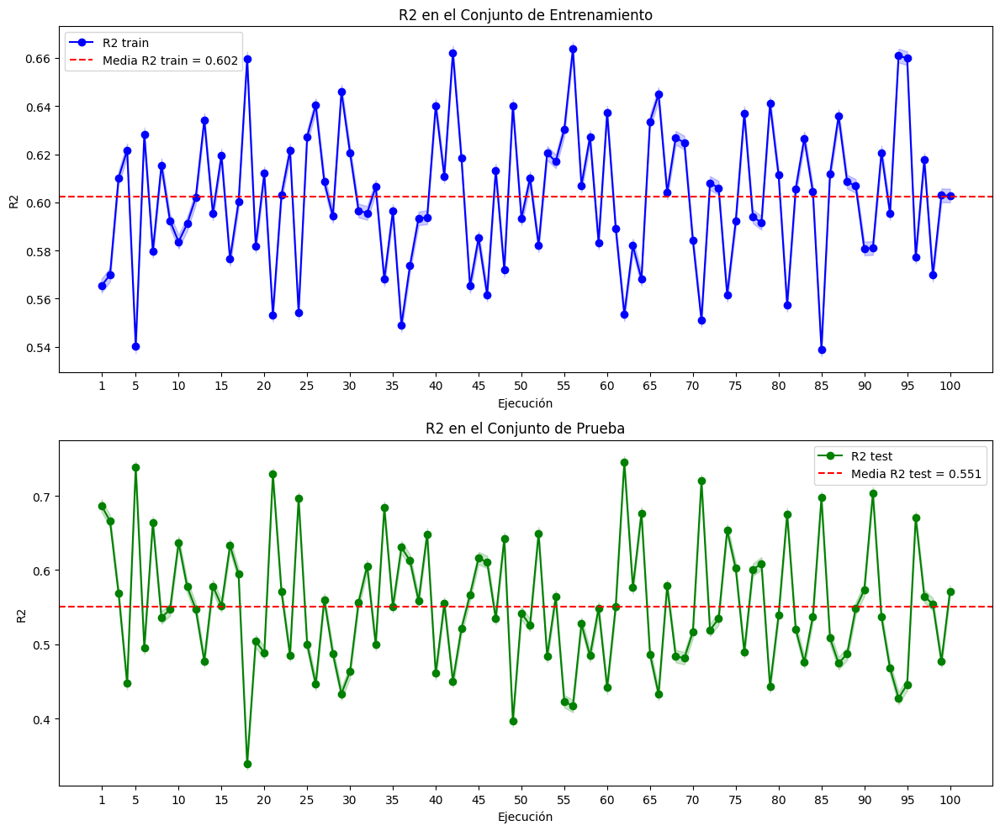

In [ ]:
plt.figure(figsize=(12, 10))

plt.subplot(2, 1, 1)
plt.plot(range(1, n_executions + 1), r2_train_scores, marker='o', linestyle='-', color='blue', label='R2 train')
plt.axhline(y=mean_r2_train, color='r', linestyle='--', label=f'Media R2 train = {mean_r2_train:.3f}')
plt.fill_between(range(1, n_executions + 1),
                 np.array(r2_train_scores) - std_r2_train,
                 np.array(r2_train_scores) + std_r2_train,
                 color='blue', alpha=0.2)
plt.xlabel('Ejecución')
plt.xticks([1] + [i for i in range(1, n_executions + 1) if i % 5 == 0])  # Más espacio en el eje x
plt.ylabel('R2')
plt.title('R2 en el Conjunto de Entrenamiento')
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(range(1, n_executions + 1), r2_test_scores, marker='o', linestyle='-', color='green', label='R2 test')
plt.axhline(y=mean_r2_test, color='r', linestyle='--', label=f'Media R2 test = {mean_r2_test:.3f}')
plt.fill_between(range(1, n_executions + 1),
                 np.array(r2_test_scores) - std_r2_test,
                 np.array(r2_test_scores) + std_r2_test,
                 color='green', alpha=0.2)
plt.xlabel('Ejecución')
plt.xticks([1] + [i for i in range(1, n_executions + 1) if i % 5 == 0])  # Más espacio en el eje x
plt.ylabel('R2')
plt.title('R2 en el Conjunto de Prueba')
plt.legend()

plt.tight_layout()
plt.show()

##### Evaluación de predicciones

In [ ]:
r2_test_values = []

for i in range(n_executions):
    random_state = i + 1

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    modelk = SVR(
            C = 0.1,
            epsilon=0.03,
            kernel='linear'
         )
    modelk.fit(x_train, y_train)

    r2_test = modelk.score(x_test, y_test)
    r2_test_values.append(r2_test)

mean_r2_test = np.mean(r2_test_values)

print(f"R2 Test Promedio: {mean_r2_test:.5f}")

index_closest_to_mean = np.argmin(np.abs(np.array(r2_test_values) - mean_r2_test))
closest_random_state = index_closest_to_mean + 1
closest_r2 = r2_test_values[index_closest_to_mean]

print(f"Random State más cercano al R2 Test Promedio: {closest_random_state}")
print(f"R2 correspondiente: {closest_r2:.5f}")

R2 Test Promedio: 0.55120
Random State más cercano al R2 Test Promedio: 61
R2 correspondiente: 0.55122


In [ ]:
x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=61)
min_max_scaler = MinMaxScaler()
min_max_scaler.fit(x_train)
x_train = min_max_scaler.transform(x_train)
x_test = min_max_scaler.transform(x_test)
model = SVR(
            C = 0.1,
            epsilon=0.03,
            kernel='linear'
         )
modelk.fit(x_train, y_train)
y_predict_train = modelk.predict(x_train)
y_predict_test = modelk.predict(x_test)

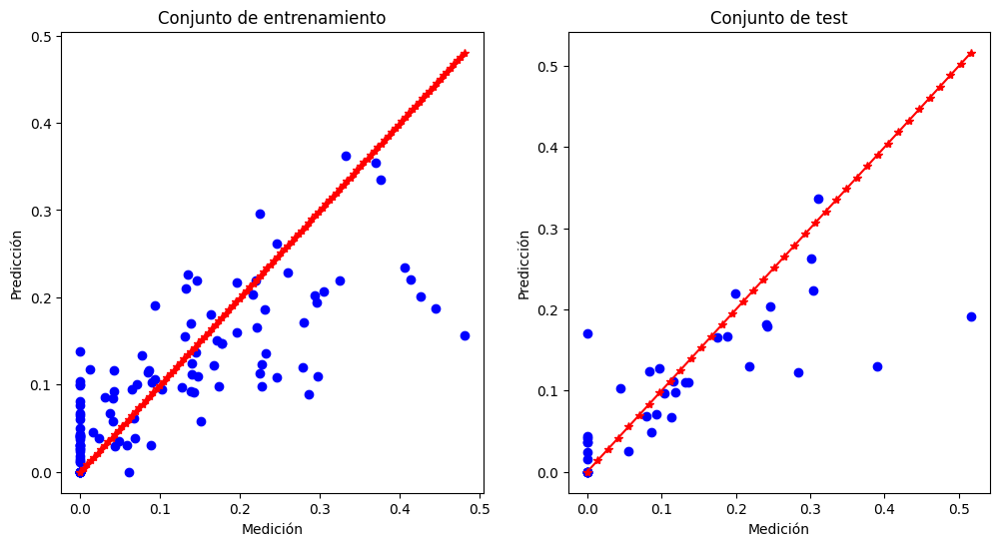

In [ ]:
y_train = np.maximum(y_train, 0)
y_predict_train = np.maximum(y_predict_train, 0)

y_test = np.maximum(y_test, 0)
y_predict_test = np.maximum(y_predict_test, 0)

x = np.linspace(min(min(y_train), min(y_predict_train)), max(max(y_train), max(y_predict_train)), len(y_train))

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.scatter(y_train, y_predict_train, c='blue')
plt.plot(x,x,'r*-')
plt.xlabel("Gravedad real")
plt.ylabel("Gravedad predicha")
plt.title ("Conjunto de entrenamiento")

x = np.linspace(min(min(y_test), min(y_predict_test)), max(max(y_test), max(y_predict_test)), len(y_test))

plt.subplot(1,2,2)
plt.scatter(y_test, y_predict_test, c='blue')
plt.plot(x,x,'r*-')
plt.xlabel("Gravedad real")
plt.ylabel("Gravedad predicha")
plt.title("Conjunto de test")
plt.show()

##### Evaluación de clasificación: normal o patológico

In [ ]:
n_executions = 100

precision_train_scores = []
recall_train_scores = []
f1_train_scores = []
accuracy_train_scores = []

precision_test_scores = []
recall_test_scores = []
f1_test_scores = []
accuracy_test_scores = []

for random_state in range(1, n_executions + 1):

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)
    model = SVR(
            C = 0.1,
            epsilon=0.03,
            kernel='linear'
         )

    model.fit(x_train, y_train)

    y_predict_train = model.predict(x_train)
    y_predict_test = model.predict(x_test)

    y_train_bin = np.where(y_train > 0, 1, 0)
    y_test_bin = np.where(y_test > 0, 1, 0)
    y_predict_train_bin = np.where(y_predict_train > 0, 1, 0)
    y_predict_test_bin = np.where(y_predict_test > 0, 1, 0)

    precision_train = precision_score(y_train_bin, y_predict_train_bin)
    recall_train = recall_score(y_train_bin, y_predict_train_bin)
    f1_train = f1_score(y_train_bin, y_predict_train_bin)
    accuracy_train = accuracy_score(y_train_bin, y_predict_train_bin)

    precision_test = precision_score(y_test_bin, y_predict_test_bin)
    recall_test = recall_score(y_test_bin, y_predict_test_bin)
    f1_test = f1_score(y_test_bin, y_predict_test_bin)
    accuracy_test = accuracy_score(y_test_bin, y_predict_test_bin)

    precision_train_scores.append(precision_train)
    recall_train_scores.append(recall_train)
    f1_train_scores.append(f1_train)
    accuracy_train_scores.append(accuracy_train)

    precision_test_scores.append(precision_test)
    recall_test_scores.append(recall_test)
    f1_test_scores.append(f1_test)
    accuracy_test_scores.append(accuracy_test)

mean_precision_train = np.mean(precision_train_scores)
std_precision_train = np.std(precision_train_scores)/(n_executions**0.5)
mean_recall_train = np.mean(recall_train_scores)
std_recall_train = np.std(recall_train_scores)/(n_executions**0.5)
mean_f1_train = np.mean(f1_train_scores)
std_f1_train = np.std(f1_train_scores)/(n_executions**0.5)
mean_accuracy_train = np.mean(accuracy_train_scores)
std_accuracy_train = np.std(accuracy_train_scores)/(n_executions**0.5)

mean_precision_test = np.mean(precision_test_scores)
std_precision_test = np.std(precision_test_scores)/(n_executions**0.5)
mean_recall_test = np.mean(recall_test_scores)
std_recall_test = np.std(recall_test_scores)/(n_executions**0.5)
mean_f1_test = np.mean(f1_test_scores)
std_f1_test = np.std(f1_test_scores)/(n_executions**0.5)
mean_accuracy_test = np.mean(accuracy_test_scores)
std_accuracy_test = np.std(accuracy_test_scores)/(n_executions**0.5)

print("Conjunto de entrenamiento:")
print(f"Precisión: {mean_precision_train:.5f} ± {std_precision_train:.5f}")
print(f"Recall: {mean_recall_train:.5f} ± {std_recall_train:.5f}")
print(f"F1-Score: {mean_f1_train:.5f} ± {std_f1_train:.5f}")
print(f"Exactitud: {mean_accuracy_train:.5f} ± {std_accuracy_train:.5f}")

print("\nConjunto de test:")
print(f"Precisión: {mean_precision_test:.5f} ± {std_precision_test:.5f}")
print(f"Recall: {mean_recall_test:.5f} ± {std_recall_test:.5f}")
print(f"F1-Score: {mean_f1_test:.5f} ± {std_f1_test:.5f}")
print(f"Exactitud: {mean_accuracy_test:.5f} ± {std_accuracy_test:.5f}")

Conjunto de entrenamiento:
Precisión: 0.73695 ± 0.00235
Recall: 0.99306 ± 0.00074
F1-Score: 0.84582 ± 0.00157
Exactitud: 0.75857 ± 0.00223

Conjunto de test:
Precisión: 0.73375 ± 0.00723
Recall: 0.98759 ± 0.00195
F1-Score: 0.83988 ± 0.00496
Exactitud: 0.75395 ± 0.00666


### MULTILAYER PERCEPTRON REGRESSION

#### Optimización de hiperparámetros

###### Grid manual y refinamiento

Prueba 1 adaptive

In [ ]:
ln = [
    # 1 capa
    (32,),
    (64,),
    (128,),

    # 2 capas
    (32, 32),
    (64, 64),
    (128, 128),
    (32, 64),
    (64, 128),

    # 3 capas
    (32, 32, 32),
    (64, 64, 64),
    (128, 128, 128),
    (32, 64, 128),
    (64, 128, 256),

    # 4 capas
    (32, 32, 32, 32),
    (64, 64, 64, 64),
    (128, 128, 128, 128),
    (32, 64, 128, 256),
    (64, 128, 256, 512)
]

af = ['relu','tanh']
so = ['adam','sgd']
al = [0.1,0.01,0.001]
lr='adaptive'
mi= [10,20,50,100,200,500]

In [ ]:
import warnings
warnings.filterwarnings("ignore")

ne = 100

results_df = pd.DataFrame(columns=['layers', 'activation' 'solver', 'alpha', 'R2 train',
                                   'R2 test', 'std train',
                                   'std test'])


for lay in ln:
    for act in af:
        for sol in so:
          for alpha in al:
            for mit in mi:
                train_r2 = []
                test_r2 = []

                for i in range(ne):
                    rs = i + 1
                    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=rs)

                    min_max_scaler = MinMaxScaler()
                    min_max_scaler.fit(x_train)
                    x_train = min_max_scaler.transform(x_train)
                    x_test = min_max_scaler.transform(x_test)

                    modelo = MLPRegressor(hidden_layer_sizes=lay, activation='relu', solver=sol,
                                          random_state=rs, learning_rate=lr, max_iter=mit, alpha=alpha)
                    modelo.fit(x_train, y_train)

                    r2_train = modelo.score(x_train, y_train)
                    train_r2.append(r2_train)

                    r2_test = modelo.score(x_test, y_test)
                    test_r2.append(r2_test)
                    mi,r2_train,r2_test

                train_r2_mean = np.mean(train_r2)
                train_r2_std = np.std(train_r2)/ ne**0.5
                test_r2_mean = np.mean(test_r2)
                test_r2_std = np.std(test_r2)/ ne**0.5

                result = {'layers': lay,
                          'alpha': alpha,
                          'activation': act,
                          'solver': sol,
                          'm_iter': mit,
                          'R2 train': train_r2_mean,
                          'R2 test': test_r2_mean,
                          'std train': train_r2_std,
                          'std test': test_r2_std}

                temp_df = pd.DataFrame([result])
                pd.set_option('display.width', 1000)
                print(temp_df)
                print()

                results_df = pd.concat([results_df, temp_df], ignore_index=True)

top_results = results_df.sort_values(by='R2 test', ascending=False)

top_20_results = top_results.head(20)

print("Combinaciones de los 20 mejores resultados:")
print(top_20_results)

  layers  alpha activation solver  m_iter  R2 train   R2 test  std train  std test
0  (32,)    0.1       relu   adam      10 -8.186689 -8.364641    1.12266  1.122269

  layers  alpha activation solver  m_iter  R2 train   R2 test  std train  std test
0  (32,)    0.1       relu   adam      20 -4.310612 -4.488602   0.616914   0.61814

  layers  alpha activation solver  m_iter  R2 train   R2 test  std train  std test
0  (32,)    0.1       relu   adam      50 -0.758384 -1.105993   0.125445  0.134545

  layers  alpha activation solver  m_iter  R2 train   R2 test  std train  std test
0  (32,)    0.1       relu   adam     100  0.134711 -0.198029   0.041689  0.053463

  layers  alpha activation solver  m_iter  R2 train   R2 test  std train  std test
0  (32,)    0.1       relu   adam     200  0.265948 -0.072386   0.020324  0.041164

  layers  alpha activation solver  m_iter  R2 train   R2 test  std train  std test
0  (32,)    0.1       relu   adam     500  0.265948 -0.072386   0.020324  0.041164

In [ ]:
ln = [

    # 3 capas
    (64, 128, 64),
    (32, 64, 128),
    (128, 256, 128),

    # 4 capas
    (32, 64, 64, 32),
    (64, 64, 64, 32),
    (64, 128, 128, 64)
]

af = ['relu','tanh']
so = ['adam','sgd']
al = [0.1,0.01,0.001]
lr='adaptive'
mi= [10,20,50,100,200,500]

In [ ]:
import warnings
warnings.filterwarnings("ignore")

ne = 100

results_df = pd.DataFrame(columns=['layers', 'activation' 'solver', 'alpha', 'R2 train',
                                   'R2 test', 'std train',
                                   'std test'])


for lay in ln:
    for act in af:
        for sol in so:
          for alpha in al:
            for mit in mi:
                train_r2 = []
                test_r2 = []

                for i in range(ne):
                    rs = i + 1
                    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=rs)

                    min_max_scaler = MinMaxScaler()
                    min_max_scaler.fit(x_train)
                    x_train = min_max_scaler.transform(x_train)
                    x_test = min_max_scaler.transform(x_test)

                    modelo = MLPRegressor(hidden_layer_sizes=lay, activation=activation, solver=sol,
                                          random_state=rs, learning_rate=lr, max_iter=mit, alpha=alpha)
                    modelo.fit(x_train, y_train)

                    r2_train = modelo.score(x_train, y_train)
                    train_r2.append(r2_train)

                    r2_test = modelo.score(x_test, y_test)
                    test_r2.append(r2_test)
                    mi,r2_train,r2_test

                train_r2_mean = np.mean(train_r2)
                train_r2_std = np.std(train_r2)/ ne**0.5
                test_r2_mean = np.mean(test_r2)
                test_r2_std = np.std(test_r2)/ ne**0.5

                result = {'layers': lay,
                          'alpha': alpha,
                          'activation': act,
                          'solver': sol,
                          'm_iter': mit,
                          'R2 train': train_r2_mean,
                          'R2 test': test_r2_mean,
                          'std train': train_r2_std,
                          'std test': test_r2_std}

                temp_df = pd.DataFrame([result])
                pd.set_option('display.width', 1000)
                print(temp_df)
                print()

                results_df = pd.concat([results_df, temp_df], ignore_index=True)

top_results = results_df.sort_values(by='R2 test', ascending=False)

top_20_results = top_results.head(20)

print("Combinaciones de los 20 mejores resultados:")
print(top_20_results)

         layers  alpha activation solver  m_iter  R2 train   R2 test  std train  std test
0  (32, 32, 32)    0.1       relu   adam      10 -1.167834 -1.229982   0.272308  0.260334

         layers  alpha activation solver  m_iter  R2 train   R2 test  std train  std test
0  (32, 32, 32)    0.1       relu   adam      20  -0.25713 -0.352966   0.102163  0.108543

         layers  alpha activation solver  m_iter  R2 train   R2 test  std train  std test
0  (32, 32, 32)    0.1       relu   adam      50  0.378456  0.213714   0.037525  0.042458

         layers  alpha activation solver  m_iter  R2 train   R2 test  std train  std test
0  (32, 32, 32)    0.1       relu   adam     100  0.552507  0.329613   0.036418  0.039923

         layers  alpha activation solver  m_iter  R2 train  R2 test  std train  std test
0  (32, 32, 32)    0.1       relu   adam     200  0.599993  0.36033   0.037364  0.040092

         layers  alpha activation solver  m_iter  R2 train  R2 test  std train  std test
0  (32, 

###### Refinamiento 1: encontrar max_iter óptimo

In [ ]:
warnings.filterwarnings("ignore")

ne = 100

# Parámetros del modelo
ln = [(64, 64, 64, 64)]
af = ['relu']
so = ['adam']
al = [0.1]
lr = 'adaptive'
mi=[1000]

results_df = pd.DataFrame(columns=['layers', 'activation', 'solver', 'alpha', 'R2 train',
                                   'R2 test', 'std train',
                                   'std test'])


for lay in ln:
    for act in af:
        for sol in so:
          for alpha in al:
            for mit in mi:
                train_r2 = []
                test_r2 = []

                for i in range(ne):
                    rs = i + 1
                    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=rs)

                    min_max_scaler = MinMaxScaler()
                    min_max_scaler.fit(x_train)
                    x_train = min_max_scaler.transform(x_train)
                    x_test = min_max_scaler.transform(x_test)

                    modelo = MLPRegressor(hidden_layer_sizes=lay, activation='relu', solver=sol,
                                          random_state=rs, learning_rate=lr, max_iter=mit, alpha=alpha)
                    modelo.fit(x_train, y_train)

                    r2_train = modelo.score(x_train, y_train)
                    train_r2.append(r2_train)

                    r2_test = modelo.score(x_test, y_test)
                    test_r2.append(r2_test)
                    mi,r2_train,r2_test

                train_r2_mean = np.mean(train_r2)
                train_r2_std = np.std(train_r2)/ ne**0.5
                test_r2_mean = np.mean(test_r2)
                test_r2_std = np.std(test_r2)/ ne**0.5

                result = {'layers': lay,
                          'alpha': alpha,
                          'activation': act,
                          'solver': sol,
                          'm_iter': mit,
                          'R2 train': train_r2_mean,
                          'R2 test': test_r2_mean,
                          'std train': train_r2_std,
                          'std test': test_r2_std}

                temp_df = pd.DataFrame([result])
                pd.set_option('display.width', 1000)
                print(temp_df)
                print()

                results_df = pd.concat([results_df, temp_df], ignore_index=True)

top_results = results_df.sort_values(by='R2 test', ascending=False)

top_20_results = top_results.head(20)

print("Combinaciones de los 20 mejores resultados:")
print(top_20_results)

             layers  alpha activation solver  m_iter  R2 train   R2 test  std train  std test
0  (64, 64, 64, 64)    0.1       relu   adam    1000  0.799533  0.527163   0.003174  0.010323

Combinaciones de los 20 mejores resultados:
             layers activation solver  alpha  R2 train   R2 test  std train  std test  m_iter
0  (64, 64, 64, 64)       relu   adam    0.1  0.799533  0.527163   0.003174  0.010323  1000.0


Encontrar el max_iter en el que mean test ya es máximo

In [ ]:
warnings.filterwarnings("ignore")

ne = 100

ln = [(64, 64, 64, 64)]
af = ['relu']
so = ['adam']
al = [0.1]
lr = 'adaptive'

def evaluate_model(lay, act, sol, alpha, mit, ne=100):
    train_r2 = []
    test_r2 = []

    for i in range(ne):
        rs = i + 1

        x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=rs)

        min_max_scaler = MinMaxScaler()
        min_max_scaler.fit(x_train)
        x_train = min_max_scaler.transform(x_train)
        x_test = min_max_scaler.transform(x_test)

        modelo = MLPRegressor(hidden_layer_sizes=lay, activation=act, solver=sol, alpha=alpha, learning_rate=lr, max_iter=mit, random_state=rs)
        modelo.fit(x_train, y_train)

        r2_train = modelo.score(x_train, y_train)
        train_r2.append(r2_train)

        r2_test = modelo.score(x_test, y_test)
        test_r2.append(r2_test)

    train_r2_mean = np.mean(train_r2)
    train_r2_std = np.std(train_r2) / ne**0.5
    test_r2_mean = np.mean(test_r2)
    test_r2_std = np.std(test_r2) / ne**0.5

    return train_r2_mean, test_r2_mean, train_r2_std, test_r2_std

low = 200
high = 500

while low <= high:
    mid = (low + high) // 2
    print(f"Reevaluating max_iter={mid}...")

    for lay in ln:
        for act in af:
            for sol in so:
                for alpha in al:
                    train_r2_mean, test_r2_mean, train_r2_std, test_r2_std = evaluate_model(lay, act, sol, alpha, mid, ne)

                    if test_r2_mean == best_test_r2_mean:
                        best_epoch = mid
                        high = mid - 1
                        break
                else:
                    continue
                break
            else:
                continue
            break
        else:
            low = mid + 1

# Imprimir el mejor resultado
print("Mejor combinación encontrada:")
print(pd.DataFrame([best_result]))
print(f"\nEl valor máximo de R2 test ({best_test_r2_mean}) se alcanza por primera vez en la época: {best_epoch}")


Reevaluating max_iter=350...
Reevaluating max_iter=274...
Reevaluating max_iter=236...
Reevaluating max_iter=255...
Reevaluating max_iter=264...
Reevaluating max_iter=259...
Reevaluating max_iter=261...
Reevaluating max_iter=262...
Reevaluating max_iter=263...
Mejor combinación encontrada:
             layers activation solver  alpha  m_iter  R2 train   R2 test  std train  std test
0  (64, 64, 64, 64)       relu   adam    0.1     350  0.799533  0.527163   0.003174  0.010323

El valor máximo de R2 test (0.5271627015627999) se alcanza por primera vez en la época: 264


##### Coeficiente de determinación $R^2$

In [ ]:
n_executions = 100
ln = [(64, 64, 64, 64)]
af = ['relu']
so = ['adam']
al = [0.1]
lr = 'adaptive'
mit=264

r2_train_scores = []
r2_test_scores = []


for random_state in range(1, n_executions + 1):

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)


    model = MLPRegressor(hidden_layer_sizes=lay, activation=act, solver=sol, alpha=alpha, learning_rate=lr, max_iter=mit, random_state=random_state)


    model.fit(x_train, y_train)

    r2_train = model.score(x_train, y_train)
    r2_test = model.score(x_test, y_test)

    r2_train_scores.append(r2_train)
    r2_test_scores.append(r2_test)


mean_r2_train = np.mean(r2_train_scores)
std_r2_train = np.std(r2_train_scores)/(n_executions**0.5)
mean_r2_test = np.mean(r2_test_scores)
std_r2_test = np.std(r2_test_scores)/(n_executions**0.5)

print(f"R2 promedio (train): {mean_r2_train:.5f} ± {std_r2_train:.5f}")
print(f"R2 promedio (test): {mean_r2_test:.5f} ± {std_r2_test:.5f}")

R2 promedio (train): 0.79953 ± 0.00317
R2 promedio (test): 0.52716 ± 0.01032


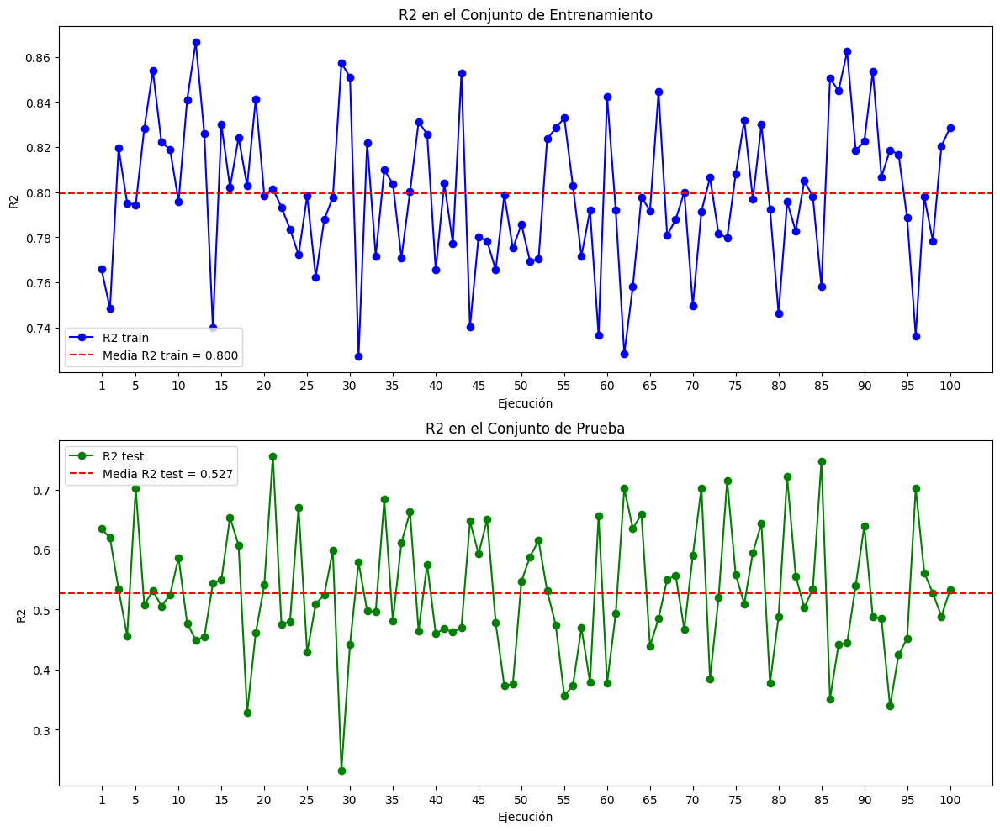

In [ ]:
plt.figure(figsize=(12, 10))

plt.subplot(2, 1, 1)
plt.plot(range(1, n_executions + 1), r2_train_scores, marker='o', linestyle='-', color='blue', label='R2 train')
plt.axhline(y=mean_r2_train, color='r', linestyle='--', label=f'Media R2 train = {mean_r2_train:.3f}')

plt.xlabel('Ejecución')
plt.xticks([1] + [i for i in range(1, n_executions + 1) if i % 5 == 0])
plt.ylabel('R2')
plt.title('R2 en el Conjunto de Entrenamiento')
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(range(1, n_executions + 1), r2_test_scores, marker='o', linestyle='-', color='green', label='R2 test')
plt.axhline(y=mean_r2_test, color='r', linestyle='--', label=f'Media R2 test = {mean_r2_test:.3f}')
plt.xlabel('Ejecución')
plt.xticks([1] + [i for i in range(1, n_executions + 1) if i % 5 == 0])
plt.ylabel('R2')
plt.title('R2 en el Conjunto de Prueba')
plt.legend()

plt.tight_layout()
plt.show()


#### Evaluación de predicciones

In [ ]:
n_executions = 100
ln = [(64, 64, 64, 64)]
af = ['relu']
so = ['adam']
al = [0.1]
lr = 'adaptive'
mit=264

r2_test_values = []
n_executions=100
for i in range(n_executions):
    random_state = i + 1

    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)
    modelk = MLPRegressor(hidden_layer_sizes=lay, activation=act, solver=sol, alpha=alpha, learning_rate=lr, max_iter=mit, random_state=random_state)
    modelk.fit(x_train, y_train)

    r2_test = modelk.score(x_test, y_test)
    r2_test_values.append(r2_test)

mean_r2_test = np.mean(r2_test_values)

print(f"R2 Test Promedio: {mean_r2_test:.5f}")

index_closest_to_mean = np.argmin(np.abs(np.array(r2_test_values) - mean_r2_test))
closest_random_state = index_closest_to_mean + 1
closest_r2 = r2_test_values[index_closest_to_mean]

print(f"Random State más cercano al R2 Test Promedio: {closest_random_state}")
print(f"R2 correspondiente: {closest_r2:.5f}")

R2 Test Promedio: 0.52716
Random State más cercano al R2 Test Promedio: 98
R2 correspondiente: 0.52719


In [ ]:
x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=98)
min_max_scaler = MinMaxScaler()
min_max_scaler.fit(x_train)
x_train = min_max_scaler.transform(x_train)
x_test = min_max_scaler.transform(x_test)
modelk = MLPRegressor(hidden_layer_sizes=lay, activation=act, solver=sol, alpha=alpha, learning_rate=lr, max_iter=mit, random_state=random_state)

modelk.fit(x_train, y_train)
y_predict_train = modelk.predict(x_train)
y_predict_test = modelk.predict(x_test)

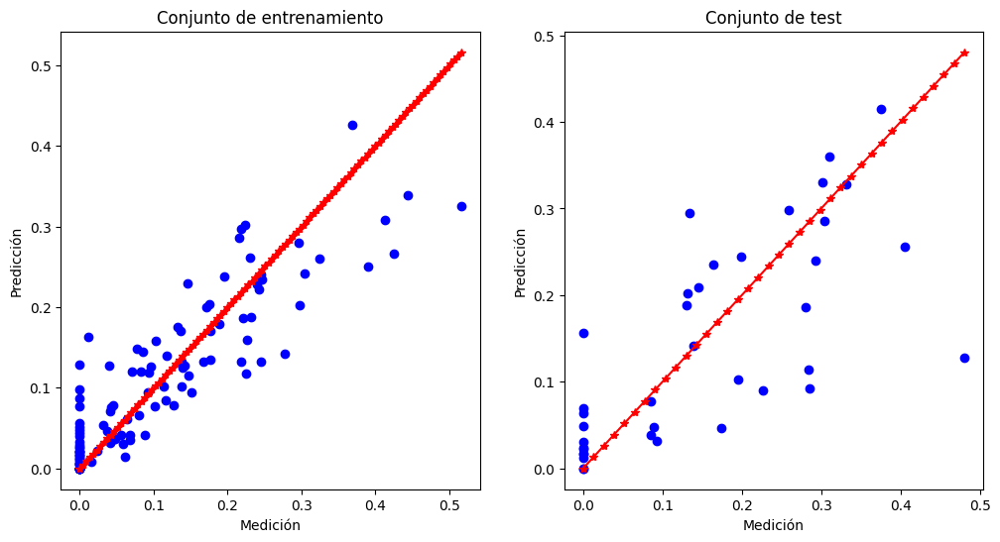

In [ ]:
y_train = np.maximum(y_train, 0)
y_predict_train = np.maximum(y_predict_train, 0)

y_test = np.maximum(y_test, 0)
y_predict_test = np.maximum(y_predict_test, 0)


x = np.linspace(min(min(y_train), min(y_predict_train)), max(max(y_train), max(y_predict_train)), len(y_train))

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.scatter(y_train, y_predict_train, c='blue')
plt.plot(x,x,'r*-')
plt.xlabel("Gravedad real")
plt.ylabel("Gravedad predicha")
plt.title ("Conjunto de entrenamiento")

x = np.linspace(min(min(y_test), min(y_predict_test)), max(max(y_test), max(y_predict_test)), len(y_test))

plt.subplot(1,2,2)
plt.scatter(y_test, y_predict_test, c='blue')
plt.plot(x,x,'r*-')
plt.xlabel("Gravedad real")
plt.ylabel("Gravedad predicha")
plt.title("Conjunto de test")
plt.show()

#### Métricas de clasificación: normal o patológico

In [ ]:
n_executions = 100
ln = [(64, 64, 64, 64)]
af = ['relu']
so = ['adam']
al = [0.1]
lr = 'adaptive'
mit=264


precision_train_scores = []
recall_train_scores = []
f1_train_scores = []
accuracy_train_scores = []

precision_test_scores = []
recall_test_scores = []
f1_test_scores = []
accuracy_test_scores = []

for random_state in range(1, n_executions + 1):
    x_train, x_test, y_train, y_test = train_test_split(data_x, data_y, test_size=0.25, random_state=random_state)

    min_max_scaler = MinMaxScaler()
    min_max_scaler.fit(x_train)
    x_train = min_max_scaler.transform(x_train)
    x_test = min_max_scaler.transform(x_test)

    model = MLPRegressor(hidden_layer_sizes=lay, activation=act, solver=sol, alpha=alpha, learning_rate=lr, max_iter=mit, random_state=random_state)
    model.fit(x_train, y_train)

    y_predict_train = model.predict(x_train)
    y_predict_test = model.predict(x_test)

    y_train_bin = np.where(y_train > 0, 1, 0)
    y_test_bin = np.where(y_test > 0, 1, 0)
    y_predict_train_bin = np.where(y_predict_train > 0, 1, 0)
    y_predict_test_bin = np.where(y_predict_test > 0, 1, 0)

    precision_train = precision_score(y_train_bin, y_predict_train_bin)
    recall_train = recall_score(y_train_bin, y_predict_train_bin)
    f1_train = f1_score(y_train_bin, y_predict_train_bin)
    accuracy_train = accuracy_score(y_train_bin, y_predict_train_bin)

    precision_test = precision_score(y_test_bin, y_predict_test_bin)
    recall_test = recall_score(y_test_bin, y_predict_test_bin)
    f1_test = f1_score(y_test_bin, y_predict_test_bin)
    accuracy_test = accuracy_score(y_test_bin, y_predict_test_bin)

    precision_train_scores.append(precision_train)
    recall_train_scores.append(recall_train)
    f1_train_scores.append(f1_train)
    accuracy_train_scores.append(accuracy_train)

    precision_test_scores.append(precision_test)
    recall_test_scores.append(recall_test)
    f1_test_scores.append(f1_test)
    accuracy_test_scores.append(accuracy_test)

mean_precision_train = np.mean(precision_train_scores)
std_precision_train = np.std(precision_train_scores)/(n_executions**0.5)
mean_recall_train = np.mean(recall_train_scores)
std_recall_train = np.std(recall_train_scores)/(n_executions**0.5)
mean_f1_train = np.mean(f1_train_scores)
std_f1_train = np.std(f1_train_scores)/(n_executions**0.5)
mean_accuracy_train = np.mean(accuracy_train_scores)
std_accuracy_train = np.std(accuracy_train_scores)/(n_executions**0.5)

mean_precision_test = np.mean(precision_test_scores)
std_precision_test = np.std(precision_test_scores)/(n_executions**0.5)
mean_recall_test = np.mean(recall_test_scores)
std_recall_test = np.std(recall_test_scores)/(n_executions**0.5)
mean_f1_test = np.mean(f1_test_scores)
std_f1_test = np.std(f1_test_scores)/(n_executions**0.5)
mean_accuracy_test = np.mean(accuracy_test_scores)
std_accuracy_test = np.std(accuracy_test_scores)/(n_executions**0.5)

print("Conjunto de entrenamiento:")
print(f"Precisión: {mean_precision_train:.5f} ± {std_precision_train:.5f}")
print(f"Recall: {mean_recall_train:.5f} ± {std_recall_train:.5f}")
print(f"F1-Score: {mean_f1_train:.5f} ± {std_f1_train:.5f}")
print(f"Exactitud: {mean_accuracy_train:.5f} ± {std_accuracy_train:.5f}")

print("\nConjunto de test:")
print(f"Precisión: {mean_precision_test:.5f} ± {std_precision_test:.5f}")
print(f"Recall: {mean_recall_test:.5f} ± {std_recall_test:.5f}")
print(f"F1-Score: {mean_f1_test:.5f} ± {std_f1_test:.5f}")
print(f"Exactitud: {mean_accuracy_test:.5f} ± {std_accuracy_test:.5f}")

Conjunto de entrenamiento:
Precisión: 0.72809 ± 0.00237
Recall: 0.99987 ± 0.00013
F1-Score: 0.84239 ± 0.00159
Exactitud: 0.75045 ± 0.00230

Conjunto de test:
Precisión: 0.72804 ± 0.00802
Recall: 0.99081 ± 0.00187
F1-Score: 0.83679 ± 0.00554
Exactitud: 0.74684 ± 0.00785


# SEGMENTACIÓN AUTOMÁTICA

In [ ]:
%cd /content/drive/MyDrive/Tfg24DDcardio

/content/drive/.shortcut-targets-by-id/1eS3VrSfNkwHDfe6zWqhlTXL3RfvO94w1/Tfg24DDcardio


##### Carga dataset de imágenes

Carga archivos NIfTI

In [ ]:
dataset_path = 'img/Database1'
cases = glob.glob(os.path.join(dataset_path, 'Case_*'))

def extract_case_number(case_path):
    match = re.search(r'Case_[NP]?(\d+)', case_path)
    if match:
        return int(match.group(1))
    return float('inf')

cases = sorted(cases, key=extract_case_number)

# Parámetros de redimensionamiento
final_size = 256
img_size = 128

n_img = len(cases)

input_img = np.zeros((n_img, final_size, img_size, img_size))
input_mask = np.zeros((n_img, final_size, img_size, img_size))

num_cortes_por_paciente = []

for j, case_path in enumerate(cases):
    print(f"Procesando: {case_path}")

    image_path = os.path.join(case_path, 'Images', os.path.basename(case_path) + '.nii')
    segmentation_path = os.path.join(case_path, 'Contours', os.path.basename(case_path) + '.nii')

    image_nii = nib.load(image_path)
    image = image_nii.get_fdata()

    mask_nii = nib.load(segmentation_path)
    mask = mask_nii.get_fdata()

    layers = image.shape[2]
    num_cortes_por_paciente.append(layers)

    for k in range(layers):
        img_aux = image[:, :, k]
        mask_aux = mask[:, :, k]
        img_aux = cv2.transpose(img_aux)
        mask_aux = cv2.transpose(mask_aux)

        img_res = cv2.resize(img_aux, (final_size, final_size))
        mask_res = cv2.resize(mask_aux, (final_size, final_size), interpolation=cv2.INTER_NEAREST)

        col1 = int((final_size / 2) - (img_size / 2))
        row1 = int((final_size / 2) - (img_size / 2))
        col2 = col1 + img_size
        row2 = row1 + img_size

        col1 = max(0, col1)
        row1 = max(0, row1)
        col2 = min(final_size, col2)
        row2 = min(final_size, row2)

        input_img[j, k, :, :] = img_res[row1:row2, col1:col2]
        input_mask[j, k, :, :] = mask_res[row1:row2, col1:col2]

Procesando: img/Database1/Case_P001
Procesando: img/Database1/Case_P002
Procesando: img/Database1/Case_P003
Procesando: img/Database1/Case_P004
Procesando: img/Database1/Case_P005
Procesando: img/Database1/Case_N006
Procesando: img/Database1/Case_P007
Procesando: img/Database1/Case_P008
Procesando: img/Database1/Case_P009
Procesando: img/Database1/Case_P010
Procesando: img/Database1/Case_P011
Procesando: img/Database1/Case_N012
Procesando: img/Database1/Case_N013
Procesando: img/Database1/Case_N014
Procesando: img/Database1/Case_P015
Procesando: img/Database1/Case_N016
Procesando: img/Database1/Case_P017
Procesando: img/Database1/Case_N018
Procesando: img/Database1/Case_P019
Procesando: img/Database1/Case_N020
Procesando: img/Database1/Case_P021
Procesando: img/Database1/Case_P022
Procesando: img/Database1/Case_N023
Procesando: img/Database1/Case_N024
Procesando: img/Database1/Case_N025
Procesando: img/Database1/Case_P026
Procesando: img/Database1/Case_N027
Procesando: img/Database1/Ca

##### Visualización imágenes y máscaras

In [ ]:
def actualizar_visualizacion(num_paciente, slice_idx):
    num_img = num_paciente - 1

    plt.figure(figsize=(12, 8))

    plt.subplot(231)
    plt.title('Imagen')
    plt.imshow(input_img[num_img, slice_idx, :, :], cmap='gray')

    plt.subplot(232)
    plt.title('Etiquetas')
    plt.imshow(input_mask[num_img, slice_idx, :, :], cmap='gray')

    plt.show()

num_paciente_dropdown = widgets.Dropdown(
    options=list(range(1, n_img + 1)),
    value=1,
    description='Paciente:',
)

def obtener_num_cortes(change):
    max_slices = num_cortes_por_paciente[change['new'] - 1] - 1
    slice_slider.max = max_slices
    slice_slider.value = 0

num_paciente_dropdown.observe(obtener_num_cortes, names='value')

slice_slider = widgets.IntSlider(
    value=0,
    min=0,
    max=num_cortes_por_paciente[0] - 1,
    step=1,
    description='Slice:',
)

widgets.interact(actualizar_visualizacion, num_paciente=num_paciente_dropdown, slice_idx=slice_slider)

interactive(children=(Dropdown(description='Paciente:', options=(1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14…

<function __main__.actualizar_visualizacion(num_paciente, slice_idx)>

##### Modelo UNET

In [ ]:
def multi_unet_model(n_classes, img_alt, img_anch, canales):
    inputs = Input((img_alt, img_anch, canales))
    s = inputs

    c1 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(s)
    c1 = Dropout(0.1)(c1)
    c1 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
    c2 = Dropout(0.1)(c2)
    c2 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
    c3 = Dropout(0.2)(c3)
    c3 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
    c4 = Dropout(0.2)(c4)
    c4 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c4)
    p4 = MaxPooling2D(pool_size=(2, 2))(c4)

    c5 = Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4)
    c5 = Dropout(0.3)(c5)
    c5 = Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c5)

    u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c5)
    u6 = concatenate([u6, c4])
    c6 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u6)
    c6 = Dropout(0.2)(c6)
    c6 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c6)

    u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = concatenate([u7, c3])
    c7 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u7)
    c7 = Dropout(0.2)(c7)
    c7 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c7)

    u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u8)
    c8 = Dropout(0.1)(c8)
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c8)

    u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = concatenate([u9, c1], axis=3)
    c9 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u9)
    c9 = Dropout(0.1)(c9)
    c9 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c9)

    outputs = Conv2D(n_classes, (1, 1), activation='softmax')(c9)
    model = Model(inputs=[inputs], outputs=[outputs])

    return model

## Preparación de imágenes para el modelo

In [ ]:
size_x = 128
size_y = 128
n_classes=5

### Train y test images

75% train, 15% val y 15% test

In [ ]:
def adjust_contrast(image, alpha):
    adjusted = cv2.convertScaleAbs(image, alpha=alpha, beta=0)
    return adjusted

def augment_images_and_masks_contrast(images, masks, image_names, mask_names, contrast_factors, labels):
    augmented_images = []
    augmented_masks = []
    augmented_image_names = []
    augmented_mask_names = []

    for image, mask, image_name, mask_name, label in zip(images, masks, image_names, mask_names, labels):
        augmented_images.append(image)
        augmented_masks.append(mask)
        augmented_image_names.append(image_name)
        augmented_mask_names.append(mask_name)

        if label == 'Pmo':  # Solo ajustar el contraste en imágenes con PMO > 0
            for alpha in contrast_factors:
                contrast_image = adjust_contrast(image, alpha)
                contrast_image_name = f"{os.path.splitext(image_name)[0]}_contrast_{alpha}{os.path.splitext(image_name)[1]}"
                augmented_images.append(contrast_image)
                augmented_masks.append(mask)
                augmented_image_names.append(contrast_image_name)
                augmented_mask_names.append(mask_name)

    return augmented_images, augmented_masks, augmented_image_names, augmented_mask_names

patients_df_cop1['Case'] = patients_df_cop1['Case'].astype(int)

status = patients_df_cop1.set_index('Case')['Status'].to_dict()
pmo_status = patients_df_cop1.set_index('Case')['PMO area (cm3)'].to_dict()

def sort_by_case_and_slice(file_list):
    return sorted(file_list, key=lambda x: extract_case_and_slice(x))

def extract_case_and_slice(image_name):
    match = re.search(r'Case_(\d+)_Slice_(\d+)', image_name)
    if match:
        return int(match.group(1)), int(match.group(2))
    return float('inf'), float('inf')

images = []
image_names = []
masks = []
mask_names = []
labels = []

valores_case = patients_df_cop1['Case'].values

for directory_path in glob.glob('img/Images'):
    image_paths = glob.glob(os.path.join(directory_path, "*.tif"))
    image_paths = sort_by_case_and_slice(image_paths)
    for image_path in image_paths:
        image_name = os.path.basename(image_path)
        case_number, _ = extract_case_and_slice(image_name)
        image = cv2.imread(image_path, 0)
        if case_number in valores_case:
            etiqueta = status[case_number]
            pmo_etiqueta = 'Pmo' if pmo_status[case_number] > 0 else 'N'
            images.append(image)
            image_names.append(image_name)
            labels.append(pmo_etiqueta)

for directory_path in glob.glob('img/Masks'):
    mask_paths = glob.glob(os.path.join(directory_path, "*.tif"))
    mask_paths = sort_by_case_and_slice(mask_paths)
    for mask_path in mask_paths:
        mask_name = os.path.basename(mask_path)
        case_number, _ = extract_case_and_slice(mask_name)
        mask = cv2.imread(mask_path, 0)
        if case_number in valores_case:
            masks.append(mask)
            mask_names.append(mask_name)

# Dividir en train, val y test manteniendo la proporción 2/3 Pmo y 1/3 N
train_images, temp_images, train_labels, temp_labels, train_image_names, temp_image_names, train_masks, temp_masks, train_mask_names, temp_mask_names = train_test_split(
    images, labels, image_names, masks, mask_names, test_size=0.3, stratify=labels, random_state=42)

val_images, test_images, val_labels, test_labels, val_image_names, test_image_names, val_masks, test_masks, val_mask_names, test_mask_names = train_test_split(
    temp_images, temp_labels, temp_image_names, temp_masks, temp_mask_names, test_size=0.5, stratify=temp_labels, random_state=42)

# Aplicar el ajuste de contraste solo a las imágenes de casos con PMO > 0 en el conjunto de entrenamiento
contrast_factors = [1.5]

train_images_aug, train_masks_aug, train_image_names_aug, train_mask_names_aug = augment_images_and_masks_contrast(
    train_images, train_masks, train_image_names, train_mask_names, contrast_factors, train_labels)


train_images_aug = np.array(train_images_aug)
val_images = np.array(val_images)
test_images = np.array(test_images)

train_masks_aug = np.array(train_masks_aug)
val_masks = np.array(val_masks)
test_masks = np.array(test_masks)

print(f"Train set size: {len(train_images)}, Val set size: {len(val_images)}, Test set size: {len(test_images)}")
print(f"Train set size (contraste): {len(train_images_aug)}, Val set size: {len(val_images)}, Test set size: {len(test_images)}")

Train set size: 746, Val set size: 160, Test set size: 160
Train set size (contraste): 957, Val set size: 160, Test set size: 160


In [ ]:
print("\nImágenes de train:")
for image_name in train_image_names:
    print(image_name)

print("\nImágenes de train + contraste:")
for image_name in train_image_names_aug:
    print(image_name)

print("\nImágenes de validación:")
for image_name in val_image_names:
    print(image_name)

print("\nImágenes de test:")
for image_name in test_image_names:
    print(image_name)


Imágenes de train:
Case_146_Slice_4.tif
Case_67_Slice_1.tif
Case_58_Slice_6.tif
Case_19_Slice_2.tif
Case_56_Slice_3.tif
Case_73_Slice_5.tif
Case_61_Slice_6.tif
Case_150_Slice_3.tif
Case_106_Slice_4.tif
Case_82_Slice_1.tif
Case_60_Slice_4.tif
Case_47_Slice_0.tif
Case_15_Slice_7.tif
Case_80_Slice_0.tif
Case_46_Slice_1.tif
Case_86_Slice_4.tif
Case_127_Slice_1.tif
Case_24_Slice_0.tif
Case_53_Slice_7.tif
Case_12_Slice_4.tif
Case_28_Slice_4.tif
Case_11_Slice_1.tif
Case_130_Slice_3.tif
Case_68_Slice_4.tif
Case_131_Slice_2.tif
Case_15_Slice_2.tif
Case_144_Slice_3.tif
Case_52_Slice_3.tif
Case_114_Slice_4.tif
Case_79_Slice_3.tif
Case_7_Slice_1.tif
Case_92_Slice_2.tif
Case_118_Slice_6.tif
Case_105_Slice_4.tif
Case_105_Slice_3.tif
Case_23_Slice_4.tif
Case_109_Slice_7.tif
Case_123_Slice_4.tif
Case_25_Slice_5.tif
Case_73_Slice_0.tif
Case_35_Slice_6.tif
Case_110_Slice_7.tif
Case_38_Slice_0.tif
Case_94_Slice_9.tif
Case_51_Slice_1.tif
Case_64_Slice_2.tif
Case_49_Slice_4.tif
Case_95_Slice_3.tif
Case_67

In [ ]:
print(f"Total de imágenes de train: {len(train_images)}")
print(f"Total de imágenes de train + contraste: {len(train_images_aug)}")
print(f"Total de imágenes de validación: {len(val_images)}")
print(f"Total de imágenes de test: {len(test_images)}")

Total de imágenes de train: 746
Total de imágenes de train + contraste: 957
Total de imágenes de validación: 160
Total de imágenes de test: 160


In [ ]:
train_masks = np.array(train_masks)
test_masks = np.array(test_masks)
val_masks = np.array(val_masks)

train_masks_aug = np.array(train_masks_aug)

print(f"Total de máscaras de train: {len(train_masks)}")
print(f"Total de máscaras de test: {len(test_masks)}")
print(f"Total de máscaras de validación: {len(val_masks)}")
print(f"Total de máscaras + contraste de train: {len(train_masks_aug)}")

print("\nMasks de train:")
for mask_name in train_mask_names:
    print(mask_name)

print("\nMasks de test:")
for mask_name in test_mask_names:
    print(mask_name)

print("\nMasks de validación:")
for mask_name in val_mask_names:
    print(mask_name)

print("\nMasks + contraste de train:")
for mask_name in train_mask_names_aug:
    print(mask_name)

Total de máscaras de train: 746
Total de máscaras de test: 160
Total de máscaras de validación: 160
Total de máscaras + contraste de train: 957

Masks de train:
Case_146_Slice_4.tif
Case_67_Slice_1.tif
Case_58_Slice_6.tif
Case_19_Slice_2.tif
Case_56_Slice_3.tif
Case_73_Slice_5.tif
Case_61_Slice_6.tif
Case_150_Slice_3.tif
Case_106_Slice_4.tif
Case_82_Slice_1.tif
Case_60_Slice_4.tif
Case_47_Slice_0.tif
Case_15_Slice_7.tif
Case_80_Slice_0.tif
Case_46_Slice_1.tif
Case_86_Slice_4.tif
Case_127_Slice_1.tif
Case_24_Slice_0.tif
Case_53_Slice_7.tif
Case_12_Slice_4.tif
Case_28_Slice_4.tif
Case_11_Slice_1.tif
Case_130_Slice_3.tif
Case_68_Slice_4.tif
Case_131_Slice_2.tif
Case_15_Slice_2.tif
Case_144_Slice_3.tif
Case_52_Slice_3.tif
Case_114_Slice_4.tif
Case_79_Slice_3.tif
Case_7_Slice_1.tif
Case_92_Slice_2.tif
Case_118_Slice_6.tif
Case_105_Slice_4.tif
Case_105_Slice_3.tif
Case_23_Slice_4.tif
Case_109_Slice_7.tif
Case_123_Slice_4.tif
Case_25_Slice_5.tif
Case_73_Slice_0.tif
Case_35_Slice_6.tif
Case_11

In [ ]:
unique_train_masks = [np.unique(mask) for mask in train_masks]
unique_train_masks_aug = [np.unique(mask) for mask in train_masks_aug]
unique_test_masks = [np.unique(mask) for mask in test_masks]
unique_val_masks = [np.unique(mask) for mask in val_masks]

print("\nValores únicos de las máscaras de entrenamiento:")
for idx, unique_vals in enumerate(unique_train_masks):
    print(f"Para la máscara {train_mask_names[idx]}: {unique_vals}")

print("\nValores únicos de las máscaras de entrenamiento + contraste:")
for idx, unique_vals in enumerate(unique_train_masks_aug):
  print(f"Para la máscara {train_mask_names_aug[idx]}: {unique_vals}")

print("\nValores únicos de las máscaras de prueba:")
for idx, unique_vals in enumerate(unique_test_masks):
    print(f"Para la máscara {test_mask_names[idx]}: {unique_vals}")

print("\nValores únicos de las máscaras de validación:")
for idx, unique_vals in enumerate(unique_val_masks):
    print(f"Para la máscara {val_mask_names[idx]}: {unique_vals}")



Valores únicos de las máscaras de entrenamiento:
Para la máscara Case_146_Slice_4.tif: [  0  85 170 255]
Para la máscara Case_67_Slice_1.tif: [  0  63 127 191 255]
Para la máscara Case_58_Slice_6.tif: [  0 127 255]
Para la máscara Case_19_Slice_2.tif: [  0  63 127 191 255]
Para la máscara Case_56_Slice_3.tif: [  0 127 255]
Para la máscara Case_73_Slice_5.tif: [  0  85 170 255]
Para la máscara Case_61_Slice_6.tif: [  0  85 170 255]
Para la máscara Case_150_Slice_3.tif: [  0  85 170 255]
Para la máscara Case_106_Slice_4.tif: [  0  85 170 255]
Para la máscara Case_82_Slice_1.tif: [  0  85 170 255]
Para la máscara Case_60_Slice_4.tif: [  0  85 170 255]
Para la máscara Case_47_Slice_0.tif: [  0  85 170 255]
Para la máscara Case_15_Slice_7.tif: [  0  85 170 255]
Para la máscara Case_80_Slice_0.tif: [  0 127 255]
Para la máscara Case_46_Slice_1.tif: [  0 127 255]
Para la máscara Case_86_Slice_4.tif: [  0 127 255]
Para la máscara Case_127_Slice_1.tif: [  0  85 170 255]
Para la máscara Case_24

### Mask. Convertir en valores únicos

In [ ]:
def map_values_specific(mask):
    unique_values = np.unique(mask)

    mapping = {}

    if len(unique_values) == 3:
        mapping = {value: new_value for value, new_value in zip(sorted(unique_values), [0, 63, 127])}
    elif len(unique_values) == 4:
        mapping = {value: new_value for value, new_value in zip(sorted(unique_values), [0, 63, 127, 191])}
    elif len(unique_values) == 5:
        mapping = {value: new_value for value, new_value in zip(sorted(unique_values), [0, 63, 127, 191, 255])}

    mapped_mask = np.copy(mask)
    for value, new_value in mapping.items():
        mapped_mask[mask == value] = new_value

    return mapped_mask

In [ ]:
train_masks = np.array([map_values_specific(mask) for mask in train_masks])
test_masks = np.array([map_values_specific(mask) for mask in test_masks])
val_masks = np.array([map_values_specific(mask) for mask in val_masks])
train_masks_aug = np.array([map_values_specific(mask) for mask in train_masks_aug])

print(np.unique(train_masks))
print(np.unique(test_masks))
print(np.unique(val_masks))
print(np.unique(train_masks_aug))

[  0  63 127 191 255]
[  0  63 127 191 255]
[  0  63 127 191 255]
[  0  63 127 191 255]


### Tratamiento de máscaras: modificación de labels

In [ ]:
labelencoder = LabelEncoder()
n, h, w = train_masks.shape
train_masks_reshaped = train_masks.reshape(-1, 1)
train_masks_reshaped_encoded = labelencoder.fit_transform(train_masks_reshaped)  # Se hace el reshape ya que esta función solo acepta entradas 1D
train_masks_encoded_original_shape = train_masks_reshaped_encoded.reshape(n, h, w)

n, h, w = test_masks.shape
test_masks_reshaped = test_masks.reshape(-1, 1)
test_masks_reshaped_encoded = labelencoder.fit_transform(test_masks_reshaped)
test_masks_encoded_original_shape = test_masks_reshaped_encoded.reshape(n, h, w)

n, h, w = val_masks.shape
val_masks_reshaped = val_masks.reshape(-1, 1)
val_masks_reshaped_encoded = labelencoder.fit_transform(val_masks_reshaped)
val_masks_encoded_original_shape = val_masks_reshaped_encoded.reshape(n, h, w)

n, h, w = train_masks_aug.shape
train_masks_reshaped_aug = train_masks_aug.reshape(-1, 1)
train_masks_reshaped_encoded_aug = labelencoder.fit_transform(train_masks_reshaped_aug)
train_masks_encoded_original_shape_aug = train_masks_reshaped_encoded_aug.reshape(n, h, w)

print(np.unique(train_masks_encoded_original_shape))
print(np.unique(test_masks_encoded_original_shape))
print(np.unique(val_masks_encoded_original_shape))
print(np.unique(train_masks_encoded_original_shape_aug))

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:116: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:116: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:116: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:116: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

[0 1 2 3 4]
[0 1 2 3 4]
[0 1 2 3 4]
[0 1 2 3 4]


### Tratamiento de imágenes: normalización y dimensiones para el modelo

In [ ]:
train_images = np.expand_dims(train_images, axis=3) #adaptar dimensiones de las imágenes para el modelo
train_images = normalize(train_images, axis=1) #se pasa a float64
train_masks_input = np.expand_dims(train_masks_encoded_original_shape, axis=3) #se expanden dimensiones de la máscara para el modelo

test_images = np.expand_dims(test_images, axis=3)
test_images = normalize(test_images, axis=1)
test_masks_input = np.expand_dims(test_masks_encoded_original_shape, axis=3)

val_images = np.expand_dims(val_images, axis=3)
val_images = normalize(val_images, axis=1)
val_masks_input = np.expand_dims(val_masks_encoded_original_shape, axis=3)

train_images_aug = np.expand_dims(train_images_aug, axis=3) #adaptar dimensiones de las imágenes para el modelo
train_images_aug = normalize(train_images_aug, axis=1) #se pasa a float64
train_masks_input_aug = np.expand_dims(train_masks_encoded_original_shape_aug, axis=3) #se expanden dimensiones de la máscara para el modelo

Adaptación variables a modelo

In [ ]:
n_classes=5

X_train=train_images
X_train_aug=train_images_aug
X_val=val_images
X_test=test_images

y_train=train_masks_input
y_train_aug=train_masks_input_aug
y_val=val_masks_input
y_test=test_masks_input

train_masks_cat = to_categorical(y_train, num_classes=n_classes)
y_train_cat = train_masks_cat.reshape((y_train.shape[0], y_train.shape[1], y_train.shape[2], n_classes))

train_masks_cat_aug = to_categorical(y_train_aug, num_classes=n_classes)
y_train_cat_aug = train_masks_cat_aug.reshape((y_train_aug.shape[0], y_train_aug.shape[1], y_train_aug.shape[2], n_classes))

val_masks_cat = to_categorical(y_val, num_classes=n_classes)
y_val_cat = val_masks_cat.reshape((y_val.shape[0], y_val.shape[1], y_val.shape[2], n_classes))

test_masks_cat = to_categorical(y_test, num_classes=n_classes)
y_test_cat = test_masks_cat.reshape((y_test.shape[0], y_test.shape[1], y_test.shape[2], n_classes))

print(y_train_cat.shape)
print(y_train_cat_aug.shape)
print(y_val_cat.shape)
print(y_test_cat.shape)

(746, 128, 128, 5)
(957, 128, 128, 5)
(160, 128, 128, 5)
(160, 128, 128, 5)


### Importar el modelo

In [ ]:
img_alt = X_train.shape[1]
img_anch  = X_train.shape[2]
canales = X_train.shape[3]

Métricas

In [ ]:
def dice_coef(y_true, y_pred, smooth=1.0):
    class_num = 5
    for i in range(class_num):
        y_true_f = K.flatten(y_true[:,:,:,i])
        y_pred_f = K.flatten(y_pred[:,:,:,i])
        intersection = K.sum(y_true_f * y_pred_f)
        loss = ((2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth))
        if i == 0:
            total_loss = loss
        else:
            total_loss = total_loss + loss
    total_loss = total_loss / class_num
    return total_loss

def precision(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
        precision = true_positives / (predicted_positives + K.epsilon())
        return precision

def sensitivity(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    return true_positives / (possible_positives + K.epsilon())


def specificity(y_true, y_pred):
    true_negatives = K.sum(K.round(K.clip((1-y_true) * (1-y_pred), 0, 1)))
    possible_negatives = K.sum(K.round(K.clip(1-y_true, 0, 1)))
    return true_negatives / (possible_negatives + K.epsilon())

def mean_iou(y_true, y_pred, num_classes=5):
    y_pred = tf.argmax(y_pred, axis=-1)
    y_pred = tf.expand_dims(y_pred, axis=-1)

    y_true = tf.cast(y_true, tf.int32)
    y_pred = tf.cast(y_pred, tf.int32)

    iou_list = []
    for i in range(num_classes):
        intersection = tf.reduce_sum(tf.cast((y_true == i) & (y_pred == i), tf.float32))
        union = tf.reduce_sum(tf.cast((y_true == i) | (y_pred == i), tf.float32))
        iou = intersection / (union + tf.keras.backend.epsilon())
        iou_list.append(iou)

    return tf.reduce_mean(iou_list)

In [ ]:
def get_model():
    return multi_unet_model(n_classes=n_classes, img_alt=img_alt, img_anch=img_anch, canales=canales)

model = get_model()
model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics = ['accuracy', mean_iou, dice_coef, precision, sensitivity, specificity] )
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 128, 128, 1)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 128, 128, 16)         160       ['input_1[0][0]']             
                                                                                                  
 dropout (Dropout)           (None, 128, 128, 16)         0         ['conv2d[0][0]']              
                                                                                                  
 conv2d_1 (Conv2D)           (None, 128, 128, 16)         2320      ['dropout[0][0]']             
                                                                                              

## Entrenamiento del modelo 1, 16, 0.001

746 imágenes train, 160 val, 160 test

In [ ]:
def get_model():
    return multi_unet_model(n_classes=n_classes, img_alt=img_alt, img_anch=img_anch, canales=canales)

model = get_model()
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics = ['accuracy', dice_coef, precision, sensitivity, specificity],run_eagerly=True)
model.summary()

callbacks = [
    keras.callbacks.ModelCheckpoint(filepath = 'img/Models/modelo1tfg.{epoch:02d}-{val_loss:.6f}.m5',
                             verbose=1, save_best_only=True, save_weights_only = True),
    CSVLogger('img/Models/modelo1tfg.log', separator=',', append=False)
]

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 128, 128, 1)]        0         []                            
                                                                                                  
 conv2d_19 (Conv2D)          (None, 128, 128, 16)         160       ['input_2[0][0]']             
                                                                                                  
 dropout_9 (Dropout)         (None, 128, 128, 16)         0         ['conv2d_19[0][0]']           
                                                                                                  
 conv2d_20 (Conv2D)          (None, 128, 128, 16)         2320      ['dropout_9[0][0]']           
                                                                                            

In [ ]:
history= model.fit(X_train,y_train_cat,
          batch_size = 16,
          epochs=50,
          callbacks=callbacks,
          validation_data=(X_val, y_val_cat))

save_directory = 'img/Models'
if not os.path.exists(save_directory):
    os.makedirs(save_directory)

model.save(os.path.join(save_directory, 'modelo1tfg.hdf5'))

Epoch 1/50
47/47 [==============================] - ETA: 0s - loss: 0.7362 - accuracy: 0.8291 - dice_coef: 0.1860 - precision: 0.8135 - sensitivity: 0.7070 - specificity: 0.9727
Epoch 1: val_loss improved from inf to 0.33810, saving model to img/Models/modelo1tfg.01-0.338102.m5
47/47 [==============================] - 163s 3s/step - loss: 0.7362 - accuracy: 0.8291 - dice_coef: 0.1860 - precision: 0.8135 - sensitivity: 0.7070 - specificity: 0.9727 - val_loss: 0.3381 - val_accuracy: 0.8804 - val_dice_coef: 0.2481 - val_precision: 0.8804 - val_sensitivity: 0.8804 - val_specificity: 0.9701
Epoch 2/50
47/47 [==============================] - ETA: 0s - loss: 0.3101 - accuracy: 0.8770 - dice_coef: 0.2779 - precision: 0.9333 - sensitivity: 0.8627 - specificity: 0.9842
Epoch 2: val_loss did not improve from 0.33810
47/47 [==============================] - 153s 3s/step - loss: 0.3101 - accuracy: 0.8770 - dice_coef: 0.2779 - precision: 0.9333 - sensitivity: 0.8627 - specificity: 0.9842 - val_loss

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


### Evaluación del modelo

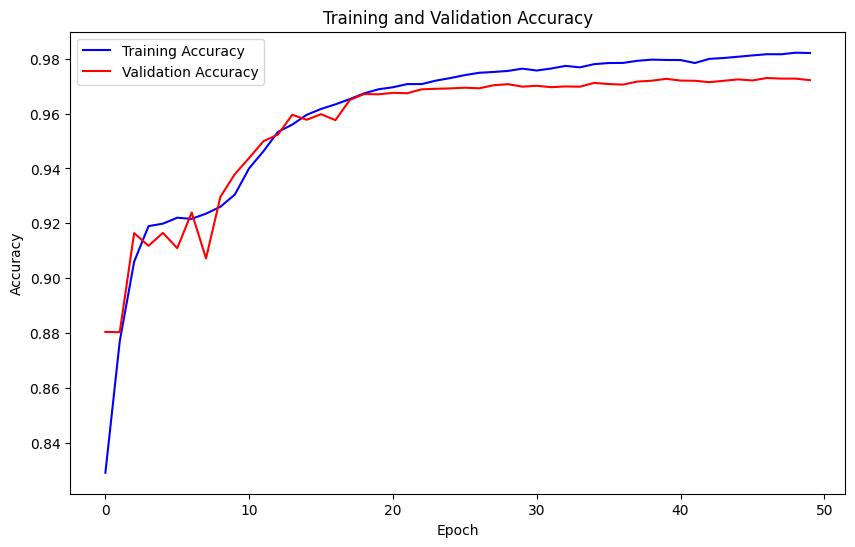

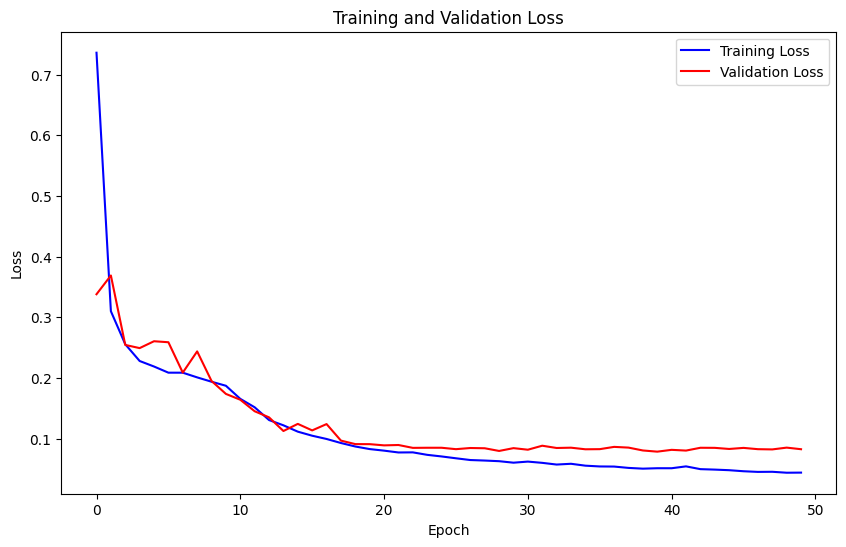

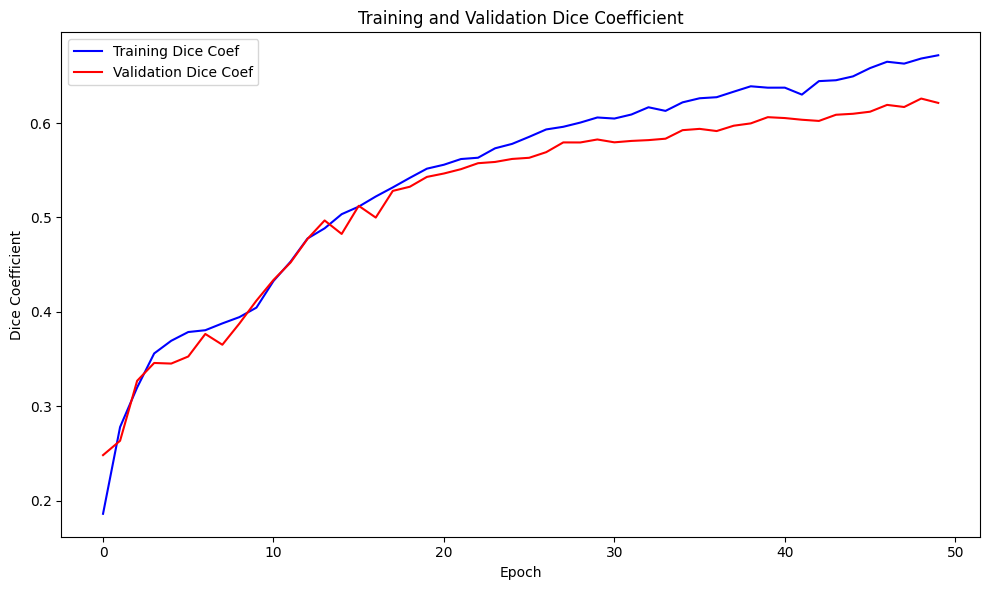

In [ ]:
history = pd.read_csv('img/Models/modelo1tfg.log', sep=',', engine='python')

plt.figure(figsize=(10, 6))

plt.plot(history['epoch'], history['accuracy'], 'b', label='Training Accuracy')
plt.plot(history['epoch'], history['val_accuracy'], 'r', label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['loss'], 'b', label='Training Loss')
plt.plot(history['epoch'], history['val_loss'], 'r', label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['dice_coef'], 'b', label='Training Dice Coef')
plt.plot(history['epoch'], history['val_dice_coef'], 'r', label='Validation Dice Coef')
plt.xlabel('Epoch')
plt.ylabel('Dice Coefficient')
plt.legend()
plt.title('Training and Validation Dice Coefficient')

plt.tight_layout()

plt.show()

In [ ]:
weight_path = 'img/Models/modelo1tfg.hdf5'

model.load_weights(weight_path)

y_pred=model.predict(X_test) #contiene las probabilidades
y_pred_argmax=np.argmax(y_pred, axis=3) #se pasa la probabilidad a binario

5/5 [==============================] - 14s 2s/step


In [ ]:
conf_matrix = confusion_matrix(y_test.flatten(), y_pred_argmax.flatten())
class_IoU = np.diag(conf_matrix) / (conf_matrix.sum(axis=1) + conf_matrix.sum(axis=0) - np.diag(conf_matrix))
mean_IoU = np.mean(class_IoU)

print("Mean IoU =", mean_IoU)
print("IoU for class1 (background) is:", class_IoU[0])
print("IoU for class2 (interior) is:", class_IoU[1])
print("IoU for class3 (miocardio) is:", class_IoU[2])
print("IoU for class4 (infarto) is:", class_IoU[3])
print("IoU for class5 (PMO) is:", class_IoU[4])

Mean IoU = 0.6167746267085634
IoU for class1 (background) is: 0.9841742407956653
IoU for class2 (interior) is: 0.8658804548710818
IoU for class3 (miocardio) is: 0.6858308544155894
IoU for class4 (infarto) is: 0.34553717505908016
IoU for class5 (PMO) is: 0.20245040840140024


In [ ]:
y_pred_argmax_flat = y_pred_argmax.reshape(-1)
y_test_cat_flat = y_test_cat.reshape(-1, 5)
y_true_labels = np.argmax(y_test_cat_flat, axis=1)

accuracy = accuracy_score(y_true_labels, y_pred_argmax_flat)
precision = precision_score(y_true_labels, y_pred_argmax_flat, average=None)
recall = recall_score(y_true_labels, y_pred_argmax_flat, average=None)
f1 = f1_score(y_true_labels, y_pred_argmax_flat, average=None)

class_accuracies = []

for i in range(5):

    class_indices = np.where(y_true_labels == i)[0]
    class_predictions = y_pred_argmax_flat[class_indices]
    class_true_labels = y_true_labels[class_indices]
    class_accuracy = accuracy_score(class_true_labels, class_predictions)
    class_accuracies.append(class_accuracy)

class_iou = []
class_dice = []
class_jaccard = []
for i in range(5):
    class_mask_pred = (y_pred_argmax_flat == i)
    class_mask_true = (y_true_labels == i)

    intersection = np.sum(class_mask_pred & class_mask_true)
    union = np.sum(class_mask_pred | class_mask_true)

    iou = intersection / union if union != 0 else 0
    dice = 2 * intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true)) if (np.sum(class_mask_pred) + np.sum(class_mask_true)) != 0 else 0
    jaccard = intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) if (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) != 0 else 0
    class_iou.append(iou)
    class_dice.append(dice)
    class_jaccard.append(jaccard)

conf_matrix = confusion_matrix(y_true_labels, y_pred_argmax_flat)

conf_matrix_normalized = conf_matrix.astype('float') / conf_matrix.sum(axis=1)[:, np.newaxis]

print("Matriz de Confusión:")
print(conf_matrix)

print("\nMatriz de Confusión Normalizada:")
print(conf_matrix_normalized)

table_header = ["Clase", "Accuracy", "Precision", "Recall", "F1 Score", "IoU", "DICE", "Jaccard"]
table_data = []
for i in range(5):
    row = [f"Clase {i}", round(class_accuracies[i], 4), round(precision[i], 4), round(recall[i], 4), round(f1[i], 4), round(class_iou[i], 4), round(class_dice[i], 4), round(class_jaccard[i], 4)]
    table_data.append(row)

print("\nResultados por Clase:")
print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*table_header))
for row in table_data:
    print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*row))

Matriz de Confusión:
[[2275339       2   14541     972       1]
 [    429  143834    7615    2906      16]
 [  18448    7812  124730    4137      43]
 [   2161    3215    4081    9504      49]
 [     34     284     460     480     347]]

Matriz de Confusión Normalizada:
[[9.93226983e-01 8.73036486e-07 6.34741177e-03 4.24295732e-04
  4.36518243e-07]
 [2.77131783e-03 9.29160207e-01 4.91925065e-02 1.87726098e-02
  1.03359173e-04]
 [1.18888960e-01 5.03447831e-02 8.03828060e-01 2.66610814e-02
  2.77115422e-04]
 [1.13677012e-01 1.69121515e-01 2.14676486e-01 4.99947396e-01
  2.57759074e-03]
 [2.11838006e-02 1.76947040e-01 2.86604361e-01 2.99065421e-01
  2.16199377e-01]]

Resultados por Clase:
Clase      Accuracy   Precision  Recall     F1 Score   IoU        DICE       Jaccard   
Clase 0    0.9932     0.9908     0.9932     0.992      0.9842     0.992      0.9842    
Clase 1    0.9292     0.9271     0.9292     0.9281     0.8659     0.9281     0.8659    
Clase 2    0.8038     0.8237     0.8038  

### Predicción de las imágenes

In [ ]:
def mostrar_imagen_y_mascaras(index):
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    etiqueta_colores = {
        0: (0, 0, 0, 1),          # Etiqueta 0: Negro (background)
        1: (0.6, 0.8, 0.6, 1),    # Etiqueta 1: Verde claro (ventrículo izquierdo)
        2: (1, 1, 0.6, 1),        # Etiqueta 2: Amarillo pálido (miocardio sano)
        3: (0.8, 0.4, 0.4, 1),    # Etiqueta 3: Rojo suave (miocardio patológico)
        4: 'lightblue'            # Etiqueta 4: Azul claro (PMO)
    }

    etiqueta_rgbas = [mcolors.to_rgba(etiqueta_colores[i]) for i in range(len(etiqueta_colores))]

    etiqueta_cmap = mcolors.ListedColormap(etiqueta_rgbas, N=len(etiqueta_colores))

    ax[0].imshow(X_test[index].squeeze(), cmap='gray')
    ax[0].set_title('Imagen Original')
    ax[0].text(0.5, -0.1, test_image_names[index], size=10, ha="center", transform=ax[0].transAxes)

    ax[1].imshow(y_test[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[1].set_title('Máscara Real')
    ax[1].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[1].transAxes)

    ax[2].imshow(y_pred_argmax[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[2].set_title('Máscara Predicha')
    ax[2].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[2].transAxes)

    plt.show()

for i in range(1, 159):
    mostrar_imagen_y_mascaras(i)

Output hidden; open in https://colab.research.google.com to view.

## Entrenamiento del modelo 1, 32, 0.001

In [ ]:
def get_model():
    return multi_unet_model(n_classes=n_classes, img_alt=img_alt, img_anch=img_anch, canales=canales)

model = get_model()
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics = ['accuracy', dice_coef, precision, sensitivity, specificity],run_eagerly=True)
model.summary()

callbacks = [
    keras.callbacks.ModelCheckpoint(filepath = 'img/Models/modelo1tfg32_001__.{epoch:02d}-{val_loss:.6f}.m5',
                             verbose=1, save_best_only=True, save_weights_only = True),
    CSVLogger('img/Models/modelo1tfg32_001__.log', separator=',', append=False)
]

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 128, 128, 1)]        0         []                            
                                                                                                  
 conv2d_38 (Conv2D)          (None, 128, 128, 16)         160       ['input_3[0][0]']             
                                                                                                  
 dropout_18 (Dropout)        (None, 128, 128, 16)         0         ['conv2d_38[0][0]']           
                                                                                                  
 conv2d_39 (Conv2D)          (None, 128, 128, 16)         2320      ['dropout_18[0][0]']          
                                                                                            

In [ ]:
history= model.fit(X_train,y_train_cat,
          batch_size = 32,
          epochs=50,
          callbacks=callbacks,
          validation_data=(X_val, y_val_cat))

save_directory = 'img/Models'
if not os.path.exists(save_directory):
    os.makedirs(save_directory)


model.save(os.path.join(save_directory, 'modelo1tfg32_001__.hdf5'))

Epoch 1/50
24/24 [==============================] - ETA: 0s - loss: 0.9245 - accuracy: 0.7504 - dice_coef: 0.1661 - precision: 0.7139 - sensitivity: 0.5952 - specificity: 0.9764
Epoch 1: val_loss improved from inf to 0.55443, saving model to img/Models/modelo1tfg32_001__.01-0.554428.m5
24/24 [==============================] - 173s 7s/step - loss: 0.9245 - accuracy: 0.7504 - dice_coef: 0.1661 - precision: 0.7139 - sensitivity: 0.5952 - specificity: 0.9764 - val_loss: 0.5544 - val_accuracy: 0.8804 - val_dice_coef: 0.1939 - val_precision: 0.8770 - val_sensitivity: 0.8520 - val_specificity: 0.9701
Epoch 2/50
24/24 [==============================] - ETA: 0s - loss: 0.3551 - accuracy: 0.8766 - dice_coef: 0.2590 - precision: 0.9169 - sensitivity: 0.8611 - specificity: 0.9800
Epoch 2: val_loss improved from 0.55443 to 0.34907, saving model to img/Models/modelo1tfg32_001__.02-0.349072.m5
24/24 [==============================] - 164s 7s/step - loss: 0.3551 - accuracy: 0.8766 - dice_coef: 0.2590 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


### Evaluación del modelo

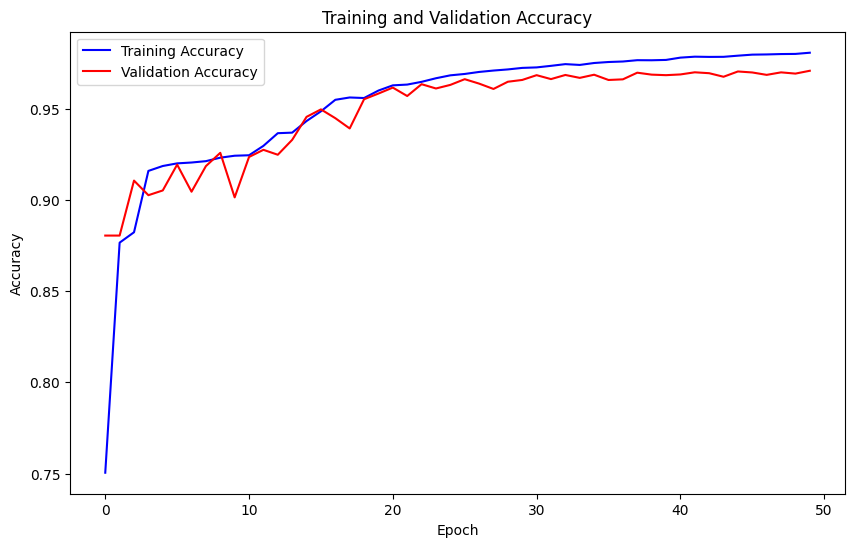

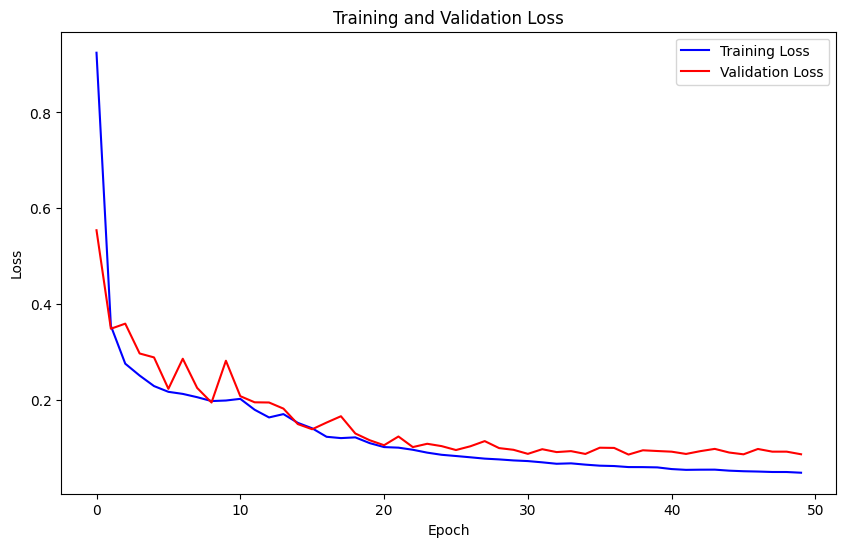

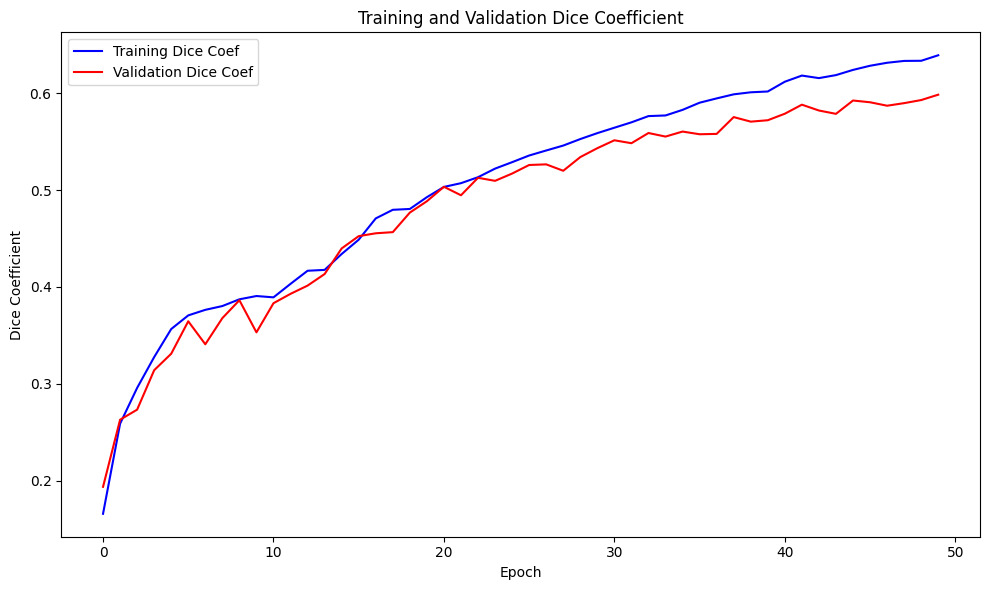

In [ ]:
history = pd.read_csv('img/Models/modelo1tfg32_001__.log', sep=',', engine='python')

plt.figure(figsize=(10, 6))

plt.plot(history['epoch'], history['accuracy'], 'b', label='Training Accuracy')
plt.plot(history['epoch'], history['val_accuracy'], 'r', label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['loss'], 'b', label='Training Loss')
plt.plot(history['epoch'], history['val_loss'], 'r', label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['dice_coef'], 'b', label='Training Dice Coef')
plt.plot(history['epoch'], history['val_dice_coef'], 'r', label='Validation Dice Coef')
plt.xlabel('Epoch')
plt.ylabel('Dice Coefficient')
plt.legend()
plt.title('Training and Validation Dice Coefficient')

plt.tight_layout()

plt.show()

In [ ]:
weight_path = 'img/Models/modelo1tfg32_001__.hdf5'

model.load_weights(weight_path)

y_pred=model.predict(X_test) #contiene las probabilidades
y_pred_argmax=np.argmax(y_pred, axis=3) #se pasa la probabilidad a binario

5/5 [==============================] - 10s 2s/step


In [ ]:
from sklearn.metrics import confusion_matrix

conf_matrix = confusion_matrix(y_test.flatten(), y_pred_argmax.flatten())
class_IoU = np.diag(conf_matrix) / (conf_matrix.sum(axis=1) + conf_matrix.sum(axis=0) - np.diag(conf_matrix))
mean_IoU = np.mean(class_IoU)

print("Mean IoU =", mean_IoU)
print("IoU for class1 (background) is:", class_IoU[0])
print("IoU for class2 (interior) is:", class_IoU[1])
print("IoU for class3 (miocardio) is:", class_IoU[2])
print("IoU for class4 (infarto) is:", class_IoU[3])
print("IoU for class5 (PMO) is:", class_IoU[4])

Mean IoU = 0.5644544549370429
IoU for class1 (background) is: 0.9828881892743008
IoU for class2 (interior) is: 0.858350848925744
IoU for class3 (miocardio) is: 0.6598750912482764
IoU for class4 (infarto) is: 0.32115814523689334
IoU for class5 (PMO) is: 0.0


In [ ]:
import numpy as np
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, confusion_matrix

y_pred_argmax_flat = y_pred_argmax.reshape(-1)
y_test_cat_flat = y_test_cat.reshape(-1, 5)


y_true_labels = np.argmax(y_test_cat_flat, axis=1)


accuracy = accuracy_score(y_true_labels, y_pred_argmax_flat)


precision = precision_score(y_true_labels, y_pred_argmax_flat, average=None)
recall = recall_score(y_true_labels, y_pred_argmax_flat, average=None)
f1 = f1_score(y_true_labels, y_pred_argmax_flat, average=None)


class_accuracies = []


for i in range(5):

    class_indices = np.where(y_true_labels == i)[0]

    class_predictions = y_pred_argmax_flat[class_indices]
    class_true_labels = y_true_labels[class_indices]

    class_accuracy = accuracy_score(class_true_labels, class_predictions)
    class_accuracies.append(class_accuracy)

class_iou = []
class_dice = []
class_jaccard = []
for i in range(5):
    class_mask_pred = (y_pred_argmax_flat == i)
    class_mask_true = (y_true_labels == i)

    intersection = np.sum(class_mask_pred & class_mask_true)
    union = np.sum(class_mask_pred | class_mask_true)

    iou = intersection / union if union != 0 else 0
    dice = 2 * intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true)) if (np.sum(class_mask_pred) + np.sum(class_mask_true)) != 0 else 0
    jaccard = intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) if (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) != 0 else 0
    class_iou.append(iou)
    class_dice.append(dice)
    class_jaccard.append(jaccard)

conf_matrix = confusion_matrix(y_true_labels, y_pred_argmax_flat)

conf_matrix_normalized = conf_matrix.astype('float') / conf_matrix.sum(axis=1)[:, np.newaxis]

print("Matriz de Confusión:")
print(conf_matrix)

print("\nMatriz de Confusión Normalizada:")
print(conf_matrix_normalized)

table_header = ["Clase", "Accuracy", "Precision", "Recall", "F1 Score", "IoU", "DICE", "Jaccard"]
table_data = []
for i in range(5):
    row = [f"Clase {i}", round(class_accuracies[i], 4), round(precision[i], 4), round(recall[i], 4), round(f1[i], 4), round(class_iou[i], 4), round(class_dice[i], 4), round(class_jaccard[i], 4)]
    table_data.append(row)

print("\nResultados por Clase:")
print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*table_header))
for row in table_data:
    print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*row))

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Matriz de Confusión:
[[2275625      11   13499    1720       0]
 [     39  141706   10008    3047       0]
 [  22141    7347  122034    3648       0]
 [   2145    2778    5180    8907       0]
 [     63     155    1078     309       0]]

Matriz de Confusión Normalizada:
[[9.93351827e-01 4.80170068e-06 5.89255976e-03 7.50811378e-04
  0.00000000e+00]
 [2.51937984e-04 9.15413437e-01 6.46511628e-02 1.96834625e-02
  0.00000000e+00]
 [1.42688664e-01 4.73480699e-02 7.86453567e-01 2.35096990e-02
  0.00000000e+00]
 [1.12835350e-01 1.46133614e-01 2.72488164e-01 4.68542872e-01
  0.00000000e+00]
 [3.92523364e-02 9.65732087e-02 6.71651090e-01 1.92523364e-01
  0.00000000e+00]]

Resultados por Clase:
Clase      Accuracy   Precision  Recall     F1 Score   IoU        DICE       Jaccard   
Clase 0    0.9934     0.9894     0.9934     0.9914     0.9829     0.9914     0.9829    
Clase 1    0.9154     0.9323     0.9154     0.9238     0.8584     0.9238     0.8584    
Clase 2    0.7865     0.8039     0.7865  

### Predicción de las imágenes

In [ ]:
def mostrar_imagen_y_mascaras(index):
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    etiqueta_colores = {
        0: (0, 0, 0, 1),          # Etiqueta 0: Negro (background)
        1: (0.6, 0.8, 0.6, 1),    # Etiqueta 1: Verde claro (ventrículo izquierdo)
        2: (1, 1, 0.6, 1),        # Etiqueta 2: Amarillo pálido (miocardio sano)
        3: (0.8, 0.4, 0.4, 1),    # Etiqueta 3: Rojo suave (miocardio patológico)
        4: 'lightblue'            # Etiqueta 4: Azul claro (PMO)
    }

    etiqueta_rgbas = [mcolors.to_rgba(etiqueta_colores[i]) for i in range(len(etiqueta_colores))]

    etiqueta_cmap = mcolors.ListedColormap(etiqueta_rgbas, N=len(etiqueta_colores))

    ax[0].imshow(X_test[index].squeeze(), cmap='gray')
    ax[0].set_title('Imagen Original')
    ax[0].text(0.5, -0.1, test_image_names[index], size=10, ha="center", transform=ax[0].transAxes)

    ax[1].imshow(y_test[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[1].set_title('Máscara Real')
    ax[1].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[1].transAxes)

    ax[2].imshow(y_pred_argmax[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[2].set_title('Máscara Predicha')
    ax[2].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[2].transAxes)

    plt.show()

for i in range(1, 159):
    mostrar_imagen_y_mascaras(i)

Output hidden; open in https://colab.research.google.com to view.

## Entrenamiento del modelo 1, 64, 0.001

In [ ]:
def get_model():
    return multi_unet_model(n_classes=n_classes, img_alt=img_alt, img_anch=img_anch, canales=canales)

model = get_model()
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics = ['accuracy', dice_coef, precision, sensitivity, specificity],run_eagerly=True)
model.summary()

callbacks = [
    keras.callbacks.ModelCheckpoint(filepath = 'img/Models/modelo1tfg64_001.{epoch:02d}-{val_loss:.6f}.m5',
                             verbose=1, save_best_only=True, save_weights_only = True),
    CSVLogger('img/Models/modelo1tfg64_001.log', separator=',', append=False)
]

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 128, 128, 1)]        0         []                            
                                                                                                  
 conv2d_57 (Conv2D)          (None, 128, 128, 16)         160       ['input_4[0][0]']             
                                                                                                  
 dropout_27 (Dropout)        (None, 128, 128, 16)         0         ['conv2d_57[0][0]']           
                                                                                                  
 conv2d_58 (Conv2D)          (None, 128, 128, 16)         2320      ['dropout_27[0][0]']          
                                                                                            

In [ ]:
history= model.fit(X_train,y_train_cat,
          batch_size = 64,
          epochs=50,
          callbacks=callbacks,
          validation_data=(X_val, y_val_cat))

save_directory = 'img/Models'
if not os.path.exists(save_directory):
    os.makedirs(save_directory)

model.save(os.path.join(save_directory, 'modelo1tfg64_001.hdf5'))

Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 1.2846 - accuracy: 0.6946 - dice_coef: 0.1326 - precision: 0.6715 - sensitivity: 0.1586 - specificity: 0.9825 
Epoch 1: val_loss improved from inf to 0.80305, saving model to img/Models/modelo1tfg64_001.01-0.803048.m5
12/12 [==============================] - 266s 20s/step - loss: 1.2846 - accuracy: 0.6946 - dice_coef: 0.1326 - precision: 0.6715 - sensitivity: 0.1586 - specificity: 0.9825 - val_loss: 0.8030 - val_accuracy: 0.8804 - val_dice_coef: 0.1708 - val_precision: 0.8743 - val_sensitivity: 0.8187 - val_specificity: 0.9706
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 0.7509 - accuracy: 0.8769 - dice_coef: 0.1823 - precision: 0.8732 - sensitivity: 0.8463 - specificity: 0.9693 
Epoch 2: val_loss improved from 0.80305 to 0.62796, saving model to img/Models/modelo1tfg64_001.02-0.627963.m5
12/12 [==============================] - 185s 15s/step - loss: 0.7509 - accuracy: 0.8769 - dice_coef: 0.1823 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


### Evaluación del modelo

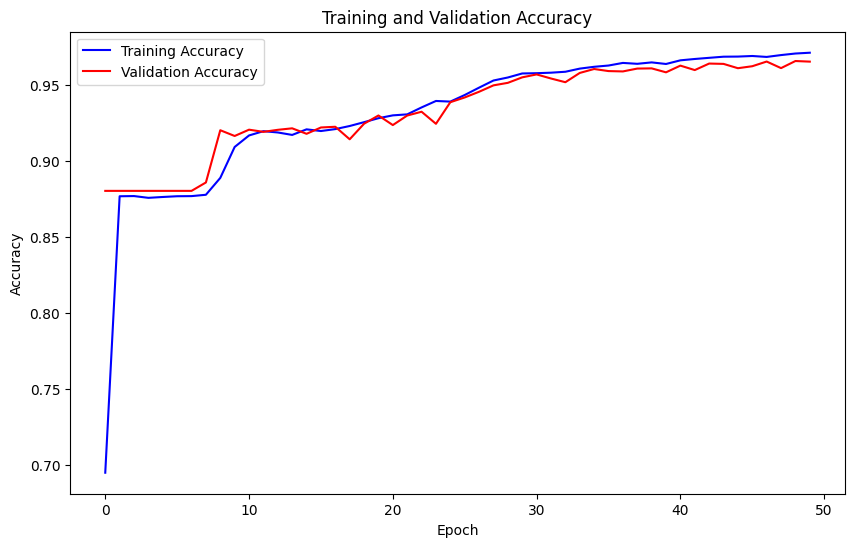

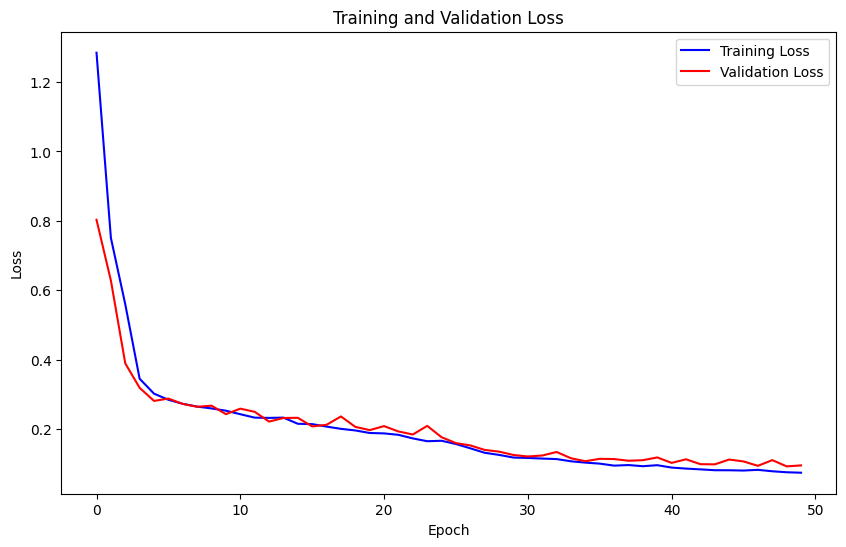

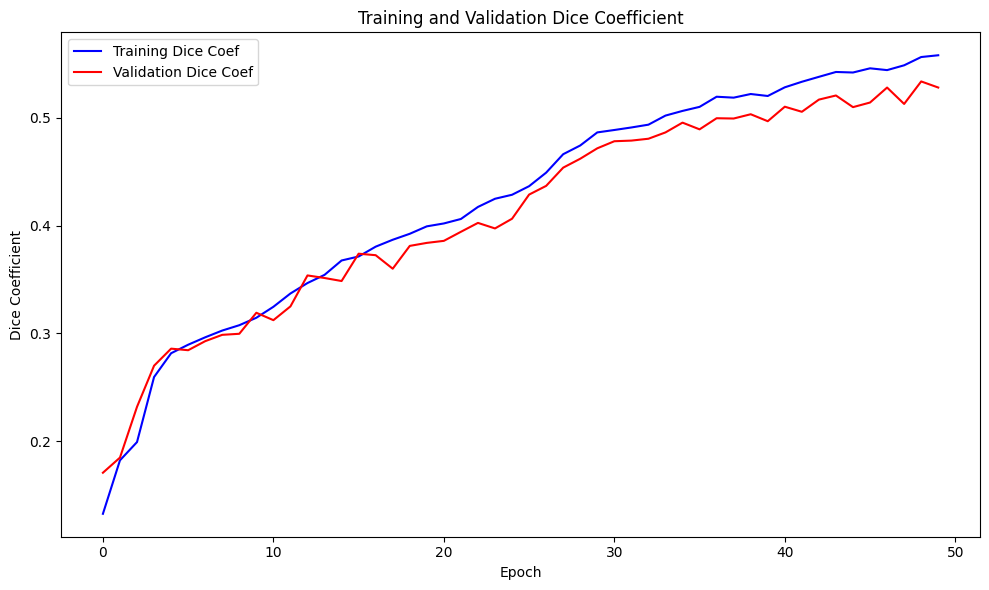

In [ ]:
history = pd.read_csv('img/Models/modelo1tfg64_001.log', sep=',', engine='python')

plt.figure(figsize=(10, 6))

plt.plot(history['epoch'], history['accuracy'], 'b', label='Training Accuracy')
plt.plot(history['epoch'], history['val_accuracy'], 'r', label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['loss'], 'b', label='Training Loss')
plt.plot(history['epoch'], history['val_loss'], 'r', label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['dice_coef'], 'b', label='Training Dice Coef')
plt.plot(history['epoch'], history['val_dice_coef'], 'r', label='Validation Dice Coef')
plt.xlabel('Epoch')
plt.ylabel('Dice Coefficient')
plt.legend()
plt.title('Training and Validation Dice Coefficient')

plt.tight_layout()

plt.show()

In [ ]:
weight_path = 'img/Models/modelo1tfg64_001.hdf5'

model.load_weights(weight_path)

y_pred=model.predict(X_test) #contiene las probabilidades
y_pred_argmax=np.argmax(y_pred, axis=3) #se pasa la probabilidad a binario

5/5 [==============================] - 15s 3s/step


In [ ]:
from sklearn.metrics import confusion_matrix

conf_matrix = confusion_matrix(y_test.flatten(), y_pred_argmax.flatten())
class_IoU = np.diag(conf_matrix) / (conf_matrix.sum(axis=1) + conf_matrix.sum(axis=0) - np.diag(conf_matrix))
mean_IoU = np.mean(class_IoU)

print("Mean IoU =", mean_IoU)
print("IoU for class1 (background) is:", class_IoU[0])
print("IoU for class2 (interior) is:", class_IoU[1])
print("IoU for class3 (miocardio) is:", class_IoU[2])
print("IoU for class4 (infarto) is:", class_IoU[3])
print("IoU for class5 (PMO) is:", class_IoU[4])

Mean IoU = 0.4984557080402892
IoU for class1 (background) is: 0.9808579202368011
IoU for class2 (interior) is: 0.8141579837822152
IoU for class3 (miocardio) is: 0.6283222839395568
IoU for class4 (infarto) is: 0.06894035224287243
IoU for class5 (PMO) is: 0.0


In [ ]:
import numpy as np
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, confusion_matrix

y_pred_argmax_flat = y_pred_argmax.reshape(-1)
y_test_cat_flat = y_test_cat.reshape(-1, 5)


y_true_labels = np.argmax(y_test_cat_flat, axis=1)


accuracy = accuracy_score(y_true_labels, y_pred_argmax_flat)


precision = precision_score(y_true_labels, y_pred_argmax_flat, average=None)
recall = recall_score(y_true_labels, y_pred_argmax_flat, average=None)
f1 = f1_score(y_true_labels, y_pred_argmax_flat, average=None)


class_accuracies = []


for i in range(5):

    class_indices = np.where(y_true_labels == i)[0]

    class_predictions = y_pred_argmax_flat[class_indices]
    class_true_labels = y_true_labels[class_indices]

    class_accuracy = accuracy_score(class_true_labels, class_predictions)
    class_accuracies.append(class_accuracy)

class_iou = []
class_dice = []
class_jaccard = []
for i in range(5):
    class_mask_pred = (y_pred_argmax_flat == i)
    class_mask_true = (y_true_labels == i)

    intersection = np.sum(class_mask_pred & class_mask_true)
    union = np.sum(class_mask_pred | class_mask_true)

    iou = intersection / union if union != 0 else 0
    dice = 2 * intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true)) if (np.sum(class_mask_pred) + np.sum(class_mask_true)) != 0 else 0
    jaccard = intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) if (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) != 0 else 0
    class_iou.append(iou)
    class_dice.append(dice)
    class_jaccard.append(jaccard)

conf_matrix = confusion_matrix(y_true_labels, y_pred_argmax_flat)

conf_matrix_normalized = conf_matrix.astype('float') / conf_matrix.sum(axis=1)[:, np.newaxis]

print("Matriz de Confusión:")
print(conf_matrix)

print("\nMatriz de Confusión Normalizada:")
print(conf_matrix_normalized)

table_header = ["Clase", "Accuracy", "Precision", "Recall", "F1 Score", "IoU", "DICE", "Jaccard"]
table_data = []
for i in range(5):
    row = [f"Clase {i}", round(class_accuracies[i], 4), round(precision[i], 4), round(recall[i], 4), round(f1[i], 4), round(class_iou[i], 4), round(class_dice[i], 4), round(class_jaccard[i], 4)]
    table_data.append(row)

print("\nResultados por Clase:")
print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*table_header))
for row in table_data:
    print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*row))

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Matriz de Confusión:
[[2271869     457   17688     841       0]
 [    258  148697    5676     169       0]
 [  21585   17393  115720     472       0]
 [   3149    9445    4999    1417       0]
 [    359     544     640      62       0]]

Matriz de Confusión Normalizada:
[[9.91712265e-01 1.99488837e-04 7.72113469e-03 3.67111843e-04
  0.00000000e+00]
 [1.66666667e-03 9.60574935e-01 3.66666667e-02 1.09173127e-03
  0.00000000e+00]
 [1.39105497e-01 1.12089966e-01 7.45762712e-01 3.04182510e-03
  0.00000000e+00]
 [1.65649658e-01 4.96843766e-01 2.62966860e-01 7.45397159e-02
  0.00000000e+00]
 [2.23676012e-01 3.38940810e-01 3.98753894e-01 3.86292835e-02
  0.00000000e+00]]

Resultados por Clase:
Clase      Accuracy   Precision  Recall     F1 Score   IoU        DICE       Jaccard   
Clase 0    0.9917     0.989      0.9917     0.9903     0.9809     0.9903     0.9809    
Clase 1    0.9606     0.8423     0.9606     0.8976     0.8142     0.8976     0.8142    
Clase 2    0.7458     0.7996     0.7458  

### Predicción de las imágenes

In [ ]:
def mostrar_imagen_y_mascaras(index):
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    etiqueta_colores = {
        0: (0, 0, 0, 1),          # Etiqueta 0: Negro (background)
        1: (0.6, 0.8, 0.6, 1),    # Etiqueta 1: Verde claro (ventrículo izquierdo)
        2: (1, 1, 0.6, 1),        # Etiqueta 2: Amarillo pálido (miocardio sano)
        3: (0.8, 0.4, 0.4, 1),    # Etiqueta 3: Rojo suave (miocardio patológico)
        4: 'lightblue'            # Etiqueta 4: Azul claro (PMO)
    }

    etiqueta_rgbas = [mcolors.to_rgba(etiqueta_colores[i]) for i in range(len(etiqueta_colores))]

    etiqueta_cmap = mcolors.ListedColormap(etiqueta_rgbas, N=len(etiqueta_colores))

    ax[0].imshow(X_test[index].squeeze(), cmap='gray')
    ax[0].set_title('Imagen Original')
    ax[0].text(0.5, -0.1, test_image_names[index], size=10, ha="center", transform=ax[0].transAxes)

    ax[1].imshow(y_test[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[1].set_title('Máscara Real')
    ax[1].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[1].transAxes)

    ax[2].imshow(y_pred_argmax[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[2].set_title('Máscara Predicha')
    ax[2].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[2].transAxes)

    plt.show()

for i in range(1, 159):
    mostrar_imagen_y_mascaras(i)

Output hidden; open in https://colab.research.google.com to view.

## Entrenamiento del modelo 1, 16, 0.0001

In [ ]:
def get_model():
    return multi_unet_model(n_classes=n_classes, img_alt=img_alt, img_anch=img_anch, canales=canales)

model = get_model()
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics = ['accuracy', dice_coef, precision, sensitivity, specificity],run_eagerly=True)
model.summary()

callbacks = [
    keras.callbacks.ModelCheckpoint(filepath = 'img/Models/modelo1tfg16_0001.{epoch:02d}-{val_loss:.6f}.m5',
                             verbose=1, save_best_only=True, save_weights_only = True),
    CSVLogger('img/Models/modelo1tfg16_0001.log', separator=',', append=False)
]

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 128, 128, 1)]        0         []                            
                                                                                                  
 conv2d_76 (Conv2D)          (None, 128, 128, 16)         160       ['input_5[0][0]']             
                                                                                                  
 dropout_36 (Dropout)        (None, 128, 128, 16)         0         ['conv2d_76[0][0]']           
                                                                                                  
 conv2d_77 (Conv2D)          (None, 128, 128, 16)         2320      ['dropout_36[0][0]']          
                                                                                            

In [ ]:
history= model.fit(X_train,y_train_cat,
          batch_size = 16,
          epochs=50,
          callbacks=callbacks,
          validation_data=(X_val, y_val_cat))

save_directory = 'img/Models'
if not os.path.exists(save_directory):
    os.makedirs(save_directory)

model.save(os.path.join(save_directory, 'modelo1tfg16_0001.hdf5'))

Epoch 1/50
47/47 [==============================] - ETA: 0s - loss: 1.2213 - accuracy: 0.5428 - dice_coef: 0.1443 - precision: 0.5887 - sensitivity: 0.2872 - specificity: 0.9820
Epoch 1: val_loss improved from inf to 0.87348, saving model to img/Models/modelo1tfg16_0001.01-0.873480.m5
47/47 [==============================] - 335s 7s/step - loss: 1.2213 - accuracy: 0.5428 - dice_coef: 0.1443 - precision: 0.5887 - sensitivity: 0.2872 - specificity: 0.9820 - val_loss: 0.8735 - val_accuracy: 0.8342 - val_dice_coef: 0.1699 - val_precision: 0.9946 - val_sensitivity: 0.4085 - val_specificity: 0.9994
Epoch 2/50
47/47 [==============================] - ETA: 0s - loss: 0.3776 - accuracy: 0.8615 - dice_coef: 0.2630 - precision: 0.9414 - sensitivity: 0.8218 - specificity: 0.9871
Epoch 2: val_loss improved from 0.87348 to 0.52319, saving model to img/Models/modelo1tfg16_0001.02-0.523194.m5
47/47 [==============================] - 324s 7s/step - loss: 0.3776 - accuracy: 0.8615 - dice_coef: 0.2630 - 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


### Evaluación del modelo

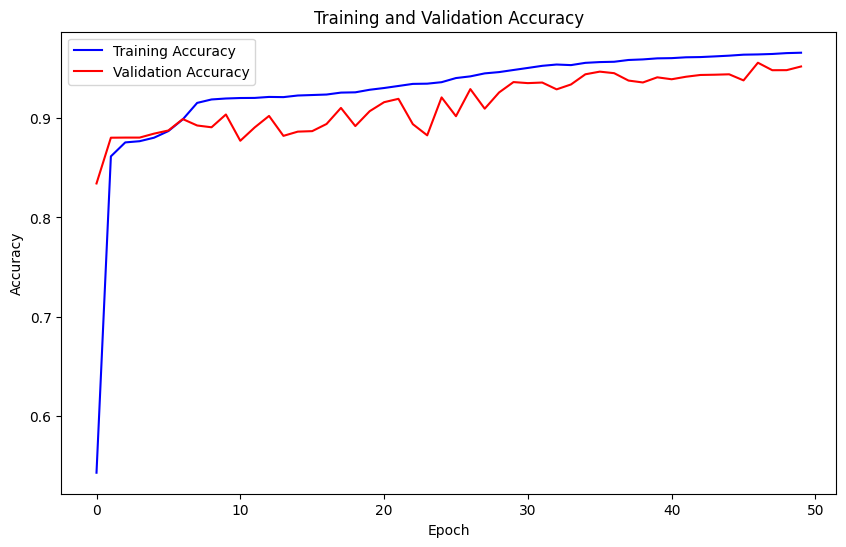

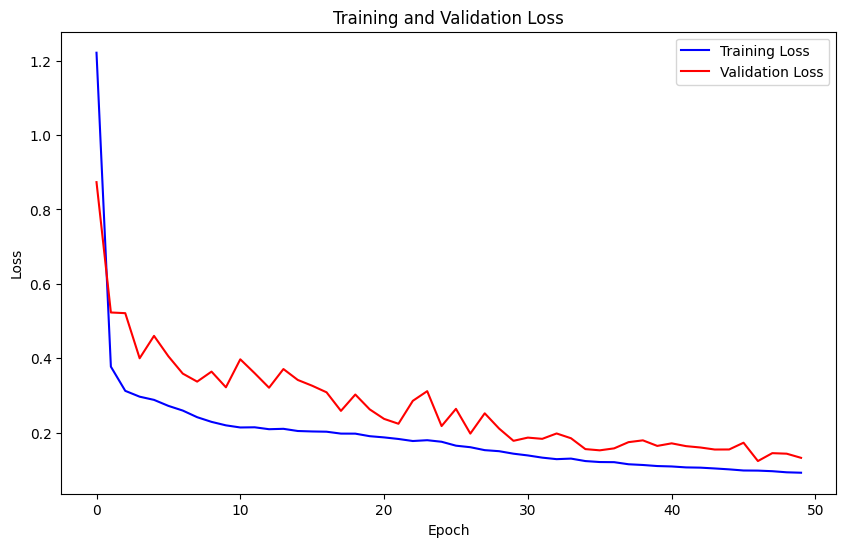

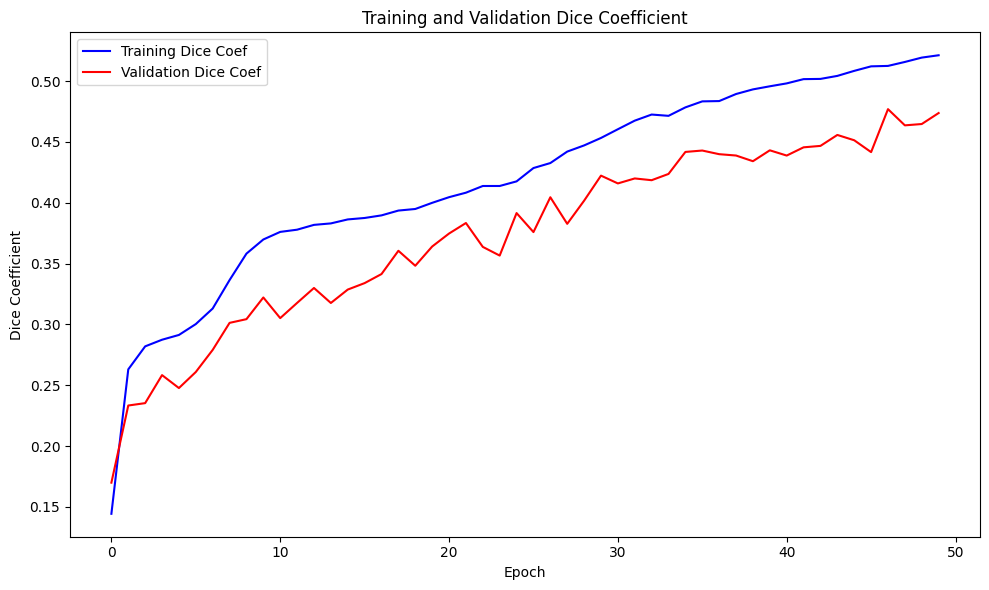

In [ ]:
history = pd.read_csv('img/Models/modelo1tfg16_0001.log', sep=',', engine='python')

plt.figure(figsize=(10, 6))

plt.plot(history['epoch'], history['accuracy'], 'b', label='Training Accuracy')
plt.plot(history['epoch'], history['val_accuracy'], 'r', label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['loss'], 'b', label='Training Loss')
plt.plot(history['epoch'], history['val_loss'], 'r', label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['dice_coef'], 'b', label='Training Dice Coef')
plt.plot(history['epoch'], history['val_dice_coef'], 'r', label='Validation Dice Coef')
plt.xlabel('Epoch')
plt.ylabel('Dice Coefficient')
plt.legend()
plt.title('Training and Validation Dice Coefficient')

plt.tight_layout()

plt.show()

In [ ]:
weight_path = 'img/Models/modelo1tfg16_0001.hdf5'

model.load_weights(weight_path)

y_pred=model.predict(X_test) #contiene las probabilidades
y_pred_argmax=np.argmax(y_pred, axis=3) #se pasa la probabilidad a binario

5/5 [==============================] - 7s 1s/step


In [ ]:
conf_matrix = confusion_matrix(y_test.flatten(), y_pred_argmax.flatten())
class_IoU = np.diag(conf_matrix) / (conf_matrix.sum(axis=1) + conf_matrix.sum(axis=0) - np.diag(conf_matrix))
mean_IoU = np.mean(class_IoU)

print("Mean IoU =", mean_IoU)
print("IoU for class1 (background) is:", class_IoU[0])
print("IoU for class2 (interior) is:", class_IoU[1])
print("IoU for class3 (miocardio) is:", class_IoU[2])
print("IoU for class4 (infarto) is:", class_IoU[3])
print("IoU for class5 (PMO) is:", class_IoU[4])

Mean IoU = 0.45579470835032093
IoU for class1 (background) is: 0.9718863165923624
IoU for class2 (interior) is: 0.7771648207365367
IoU for class3 (miocardio) is: 0.5268841645065191
IoU for class4 (infarto) is: 0.003038239916186485
IoU for class5 (PMO) is: 0.0


In [ ]:
y_pred_argmax_flat = y_pred_argmax.reshape(-1)
y_test_cat_flat = y_test_cat.reshape(-1, 5)


y_true_labels = np.argmax(y_test_cat_flat, axis=1)


accuracy = accuracy_score(y_true_labels, y_pred_argmax_flat)


precision = precision_score(y_true_labels, y_pred_argmax_flat, average=None)
recall = recall_score(y_true_labels, y_pred_argmax_flat, average=None)
f1 = f1_score(y_true_labels, y_pred_argmax_flat, average=None)


class_accuracies = []


for i in range(5):

    class_indices = np.where(y_true_labels == i)[0]

    class_predictions = y_pred_argmax_flat[class_indices]
    class_true_labels = y_true_labels[class_indices]

    class_accuracy = accuracy_score(class_true_labels, class_predictions)
    class_accuracies.append(class_accuracy)

class_iou = []
class_dice = []
class_jaccard = []
for i in range(5):
    class_mask_pred = (y_pred_argmax_flat == i)
    class_mask_true = (y_true_labels == i)

    intersection = np.sum(class_mask_pred & class_mask_true)
    union = np.sum(class_mask_pred | class_mask_true)

    iou = intersection / union if union != 0 else 0
    dice = 2 * intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true)) if (np.sum(class_mask_pred) + np.sum(class_mask_true)) != 0 else 0
    jaccard = intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) if (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) != 0 else 0
    class_iou.append(iou)
    class_dice.append(dice)
    class_jaccard.append(jaccard)

conf_matrix = confusion_matrix(y_true_labels, y_pred_argmax_flat)

conf_matrix_normalized = conf_matrix.astype('float') / conf_matrix.sum(axis=1)[:, np.newaxis]

print("Matriz de Confusión:")
print(conf_matrix)

print("\nMatriz de Confusión Normalizada:")
print(conf_matrix_normalized)

table_header = ["Clase", "Accuracy", "Precision", "Recall", "F1 Score", "IoU", "DICE", "Jaccard"]
table_data = []
for i in range(5):
    row = [f"Clase {i}", round(class_accuracies[i], 4), round(precision[i], 4), round(recall[i], 4), round(f1[i], 4), round(class_iou[i], 4), round(class_dice[i], 4), round(class_jaccard[i], 4)]
    table_data.append(row)

print("\nResultados por Clase:")
print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*table_header))
for row in table_data:
    print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*row))

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Matriz de Confusión:
[[2252780    1400   36623      52       0]
 [    527  146794    7461      18       0]
 [  22905   23308  108947      10       0]
 [   3547    8879    6526      58       0]
 [    112     497     996       0       0]]

Matriz de Confusión Normalizada:
[[9.83379568e-01 6.11125540e-04 1.59866076e-02 2.26989486e-05
  0.00000000e+00]
 [3.40439276e-03 9.48281654e-01 4.81976744e-02 1.16279070e-04
  0.00000000e+00]
 [1.47612296e-01 1.50209448e-01 7.02113811e-01 6.44454469e-05
  0.00000000e+00]
 [1.86586007e-01 4.67069963e-01 3.43293004e-01 3.05102578e-03
  0.00000000e+00]
 [6.97819315e-02 3.09657321e-01 6.20560748e-01 0.00000000e+00
  0.00000000e+00]]

Resultados por Clase:
Clase      Accuracy   Precision  Recall     F1 Score   IoU        DICE       Jaccard   
Clase 0    0.9834     0.9881     0.9834     0.9857     0.9719     0.9857     0.9719    
Clase 1    0.9483     0.8116     0.9483     0.8746     0.7772     0.8746     0.7772    
Clase 2    0.7021     0.6786     0.7021  

### Predicción de las imágenes

In [ ]:
def mostrar_imagen_y_mascaras(index):
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    etiqueta_colores = {
        0: (0, 0, 0, 1),          # Etiqueta 0: Negro (background)
        1: (0.6, 0.8, 0.6, 1),    # Etiqueta 1: Verde claro (ventrículo izquierdo)
        2: (1, 1, 0.6, 1),        # Etiqueta 2: Amarillo pálido (miocardio sano)
        3: (0.8, 0.4, 0.4, 1),    # Etiqueta 3: Rojo suave (miocardio patológico)
        4: 'lightblue'            # Etiqueta 4: Azul claro (PMO)
    }

    etiqueta_rgbas = [mcolors.to_rgba(etiqueta_colores[i]) for i in range(len(etiqueta_colores))]

    etiqueta_cmap = mcolors.ListedColormap(etiqueta_rgbas, N=len(etiqueta_colores))

    ax[0].imshow(X_test[index].squeeze(), cmap='gray')
    ax[0].set_title('Imagen Original')
    ax[0].text(0.5, -0.1, test_image_names[index], size=10, ha="center", transform=ax[0].transAxes)

    ax[1].imshow(y_test[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[1].set_title('Máscara Real')
    ax[1].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[1].transAxes)

    ax[2].imshow(y_pred_argmax[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[2].set_title('Máscara Predicha')
    ax[2].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[2].transAxes)

    plt.show()

for i in range(1, 159):
    mostrar_imagen_y_mascaras(i)

Output hidden; open in https://colab.research.google.com to view.

## Entrenamiento del modelo 1, 32, 0.0001

In [ ]:
def get_model():
    return multi_unet_model(n_classes=n_classes, img_alt=img_alt, img_anch=img_anch, canales=canales)

model = get_model()
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics = ['accuracy', dice_coef, precision, sensitivity, specificity],run_eagerly=True)
model.summary()

callbacks = [
    keras.callbacks.ModelCheckpoint(filepath = 'img/Models/modelo1tfg32_0001.{epoch:02d}-{val_loss:.6f}.m5',
                             verbose=1, save_best_only=True, save_weights_only = True),
    CSVLogger('img/Models/modelo1tfg32_0001.log', separator=',', append=False)
]

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_6 (InputLayer)        [(None, 128, 128, 1)]        0         []                            
                                                                                                  
 conv2d_95 (Conv2D)          (None, 128, 128, 16)         160       ['input_6[0][0]']             
                                                                                                  
 dropout_45 (Dropout)        (None, 128, 128, 16)         0         ['conv2d_95[0][0]']           
                                                                                                  
 conv2d_96 (Conv2D)          (None, 128, 128, 16)         2320      ['dropout_45[0][0]']          
                                                                                            

In [ ]:
history= model.fit(X_train,y_train_cat,
          batch_size = 32,
          epochs=50,
          callbacks=callbacks,
          validation_data=(X_val, y_val_cat))

save_directory = 'img/Models'
if not os.path.exists(save_directory):
    os.makedirs(save_directory)

model.save(os.path.join(save_directory, 'modelo1tfg32_0001.hdf5'))

Epoch 1/50
24/24 [==============================] - ETA: 0s - loss: 1.6174 - accuracy: 0.0599 - dice_coef: 0.1037 - precision: 0.0000e+00 - sensitivity: 0.0000e+00 - specificity: 1.0000
Epoch 1: val_loss improved from inf to 1.59652, saving model to img/Models/modelo1tfg32_0001.01-1.596520.m5
24/24 [==============================] - 175s 7s/step - loss: 1.6174 - accuracy: 0.0599 - dice_coef: 0.1037 - precision: 0.0000e+00 - sensitivity: 0.0000e+00 - specificity: 1.0000 - val_loss: 1.5965 - val_accuracy: 0.0601 - val_dice_coef: 0.1041 - val_precision: 0.0000e+00 - val_sensitivity: 0.0000e+00 - val_specificity: 1.0000
Epoch 2/50
24/24 [==============================] - ETA: 0s - loss: 1.5780 - accuracy: 0.0630 - dice_coef: 0.1067 - precision: 0.0710 - sensitivity: 1.3049e-05 - specificity: 1.0000
Epoch 2: val_loss improved from 1.59652 to 1.54043, saving model to img/Models/modelo1tfg32_0001.02-1.540425.m5
24/24 [==============================] - 165s 7s/step - loss: 1.5780 - accuracy: 0

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


### Evaluación del modelo

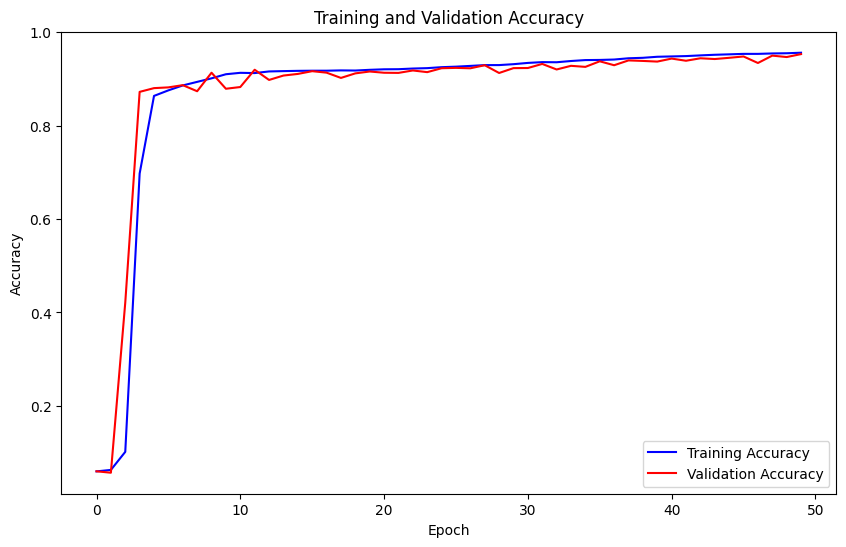

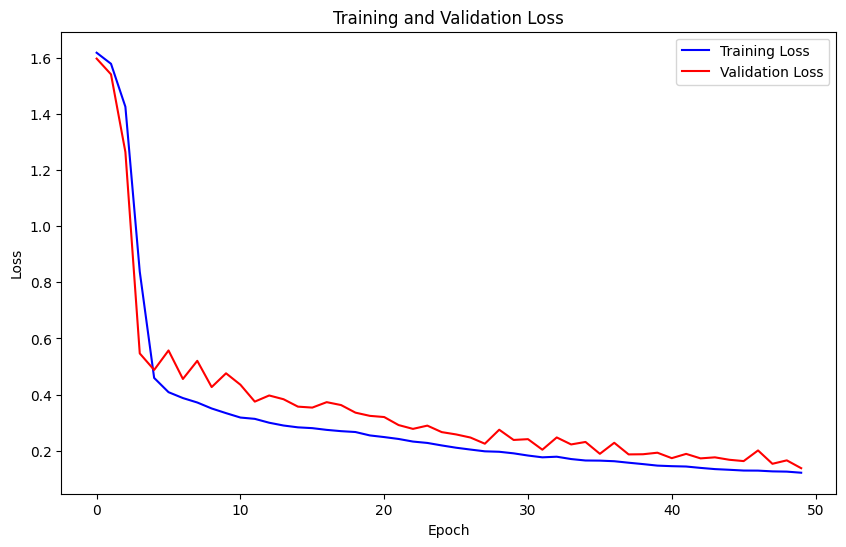

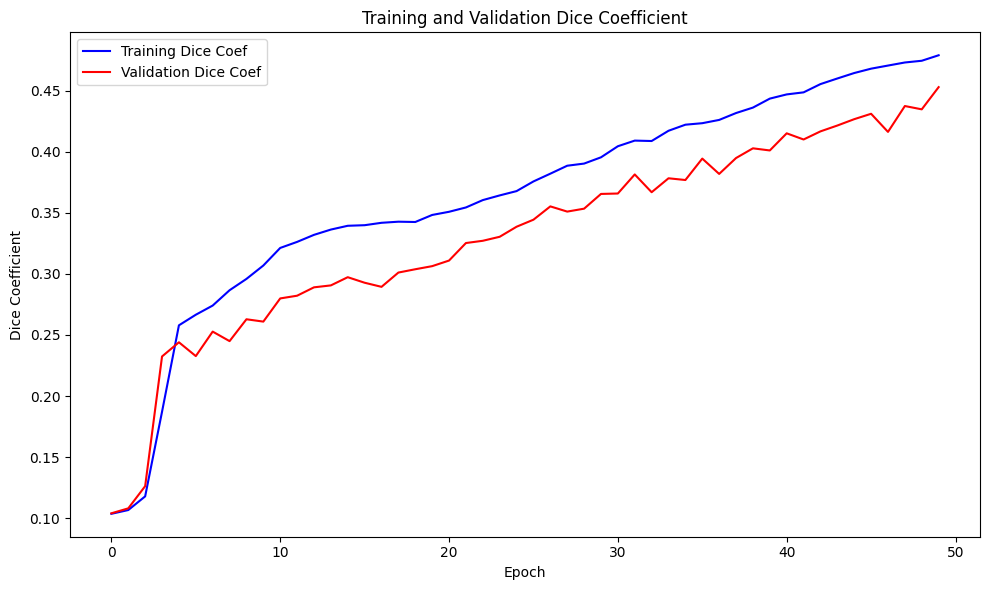

In [ ]:
history = pd.read_csv('img/Models/modelo1tfg32_0001.log', sep=',', engine='python')

plt.figure(figsize=(10, 6))

plt.plot(history['epoch'], history['accuracy'], 'b', label='Training Accuracy')
plt.plot(history['epoch'], history['val_accuracy'], 'r', label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['loss'], 'b', label='Training Loss')
plt.plot(history['epoch'], history['val_loss'], 'r', label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['dice_coef'], 'b', label='Training Dice Coef')
plt.plot(history['epoch'], history['val_dice_coef'], 'r', label='Validation Dice Coef')
plt.xlabel('Epoch')
plt.ylabel('Dice Coefficient')
plt.legend()
plt.title('Training and Validation Dice Coefficient')

plt.tight_layout()

plt.show()

In [ ]:
weight_path = 'img/Models/modelo1tfg32_0001.hdf5'

model.load_weights(weight_path)

y_pred=model.predict(X_test) #contiene las probabilidades
y_pred_argmax=np.argmax(y_pred, axis=3) #se pasa la probabilidad a binario

5/5 [==============================] - 10s 2s/step


In [ ]:
from sklearn.metrics import confusion_matrix

conf_matrix = confusion_matrix(y_test.flatten(), y_pred_argmax.flatten())
class_IoU = np.diag(conf_matrix) / (conf_matrix.sum(axis=1) + conf_matrix.sum(axis=0) - np.diag(conf_matrix))
mean_IoU = np.mean(class_IoU)

print("Mean IoU =", mean_IoU)
print("IoU for class1 (background) is:", class_IoU[0])
print("IoU for class2 (interior) is:", class_IoU[1])
print("IoU for class3 (miocardio) is:", class_IoU[2])
print("IoU for class4 (infarto) is:", class_IoU[3])
print("IoU for class5 (PMO) is:", class_IoU[4])

Mean IoU = 0.44254042860346116
IoU for class1 (background) is: 0.9686132676409056
IoU for class2 (interior) is: 0.7457794618677382
IoU for class3 (miocardio) is: 0.4982568206823236
IoU for class4 (infarto) is: 5.259282633848743e-05
IoU for class5 (PMO) is: 0.0


In [ ]:
y_pred_argmax_flat = y_pred_argmax.reshape(-1)
y_test_cat_flat = y_test_cat.reshape(-1, 5)


y_true_labels = np.argmax(y_test_cat_flat, axis=1)


accuracy = accuracy_score(y_true_labels, y_pred_argmax_flat)


precision = precision_score(y_true_labels, y_pred_argmax_flat, average=None)
recall = recall_score(y_true_labels, y_pred_argmax_flat, average=None)
f1 = f1_score(y_true_labels, y_pred_argmax_flat, average=None)


class_accuracies = []


for i in range(5):

    class_indices = np.where(y_true_labels == i)[0]

    class_predictions = y_pred_argmax_flat[class_indices]
    class_true_labels = y_true_labels[class_indices]

    class_accuracy = accuracy_score(class_true_labels, class_predictions)
    class_accuracies.append(class_accuracy)

class_iou = []
class_dice = []
class_jaccard = []
for i in range(5):
    class_mask_pred = (y_pred_argmax_flat == i)
    class_mask_true = (y_true_labels == i)

    intersection = np.sum(class_mask_pred & class_mask_true)
    union = np.sum(class_mask_pred | class_mask_true)

    iou = intersection / union if union != 0 else 0
    dice = 2 * intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true)) if (np.sum(class_mask_pred) + np.sum(class_mask_true)) != 0 else 0
    jaccard = intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) if (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) != 0 else 0
    class_iou.append(iou)
    class_dice.append(dice)
    class_jaccard.append(jaccard)

conf_matrix = confusion_matrix(y_true_labels, y_pred_argmax_flat)

conf_matrix_normalized = conf_matrix.astype('float') / conf_matrix.sum(axis=1)[:, np.newaxis]

print("Matriz de Confusión:")
print(conf_matrix)

print("\nMatriz de Confusión Normalizada:")
print(conf_matrix_normalized)

table_header = ["Clase", "Accuracy", "Precision", "Recall", "F1 Score", "IoU", "DICE", "Jaccard"]
table_data = []
for i in range(5):
    row = [f"Clase {i}", round(class_accuracies[i], 4), round(precision[i], 4), round(recall[i], 4), round(f1[i], 4), round(class_iou[i], 4), round(class_dice[i], 4), round(class_jaccard[i], 4)]
    table_data.append(row)

print("\nResultados por Clase:")
print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*table_header))
for row in table_data:
    print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*row))

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Matriz de Confusión:
[[2253379    2668   34806       2       0]
 [   1633  136591   16576       0       0]
 [  29289   18549  107330       2       0]
 [   4423    6830    7756       1       0]
 [    197     305    1103       0       0]]

Matriz de Confusión Normalizada:
[[9.83641042e-01 1.16463067e-03 1.51934540e-02 8.73036486e-07
  0.00000000e+00]
 [1.05490956e-02 8.82370801e-01 1.07080103e-01 0.00000000e+00
  0.00000000e+00]
 [1.88754270e-01 1.19539860e-01 6.91692982e-01 1.28890894e-05
  0.00000000e+00]
 [2.32667017e-01 3.59284587e-01 4.07995792e-01 5.26038927e-05
  0.00000000e+00]
 [1.22741433e-01 1.90031153e-01 6.87227414e-01 0.00000000e+00
  0.00000000e+00]]

Resultados por Clase:
Clase      Accuracy   Precision  Recall     F1 Score   IoU        DICE       Jaccard   
Clase 0    0.9836     0.9845     0.9836     0.9841     0.9686     0.9841     0.9686    
Clase 1    0.8824     0.8281     0.8824     0.8544     0.7458     0.8544     0.7458    
Clase 2    0.6917     0.6405     0.6917  

### Predicción de las imágenes

In [ ]:
def mostrar_imagen_y_mascaras(index):
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    etiqueta_colores = {
        0: (0, 0, 0, 1),          # Etiqueta 0: Negro (background)
        1: (0.6, 0.8, 0.6, 1),    # Etiqueta 1: Verde claro (ventrículo izquierdo)
        2: (1, 1, 0.6, 1),        # Etiqueta 2: Amarillo pálido (miocardio sano)
        3: (0.8, 0.4, 0.4, 1),    # Etiqueta 3: Rojo suave (miocardio patológico)
        4: 'lightblue'            # Etiqueta 4: Azul claro (PMO)
    }

    etiqueta_rgbas = [mcolors.to_rgba(etiqueta_colores[i]) for i in range(len(etiqueta_colores))]

    etiqueta_cmap = mcolors.ListedColormap(etiqueta_rgbas, N=len(etiqueta_colores))

    ax[0].imshow(X_test[index].squeeze(), cmap='gray')
    ax[0].set_title('Imagen Original')
    ax[0].text(0.5, -0.1, test_image_names[index], size=10, ha="center", transform=ax[0].transAxes)

    ax[1].imshow(y_test[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[1].set_title('Máscara Real')
    ax[1].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[1].transAxes)

    ax[2].imshow(y_pred_argmax[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[2].set_title('Máscara Predicha')
    ax[2].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[2].transAxes)

    plt.show()

for i in range(1, 159):
    mostrar_imagen_y_mascaras(i)

Output hidden; open in https://colab.research.google.com to view.

## Entrenamiento del modelo 1, 64, 0.0001

In [ ]:
def get_model():
    return multi_unet_model(n_classes=n_classes, img_alt=img_alt, img_anch=img_anch, canales=canales)

model = get_model()
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics = ['accuracy', dice_coef, precision, sensitivity, specificity],run_eagerly=True)
model.summary()

callbacks = [
    keras.callbacks.ModelCheckpoint(filepath = 'img/Models/modelo1tfg64_0001_.{epoch:02d}-{val_loss:.6f}.m5',
                             verbose=1, save_best_only=True, save_weights_only = True),
    CSVLogger('img/Models/modelo1tfg64_0001_.log', separator=',', append=False)
]

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 128, 128, 1)]        0         []                            
                                                                                                  
 conv2d_114 (Conv2D)         (None, 128, 128, 16)         160       ['input_7[0][0]']             
                                                                                                  
 dropout_54 (Dropout)        (None, 128, 128, 16)         0         ['conv2d_114[0][0]']          
                                                                                                  
 conv2d_115 (Conv2D)         (None, 128, 128, 16)         2320      ['dropout_54[0][0]']          
                                                                                            

In [ ]:
history= model.fit(X_train,y_train_cat,
          batch_size = 64,
          epochs=50,
          callbacks=callbacks,
          validation_data=(X_val, y_val_cat))

save_directory = 'img/Models'
if not os.path.exists(save_directory):
    os.makedirs(save_directory)

model.save(os.path.join(save_directory, 'modelo1tfg64_0001_.hdf5'))

Epoch 1/50
12/12 [==============================] - ETA: 0s - loss: 1.4742 - accuracy: 0.3339 - dice_coef: 0.1165 - precision: 0.3041 - sensitivity: 0.0378 - specificity: 0.9938 
Epoch 1: val_loss improved from inf to 1.29567, saving model to img/Models/modelo1tfg64_0001_.01-1.295666.m5
12/12 [==============================] - 187s 15s/step - loss: 1.4742 - accuracy: 0.3339 - dice_coef: 0.1165 - precision: 0.3041 - sensitivity: 0.0378 - specificity: 0.9938 - val_loss: 1.2957 - val_accuracy: 0.5345 - val_dice_coef: 0.1270 - val_precision: 0.7524 - val_sensitivity: 0.0351 - val_specificity: 0.9971
Epoch 2/50
12/12 [==============================] - ETA: 0s - loss: 1.0597 - accuracy: 0.6334 - dice_coef: 0.1581 - precision: 0.7377 - sensitivity: 0.4080 - specificity: 0.9651 
Epoch 2: val_loss improved from 1.29567 to 1.00216, saving model to img/Models/modelo1tfg64_0001_.02-1.002159.m5
12/12 [==============================] - 178s 15s/step - loss: 1.0597 - accuracy: 0.6334 - dice_coef: 0.1

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


### Evaluación del modelo

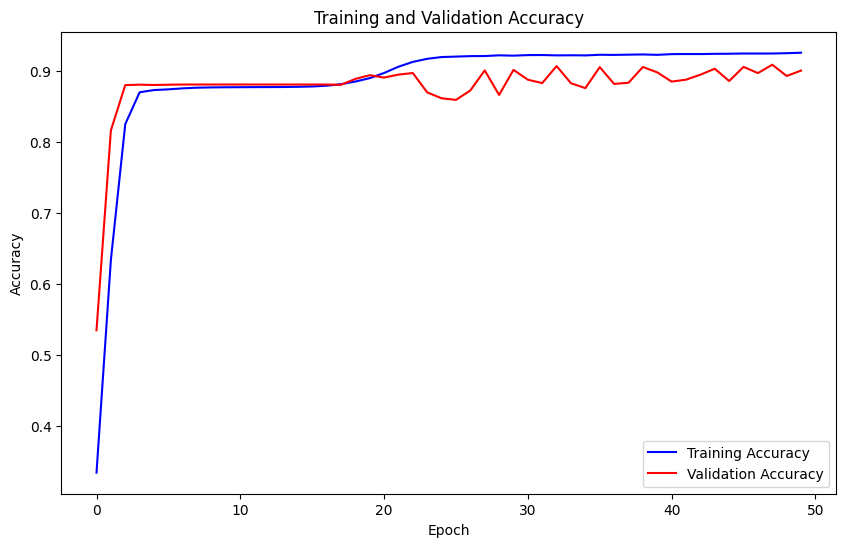

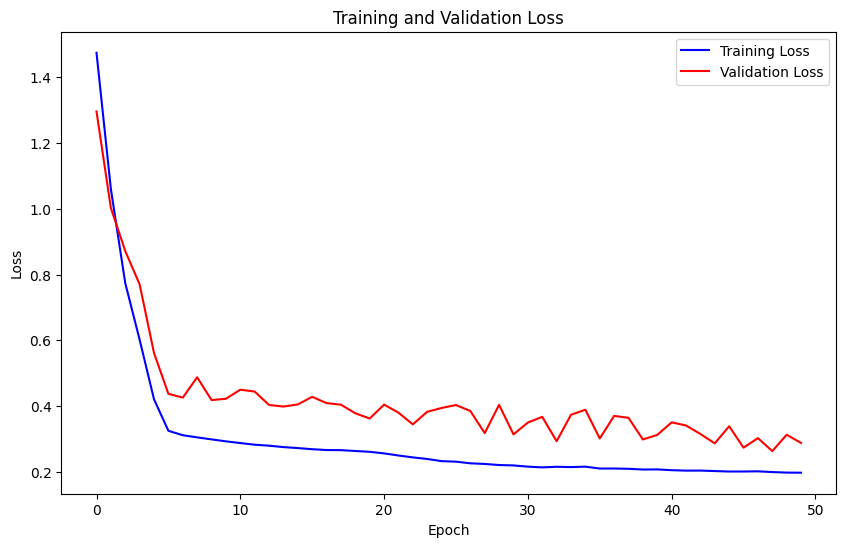

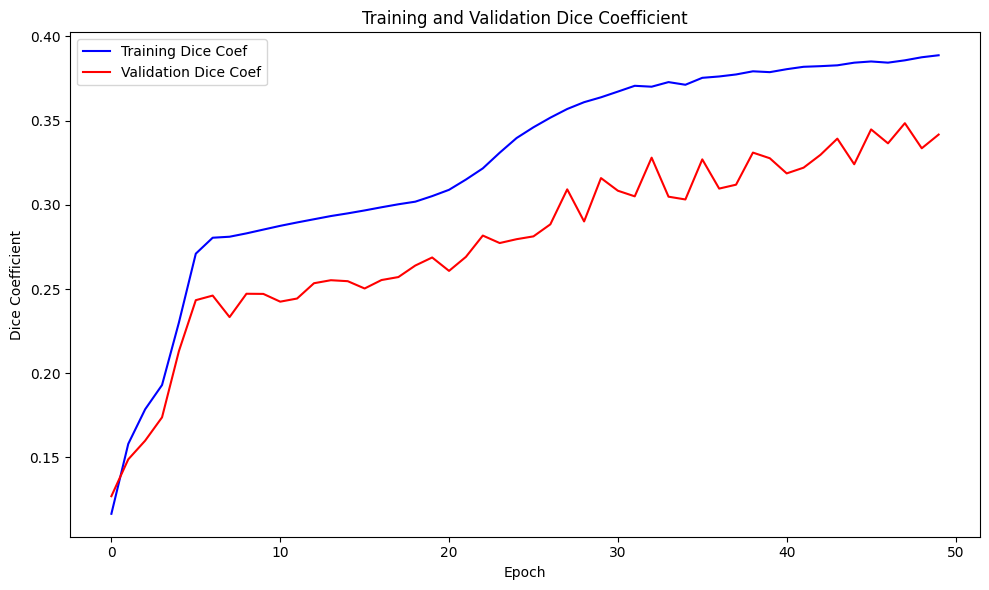

In [ ]:
history = pd.read_csv('img/Models/modelo1tfg64_0001_.log', sep=',', engine='python')

plt.figure(figsize=(10, 6))

plt.plot(history['epoch'], history['accuracy'], 'b', label='Training Accuracy')
plt.plot(history['epoch'], history['val_accuracy'], 'r', label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['loss'], 'b', label='Training Loss')
plt.plot(history['epoch'], history['val_loss'], 'r', label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['dice_coef'], 'b', label='Training Dice Coef')
plt.plot(history['epoch'], history['val_dice_coef'], 'r', label='Validation Dice Coef')
plt.xlabel('Epoch')
plt.ylabel('Dice Coefficient')
plt.legend()
plt.title('Training and Validation Dice Coefficient')

plt.tight_layout()

plt.show()

In [ ]:
weight_path = 'img/Models/modelo1tfg64_0001_.hdf5'

model.load_weights(weight_path)

y_pred=model.predict(X_test) #contiene las probabilidades
y_pred_argmax=np.argmax(y_pred, axis=3) #se pasa la probabilidad a binario

5/5 [==============================] - 9s 2s/step


In [ ]:
conf_matrix = confusion_matrix(y_test.flatten(), y_pred_argmax.flatten())
class_IoU = np.diag(conf_matrix) / (conf_matrix.sum(axis=1) + conf_matrix.sum(axis=0) - np.diag(conf_matrix))
mean_IoU = np.mean(class_IoU)

print("Mean IoU =", mean_IoU)
print("IoU for class1 (background) is:", class_IoU[0])
print("IoU for class2 (interior) is:", class_IoU[1])
print("IoU for class3 (miocardio) is:", class_IoU[2])
print("IoU for class4 (infarto) is:", class_IoU[3])
print("IoU for class5 (PMO) is:", class_IoU[4])

Mean IoU = 0.29827464347143434
IoU for class1 (background) is: 0.9435421165936793
IoU for class2 (interior) is: 0.46411979337111536
IoU for class3 (miocardio) is: 0.08371130739237687
IoU for class4 (infarto) is: 0.0
IoU for class5 (PMO) is: 0.0


In [ ]:
y_pred_argmax_flat = y_pred_argmax.reshape(-1)
y_test_cat_flat = y_test_cat.reshape(-1, 5)


y_true_labels = np.argmax(y_test_cat_flat, axis=1)


accuracy = accuracy_score(y_true_labels, y_pred_argmax_flat)


precision = precision_score(y_true_labels, y_pred_argmax_flat, average=None)
recall = recall_score(y_true_labels, y_pred_argmax_flat, average=None)
f1 = f1_score(y_true_labels, y_pred_argmax_flat, average=None)


class_accuracies = []


for i in range(5):

    class_indices = np.where(y_true_labels == i)[0]

    class_predictions = y_pred_argmax_flat[class_indices]
    class_true_labels = y_true_labels[class_indices]

    class_accuracy = accuracy_score(class_true_labels, class_predictions)
    class_accuracies.append(class_accuracy)

class_iou = []
class_dice = []
class_jaccard = []
for i in range(5):
    class_mask_pred = (y_pred_argmax_flat == i)
    class_mask_true = (y_true_labels == i)

    intersection = np.sum(class_mask_pred & class_mask_true)
    union = np.sum(class_mask_pred | class_mask_true)

    iou = intersection / union if union != 0 else 0
    dice = 2 * intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true)) if (np.sum(class_mask_pred) + np.sum(class_mask_true)) != 0 else 0
    jaccard = intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) if (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) != 0 else 0
    class_iou.append(iou)
    class_dice.append(dice)
    class_jaccard.append(jaccard)

conf_matrix = confusion_matrix(y_true_labels, y_pred_argmax_flat)

conf_matrix_normalized = conf_matrix.astype('float') / conf_matrix.sum(axis=1)[:, np.newaxis]

print("Matriz de Confusión:")
print(conf_matrix)

print("\nMatriz de Confusión Normalizada:")
print(conf_matrix_normalized)

table_header = ["Clase", "Accuracy", "Precision", "Recall", "F1 Score", "IoU", "DICE", "Jaccard"]
table_data = []
for i in range(5):
    row = [f"Clase {i}", round(class_accuracies[i], 4), round(precision[i], 4), round(recall[i], 4), round(f1[i], 4), round(class_iou[i], 4), round(class_dice[i], 4), round(class_jaccard[i], 4)]
    table_data.append(row)

print("\nResultados por Clase:")
print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*table_header))
for row in table_data:
    print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*row))

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Matriz de Confusión:
[[2203703   56673   30479       0       0]
 [   1711  151750    1339       0       0]
 [  40270   99120   15780       0       0]
 [   2644   14968    1398       0       0]
 [     84    1402     119       0       0]]

Matriz de Confusión Normalizada:
[[0.96195656 0.0247388  0.01330464 0.         0.        ]
 [0.01105297 0.98029716 0.00864987 0.         0.        ]
 [0.25952181 0.63878327 0.10169492 0.         0.        ]
 [0.13908469 0.78737507 0.07354024 0.         0.        ]
 [0.05233645 0.87352025 0.0741433  0.         0.        ]]

Resultados por Clase:
Clase      Accuracy   Precision  Recall     F1 Score   IoU        DICE       Jaccard   
Clase 0    0.962      0.9801     0.962      0.971      0.9435     0.971      0.9435    
Clase 1    0.9803     0.4685     0.9803     0.634      0.4641     0.634      0.4641    
Clase 2    0.1017     0.3213     0.1017     0.1545     0.0837     0.1545     0.0837    
Clase 3    0.0        0.0        0.0        0.0        0.0     

### Predicción de las imágenes

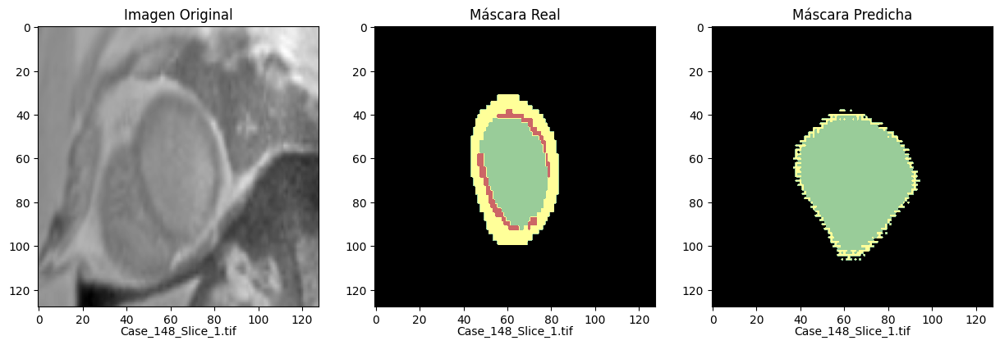

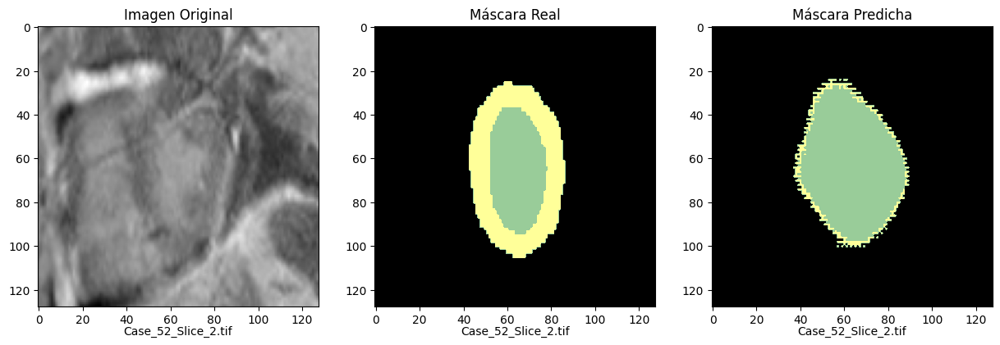

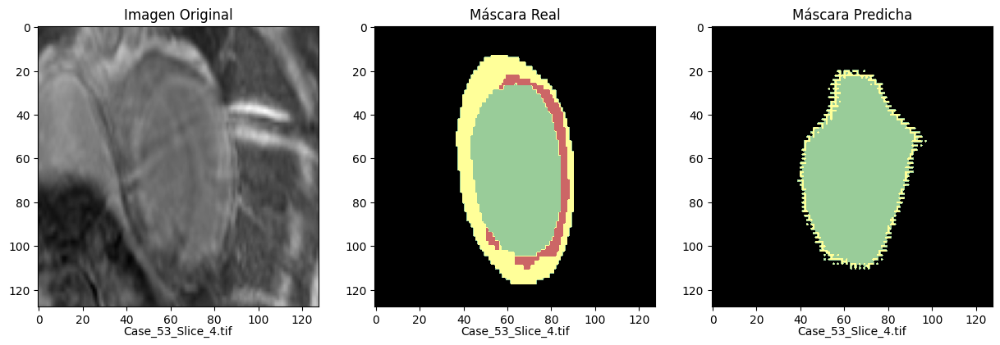

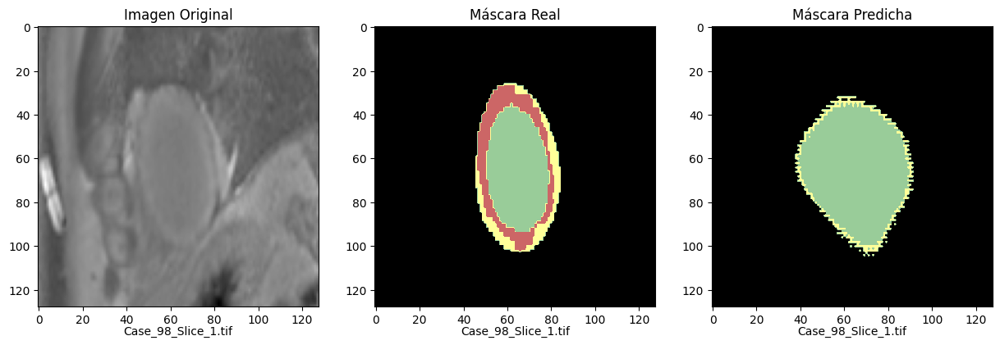

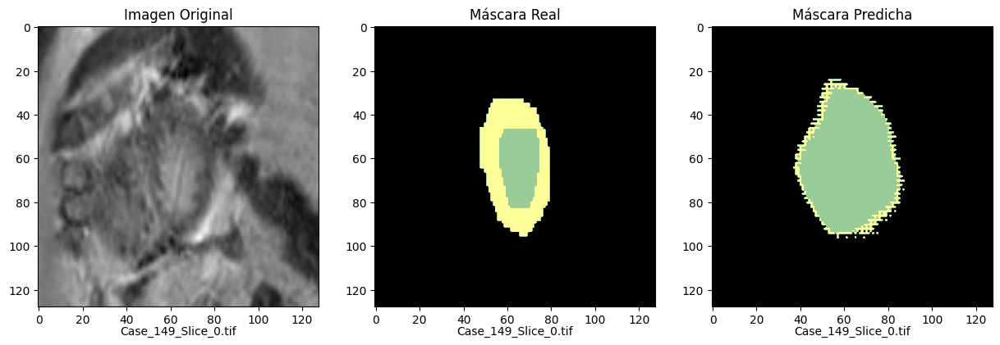

...

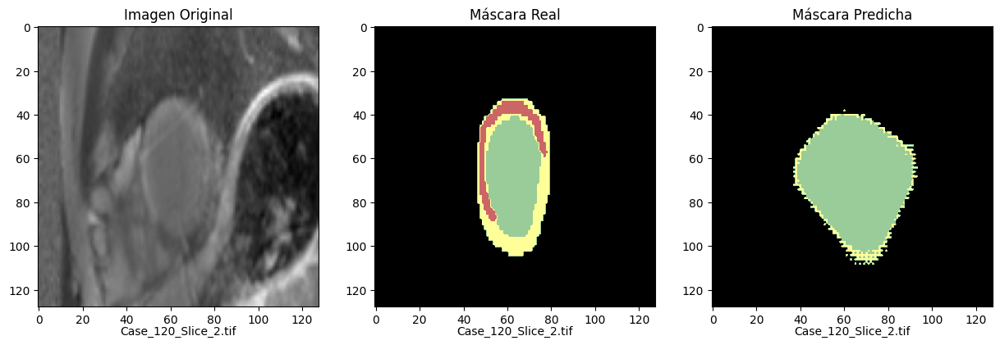

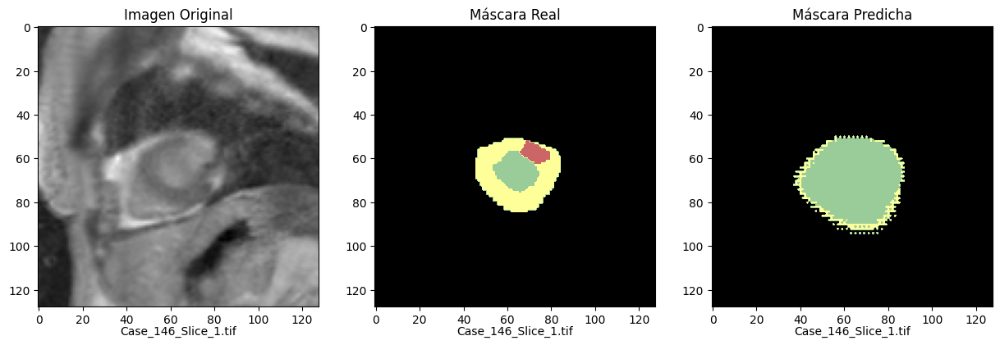

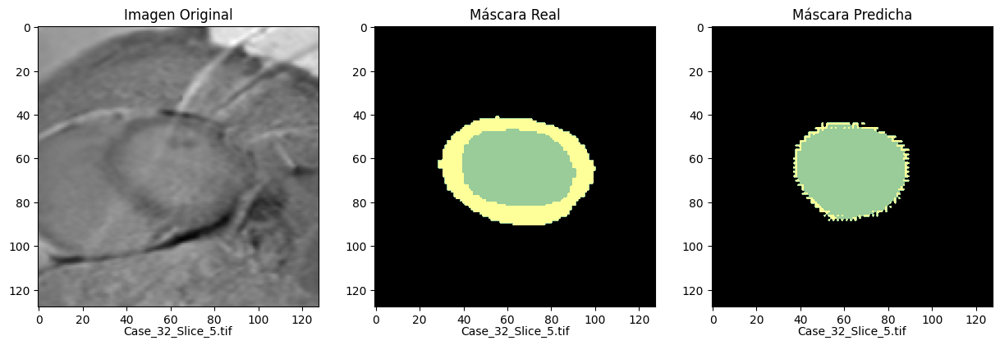

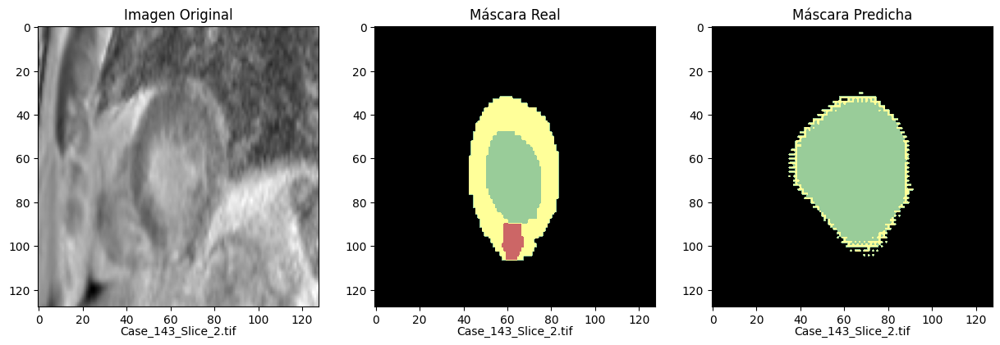

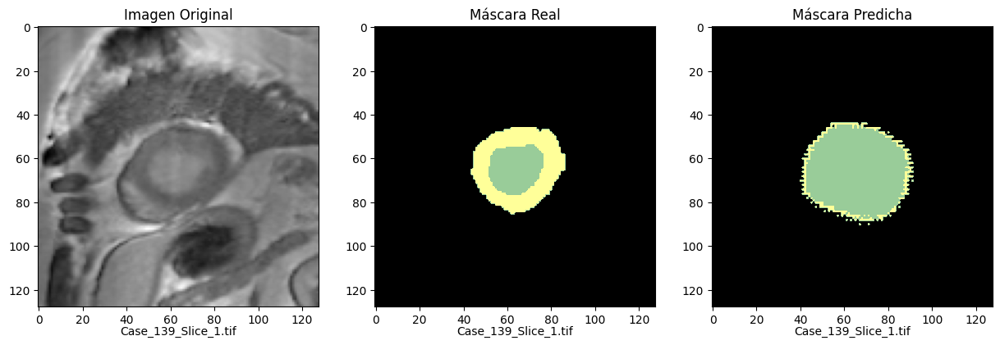

In [ ]:
def mostrar_imagen_y_mascaras(index):
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    etiqueta_colores = {
        0: (0, 0, 0, 1),          # Etiqueta 0: Negro (background)
        1: (0.6, 0.8, 0.6, 1),    # Etiqueta 1: Verde claro (ventrículo izquierdo)
        2: (1, 1, 0.6, 1),        # Etiqueta 2: Amarillo pálido (miocardio sano)
        3: (0.8, 0.4, 0.4, 1),    # Etiqueta 3: Rojo suave (miocardio patológico)
        4: 'lightblue'            # Etiqueta 4: Azul claro (PMO)
    }

    etiqueta_rgbas = [mcolors.to_rgba(etiqueta_colores[i]) for i in range(len(etiqueta_colores))]

    etiqueta_cmap = mcolors.ListedColormap(etiqueta_rgbas, N=len(etiqueta_colores))

    ax[0].imshow(X_test[index].squeeze(), cmap='gray')
    ax[0].set_title('Imagen Original')
    ax[0].text(0.5, -0.1, test_image_names[index], size=10, ha="center", transform=ax[0].transAxes)

    ax[1].imshow(y_test[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[1].set_title('Máscara Real')
    ax[1].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[1].transAxes)

    ax[2].imshow(y_pred_argmax[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[2].set_title('Máscara Predicha')
    ax[2].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[2].transAxes)

    plt.show()

for i in range(1, 159):
    mostrar_imagen_y_mascaras(i)

## Entrenamiento del modelo 2, aumento del contraste 1.5.

957 imágenes de train, 160 val y 160 test. PMO contrast 1.5

In [ ]:
def get_model():
    return multi_unet_model(n_classes=n_classes, img_alt=img_alt, img_anch=img_anch, canales=canales)

model = get_model()
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics = ['accuracy', dice_coef, precision, sensitivity, specificity],run_eagerly=True)
model.summary()

callbacks = [
    keras.callbacks.ModelCheckpoint(filepath = 'img/Models/modelo2tfg.{epoch:02d}-{val_loss:.6f}.m5',
                             verbose=1, save_best_only=True, save_weights_only = True),
    CSVLogger('img/Models/modelo2tfg.log', separator=',', append=False)
]

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 128, 128, 1)]        0         []                            
                                                                                                  
 conv2d_19 (Conv2D)          (None, 128, 128, 16)         160       ['input_2[0][0]']             
                                                                                                  
 dropout_9 (Dropout)         (None, 128, 128, 16)         0         ['conv2d_19[0][0]']           
                                                                                                  
 conv2d_20 (Conv2D)          (None, 128, 128, 16)         2320      ['dropout_9[0][0]']           
                                                                                            

In [ ]:
history= model.fit(X_train_aug,y_train_cat_aug,
          batch_size = 16,
          epochs=50,
          callbacks=callbacks,
          validation_data=(X_val, y_val_cat))

save_directory = 'img/Models'
if not os.path.exists(save_directory):
    os.makedirs(save_directory)

model.save(os.path.join(save_directory, 'modelo2tfg.hdf5'))

Epoch 1/50
60/60 [==============================] - ETA: 0s - loss: 0.6746 - accuracy: 0.8759 - dice_coef: 0.1998 - precision: 0.8646 - sensitivity: 0.7285 - specificity: 0.9751
Epoch 1: val_loss improved from inf to 0.33236, saving model to img/Models/modelo2tfg.01-0.332361.m5
60/60 [==============================] - 294s 5s/step - loss: 0.6746 - accuracy: 0.8759 - dice_coef: 0.1998 - precision: 0.8646 - sensitivity: 0.7285 - specificity: 0.9751 - val_loss: 0.3324 - val_accuracy: 0.8804 - val_dice_coef: 0.2524 - val_precision: 0.8881 - val_sensitivity: 0.8788 - val_specificity: 0.9723
Epoch 2/50
60/60 [==============================] - ETA: 0s - loss: 0.2655 - accuracy: 0.9051 - dice_coef: 0.3263 - precision: 0.9484 - sensitivity: 0.8733 - specificity: 0.9880
Epoch 2: val_loss improved from 0.33236 to 0.22996, saving model to img/Models/modelo2tfg.02-0.229963.m5
60/60 [==============================] - 191s 3s/step - loss: 0.2655 - accuracy: 0.9051 - dice_coef: 0.3263 - precision: 0.9

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


### Evaluación del modelo

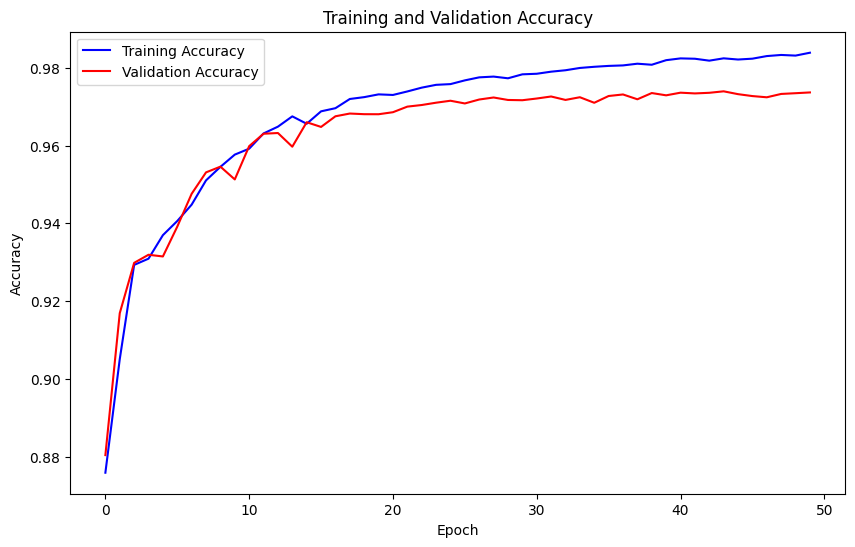

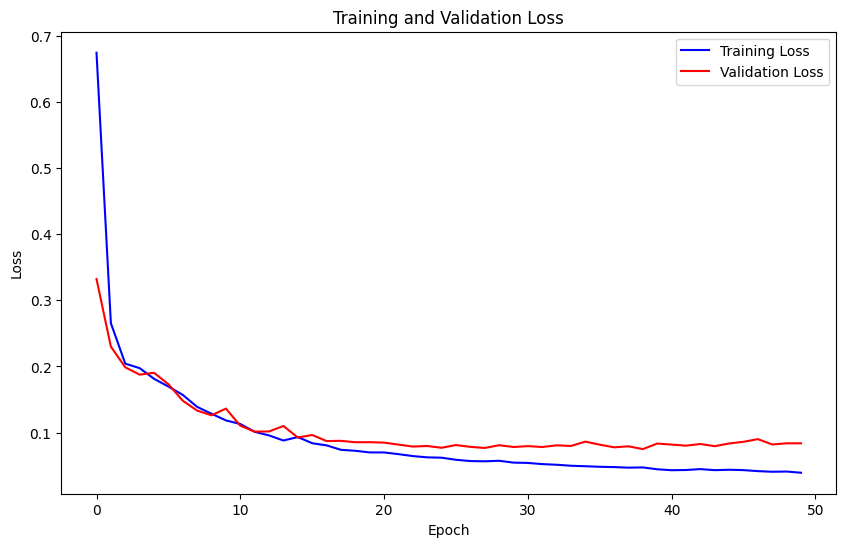

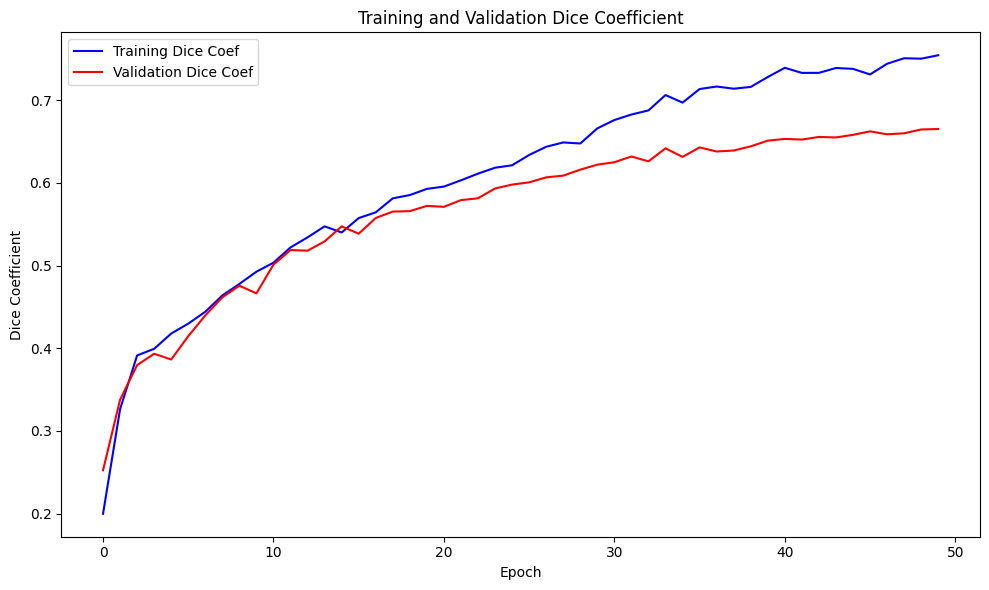

In [ ]:
history = pd.read_csv('img/Models/modelo2tfg.log', sep=',', engine='python')

plt.figure(figsize=(10, 6))

plt.plot(history['epoch'], history['accuracy'], 'b', label='Training Accuracy')
plt.plot(history['epoch'], history['val_accuracy'], 'r', label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training and Validation Accuracy')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['loss'], 'b', label='Training Loss')
plt.plot(history['epoch'], history['val_loss'], 'r', label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.title('Training and Validation Loss')

plt.figure(figsize=(10, 6))
plt.plot(history['epoch'], history['dice_coef'], 'b', label='Training Dice Coef')
plt.plot(history['epoch'], history['val_dice_coef'], 'r', label='Validation Dice Coef')
plt.xlabel('Epoch')
plt.ylabel('Dice Coefficient')
plt.legend()
plt.title('Training and Validation Dice Coefficient')

plt.tight_layout()

plt.show()

In [ ]:
weight_path = 'img/Models/modelo2tfg.hdf5'

model.load_weights(weight_path)

y_pred=model.predict(X_test) #contiene las probabilidades
y_pred_argmax=np.argmax(y_pred, axis=3) #se pasa la probabilidad a binar

5/5 [==============================] - 15s 3s/step


In [ ]:
conf_matrix = confusion_matrix(y_test.flatten(), y_pred_argmax.flatten())
class_IoU = np.diag(conf_matrix) / (conf_matrix.sum(axis=1) + conf_matrix.sum(axis=0) - np.diag(conf_matrix))
mean_IoU = np.mean(class_IoU)

print("Mean IoU =", mean_IoU)
print("IoU for class1 (background) is:", class_IoU[0])
print("IoU for class2 (interior) is:", class_IoU[1])
print("IoU for class3 (miocardio) is:", class_IoU[2])
print("IoU for class4 (infarto) is:", class_IoU[3])
print("IoU for class5 (PMO) is:", class_IoU[4])

Mean IoU = 0.6491193652539495
IoU for class1 (background) is: 0.9847805753855774
IoU for class2 (interior) is: 0.8655547326322026
IoU for class3 (miocardio) is: 0.6784663412228245
IoU for class4 (infarto) is: 0.36669457340741307
IoU for class5 (PMO) is: 0.3501006036217304


In [ ]:
y_pred_argmax_flat = y_pred_argmax.reshape(-1)
y_test_cat_flat = y_test_cat.reshape(-1, 5)
y_true_labels = np.argmax(y_test_cat_flat, axis=1)
accuracy = accuracy_score(y_true_labels, y_pred_argmax_flat)
precision = precision_score(y_true_labels, y_pred_argmax_flat, average=None)
recall = recall_score(y_true_labels, y_pred_argmax_flat, average=None)
f1 = f1_score(y_true_labels, y_pred_argmax_flat, average=None)
class_accuracies = []
for i in range(5):
    class_indices = np.where(y_true_labels == i)[0]
    class_predictions = y_pred_argmax_flat[class_indices]
    class_true_labels = y_true_labels[class_indices]
    class_accuracy = accuracy_score(class_true_labels, class_predictions)
    class_accuracies.append(class_accuracy)

class_iou = []
class_dice = []
class_jaccard = []
for i in range(5):

    class_mask_pred = (y_pred_argmax_flat == i)
    class_mask_true = (y_true_labels == i)

    intersection = np.sum(class_mask_pred & class_mask_true)
    union = np.sum(class_mask_pred | class_mask_true)

    iou = intersection / union if union != 0 else 0
    dice = 2 * intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true)) if (np.sum(class_mask_pred) + np.sum(class_mask_true)) != 0 else 0
    jaccard = intersection / (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) if (np.sum(class_mask_pred) + np.sum(class_mask_true) - intersection) != 0 else 0
    class_iou.append(iou)
    class_dice.append(dice)
    class_jaccard.append(jaccard)


conf_matrix = confusion_matrix(y_true_labels, y_pred_argmax_flat)


conf_matrix_normalized = conf_matrix.astype('float') / conf_matrix.sum(axis=1)[:, np.newaxis]

print("Matriz de Confusión:")
print(conf_matrix)

print("\nMatriz de Confusión Normalizada:")
print(conf_matrix_normalized)

table_header = ["Clase", "Accuracy", "Precision", "Recall", "F1 Score", "IoU", "DICE", "Jaccard"]
table_data = []
for i in range(5):
    row = [f"Clase {i}", round(class_accuracies[i], 4), round(precision[i], 4), round(recall[i], 4), round(f1[i], 4), round(class_iou[i], 4), round(class_dice[i], 4), round(class_jaccard[i], 4)]
    table_data.append(row)

print("\nResultados por Clase:")
print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*table_header))
for row in table_data:
    print("{:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10} {:<10}".format(*row))

Matriz de Confusión:
[[2277375     181   12139    1139      21]
 [    162  146084    6280    2194      80]
 [  19870   10530  121054    3557     159]
 [   1666    3086    4499    9636     123]
 [     18     178     335     378     696]]

Matriz de Confusión Normalizada:
[[9.94115734e-01 7.90098020e-05 5.29889495e-03 4.97194279e-04
  9.16688311e-06]
 [1.04651163e-03 9.43695090e-01 4.05684755e-02 1.41731266e-02
  5.16795866e-04]
 [1.28053103e-01 6.78610556e-02 7.80137913e-01 2.29232455e-02
  1.02468261e-03]
 [8.76380852e-02 1.62335613e-01 2.36664913e-01 5.06891110e-01
  6.47027880e-03]
 [1.12149533e-02 1.10903427e-01 2.08722741e-01 2.35514019e-01
  4.33644860e-01]]

Resultados por Clase:
Clase      Accuracy   Precision  Recall     F1 Score   IoU        DICE       Jaccard   
Clase 0    0.9941     0.9906     0.9941     0.9923     0.9848     0.9923     0.9848    
Clase 1    0.9437     0.9127     0.9437     0.9279     0.8656     0.9279     0.8656    
Clase 2    0.7801     0.8389     0.7801  

### Predicción de las imágenes

In [ ]:
import matplotlib.colors as mcolors

def mostrar_imagen_y_mascaras(index):
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    etiqueta_colores = {
        0: (0, 0, 0, 1),          # Etiqueta 0: Negro (background)
        1: (0.6, 0.8, 0.6, 1),    # Etiqueta 1: Verde claro (ventrículo izquierdo)
        2: (1, 1, 0.6, 1),        # Etiqueta 2: Amarillo pálido (miocardio sano)
        3: (0.8, 0.4, 0.4, 1),    # Etiqueta 3: Rojo suave (miocardio patológico)
        4: 'lightblue'       # Etiqueta 4: Azul claro (PMO)
    }

    etiqueta_rgbas = [mcolors.to_rgba(etiqueta_colores[i]) for i in range(len(etiqueta_colores))]

    etiqueta_cmap = mcolors.ListedColormap(etiqueta_rgbas, N=len(etiqueta_colores))

    ax[0].imshow(X_test[index].squeeze(), cmap='gray')
    ax[0].set_title('Imagen Original')
    ax[0].text(0.5, -0.1, test_image_names[index], size=10, ha="center", transform=ax[0].transAxes)

    ax[1].imshow(y_test[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[1].set_title('Máscara Real')
    ax[1].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[1].transAxes)

    ax[2].imshow(y_pred_argmax[index].squeeze(), cmap=etiqueta_cmap, vmin=0, vmax=len(etiqueta_colores)-1)
    ax[2].set_title('Máscara Predicha')
    ax[2].text(0.5, -0.1, test_mask_names[index], size=10, ha="center", transform=ax[2].transAxes)

    plt.show()

for i in range(1, 159):
    mostrar_imagen_y_mascaras(i)



Output hidden; open in https://colab.research.google.com to view.